In [1]:
!nvidia-smi

Sun Jan 19 16:34:21 2025       
+---------------------------------------------------------------------------------------+
| NVIDIA-SMI 535.104.05             Driver Version: 535.104.05   CUDA Version: 12.2     |
|-----------------------------------------+----------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |         Memory-Usage | GPU-Util  Compute M. |
|                                         |                      |               MIG M. |
|=========================================+======================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0              44W / 400W |      2MiB / 40960MiB |      0%      Default |
|                                         |                      |             Disabled |
+-----------------------------------------+----------------------+--

In [2]:
import os, natsort, re
from tqdm import tqdm
import time, random

In [3]:
from itertools import repeat, chain

import numpy as np
import pandas as pd
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import os

from sklearn.metrics import r2_score
from sklearn.metrics import mean_absolute_percentage_error as mape
from sklearn.metrics import mean_squared_error as mse
from sklearn.metrics import mean_squared_log_error as msle

import matplotlib_inline.backend_inline
matplotlib_inline.backend_inline.set_matplotlib_formats("png2x")
# 테마 설정: "default", "classic", "dark_background", "fivethirtyeight", "seaborn"
mpl.style.use("fivethirtyeight")
# 이미지가 레이아웃 안으로 들어오도록 함
mpl.rcParams.update({"figure.constrained_layout.use": True})
mpl.rcParams['axes.unicode_minus'] = False

In [4]:
from google.colab import drive

drive.mount('/content/drive/', force_remount=True)

Mounted at /content/drive/


In [5]:
cd /content/drive/MyDrive/kdt-EST-AI/project/project2/

/content/drive/MyDrive/kdt-EST-AI/project/project2


In [6]:
# 로컬에서

#plt.rc("font", family = "D2Coding")
#plt.rcParams["axes.unicode_minus"] = False

In [7]:
#PRJCT_PATH = '/home/doeun/code/AI/ESTSOFT2024/workspace/2.project_text/aladin_usedbook/'
PRJCT_PATH = '/content/drive/MyDrive/kdt-EST-AI/project/project2/'
save_dir = 'processed/model_input'
dir_path = os.path.join(PRJCT_PATH,save_dir)
#dir_path = './'

In [8]:
import sys
sys.path.append(PRJCT_PATH)

In [9]:
RSLT_DIR = PRJCT_PATH + 'processed/'

bookinfo_name = 'bookinfo_ver{}.pkl'.format(0.75)
bookinfo_path = os.path.join(RSLT_DIR,bookinfo_name)

sys.path.append(PRJCT_PATH)
from module_aladin.file_io import load_pkl, save_pkl
from module_aladin.reg_tool import make_reg_score_dict

from module_aladin.util import read_run_rslt
from module_aladin.plot import plot_area

In [10]:
input_dir = os.path.join(RSLT_DIR,'model_input')
files = list(filter(lambda x : 'scaled-scalar' in x,os.listdir(input_dir)))
files

['scaled-scalar.v1.0_st-0_X_vld.pkl',
 'scaled-scalar.v1.0_st-0_X_trn.pkl',
 'scaled-scalar.v1.0_st-0_y_vld.pkl',
 'scaled-scalar.v1.0_st-0_y_trn.pkl',
 'scaled-scalar.v1.0_st-0_y_tst.pkl',
 'scaled-scalar.v1.0_st-0_X_tst.pkl']

In [11]:
from collections import defaultdict

data_dict=defaultdict(dict)
for f in files:
    data_dict[f[-7:-4]][f[-9]] = load_pkl(os.path.join(input_dir,f))

In [12]:
data_dict.keys()

dict_keys(['vld', 'trn', 'tst'])

In [13]:
cols_tknz = ['Category','BName','BName_sub']
cols_scalar = ['Author','Author_mul','Publshr','Pdate', 'SalesPoint']
maxlens={
    'Category' : 5,
    'BName' : 30,
    'BName_sub' : 25
}
col_idx = [0,5,35,60,61,62,63,64,65]
col_start = [0,5,35,60,65]

In [14]:

import torch

# GPU device setting
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")

torch.set_default_device(device)

In [15]:
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
os.environ["CUDA_VISIBLE_DEVICES"] = '0'
os.environ["TORCH_USE_CUDA_DSA"] = '1'

In [16]:
device

device(type='cuda', index=0)

# train & evaluation module

In [17]:
import locale
locale.getpreferredencoding = lambda: "UTF-8"

!pip install torcheval
!pip install torchmetrics

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.2/179.2 kB 13.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 927.3/927.3 kB 58.0 MB/s eta 0:00:00


In [18]:
from module_aladin.torch_train import trainer_setting, train, evaluate, run, test_n_plot, test_plot_err_dist, get_test_rslt, test_plot_reg_val

cuda:0


# Make model & setting

## Attention based model

In [19]:
import math
import time

from torch import nn, optim
from torch.optim import Adam


In [20]:
from module_aladin.attention_based_model import EncoderWithEmbedding

cuda:0


In [21]:
#col_start = np.array([0,5,35,60,64])
col_start = np.array([0,60,64])
col_len = col_start[1:]- col_start[:-1]
col_len

array([60,  4])

In [22]:
class Model4_5(nn.Module):
  def __init__(self,col_start,d_model,head,d_ff,dropout,n_layers,device):
    super().__init__()
    self.device=device
    self.d_model = d_model #300 # should be common multiplyer of col_len[:-1]
    self.col_start=col_start
    col_len = col_start[1:]- col_start[:-1]
    self.embd_encoder = nn.ModuleList([EncoderWithEmbedding(seq_len,d_model,head,d_ff,seq_len,dropout,n_layers,device)
                          for seq_len in col_len[:-1]])
    d_out= d_model*np.sum(col_len[:-1])+col_len[-1]
    self.fc1 = nn.Linear(d_out,d_out//2)
    self.fc2 = nn.Linear(d_out//2,d_out//2)
    self.fc3 = nn.Linear(d_out//2,1)
    self.relu = nn.ReLU()
    self.dropout = nn.Dropout(dropout)

  def cut_vec(self,src,col_start):
    return [src[:,i:j] for i,j in zip(col_start[:-1],col_start[1:])]

  def forward(self,src): #차원 체크해봐야 함
    vecs = self.cut_vec(src,self.col_start)
    intrmd, masks = [], []
    batch_size,_ = src.size()

    for vec,encoder in zip(vecs[:-1],self.embd_encoder):
      out = encoder(vec.to(torch.int32))
      intrmd.append(out.view(batch_size,-1))

    intrmd.append(vecs[-1])
    output = torch.cat(intrmd,dim=1)

    output = self.dropout(self.relu(self.fc1(output)))
    output = self.dropout(self.relu(self.fc2(output)))
    output = self.fc3(output)

    return output


In [23]:
from math import sqrt

print((len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5) /8.228676261460045e-05 )
print(1/((len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5) /8.228676261460045e-05 ))
print((len(data_dict['trn']['X'])/8192* 60 *6 * 450)**(-0.5) /8.228676261460045e-05 )
print(1/((len(data_dict['trn']['X'])/8192* 60 *6 * 450)**(-0.5) /8.228676261460045e-05 ))

13.446615507153101
0.07436815602171692
8.591622253746467
0.11639245423807355


In [24]:
(len(data_dict['trn']['X'])/(8192*2.5)* 60 *sqrt(6) * 450)**(-0.5)/(13.45)

0.000130074056128077

In [25]:
# model parameter setting
batch_size = 20480

# optimizer parameter setting
factor = 0.92
adam_eps = 5e-7
patience = 10
warmup = 3
epoch = 550
clip = 1.0
weight_decay = 5e-20
drop_prob = 0.1

## make dataloader

In [26]:
from module_aladin.load_data import load_dataloader_iters
from module_aladin.plot import plot_area

cuda:0


In [27]:
iter_dict = load_dataloader_iters(data_dict,batch_size)

In [28]:
class answer_out(nn.Module):
  def __init__(self,iter):
    super().__init__()
    self.input, self.output = zip(*iter)
  def forward(self,src):
    for i,x in enumerate(self.input):
      if x.shape != src.shape: continue
      cond = x.reshape(-1) == src.reshape(-1)
      if torch.sum(cond) == len(cond) : return self.output[i]
    else : return False

answer_trn = answer_out(iter_dict['trn'])
answer_vld = answer_out(iter_dict['vld'])
answer_tst = answer_out(iter_dict['tst'])

In [29]:
d_model = 60 #64
head = 6
d_ff = 128
n_layers= 6

In [30]:
def expt_config(title='test',coeff=1,init='auto',date='250101'):
  if init == 'auto' : init_lr=(len(data_dict['trn']['X'])/8192* 60 *sqrt(6) * 450)**(-0.5)/(13.45)
  else : init_lr = init
  init_lr *= coeff
  model = Model4_5(col_start,d_model,head,d_ff,drop_prob,n_layers,device)
  model, optimizer, scheduler, criterion =trainer_setting(model,init_lr,weight_decay,adam_eps,factor,patience)

  model_name = 'model4.5'
  expt_name = f'{model_name}_{batch_size}_{title}_lr{str(init)}_{coeff}'
  save_dir = os.path.join(RSLT_DIR,'model_test',expt_name)
  if not os.path.exists(save_dir) : os.makedirs(save_dir)
  file_name = 'model_{}_{}.pt'.format(title,date)
  train_config =[optimizer, scheduler, criterion, clip]
  return model, train_config, init_lr,save_dir,file_name

# Expt.2


In [31]:
def best_epoch_test(init,num,title,date,coeff=1,idx=0):
  for i in range(idx,idx+num):
    model, train_config, init_lr,save_dir,file_name = expt_config(title=f'{title}_{i}',coeff=coeff,init=init,date=date)
    model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict['trn'],iter_dict['vld'],epoch,warmup,10100,save_dir,file_name[:-3])
    torch.save(model,os.path.join(save_dir,file_name))
    save_pkl(save_dir,'train_loss.pkl',train_loss)
    save_pkl(save_dir,'valid_loss.pkl',val_loss)
    save_pkl(save_dir,'valid_score.pkl',val_score)

### check rslt

In [32]:
import natsort
from functools import reduce

def check_best_epoch(base_dir,exptname,feat='valid_score',high=True,set_print=False):
  dirs = list(filter(lambda x: exptname in x,os.listdir(base_dir)))
  dirs = natsort.natsorted(dirs)
  files = list(map(lambda x : os.path.join(base_dir,x,f'{feat}.pkl'),dirs))
  scores = {
      dir : load_pkl(file)
      for dir, file in zip(dirs,files)
  }
  rslt = {
      dir : np.argmax(score[:500])+1 if high else np.argmin(score)+1
      for dir,score in scores.items()
  }
  if set_print :
    for dir in dirs :
      print(dir,'\t',rslt[dir])
  return rslt

def get_total_coeff(rslt,unit=450):
  vals = list(map(lambda x : x/unit,rslt))
  return reduce(lambda x,y:x*y,vals,1)

In [33]:
def get_expt1_rslt(base_dir,expt_name,expt_val,unit=450):
  feat = {
      'valid_score' : True,
      'valid_loss' : False
  }
  rslt_lr,rslt_coeff = dict(),dict()
  for key,val in feat.items():
    print(key,'\n','-'*10)
    rslt_best = check_best_epoch(base_dir,expt_name,key,val,True)
    temp = list(rslt_best.values())
    print(temp)
    for i in range(len(temp)):
      print(get_total_coeff(temp[:i+1]))

    if key == 'valid_loss' : rslt_coeff[key] = get_total_coeff(list(rslt_best.values()))
    else :
      last = list(rslt_best.keys())[-1]
      rslt_coeff[key] = float(last.split('_')[-1]) * (rslt_best[last]/unit)
    rslt_lr[key] = rslt_coeff[key] * expt_val
    print('total: ',rslt_lr[key])
    print('-'*30)
  return rslt_lr,rslt_coeff


In [34]:
best_epoch_test(5.27e-4,10,'2.6','250111',1,10)
#best_epoch_test(5.54e-4,11,'2.5','250111',1,6)
#best_epoch_test(4.46e-4,10,'2.4','250111',1,10)
#best_epoch_test(2.84e-4,11,'2.2','250111',1,30)
#best_epoch_test(1.76e-4,5,'2.1','250111',1,20)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:175: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.11/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


스트리밍 출력 내용이 길어서 마지막 5000줄이 삭제되었습니다.
Epoch:   291		lr: 0.00015088
	Train Loss: 6595.846	Train Score: 0.639	Val Loss: 7599.219	Val Score: 0.485
Epoch:   292		lr: 0.00015088
	Train Loss: 6092.632	Train Score: 0.693	Val Loss: 7837.027	Val Score: 0.445
Epoch:   293		lr: 0.00015088
	Train Loss: 5995.477	Train Score: 0.703	Val Loss: 8010.398	Val Score: 0.418
Epoch:   294		lr: 0.00015088
	Train Loss: 6291.096	Train Score: 0.674	Val Loss: 7928.293	Val Score: 0.435
Epoch:   295		lr: 0.00015088
	Train Loss: 6650.267	Train Score: 0.633	Val Loss: 7639.431	Val Score: 0.479
Epoch:   296		lr: 0.00015088
	Train Loss: 6305.777	Train Score: 0.671	Val Loss: 7714.023	Val Score: 0.467
Epoch:   297		lr: 0.00015088
	Train Loss: 6052.615	Train Score: 0.697	Val Loss: 7777.283	Val Score: 0.455
Epoch:   298		lr: 0.00015088
	Train Loss: 6059.420	Train Score: 0.696	Val Loss: 7822.539	Val Score: 0.448
Epoch:   299		lr: 0.00015088
	Train Loss: 6066.273	Train Score: 0.695	Val Loss: 7719.594	Val Score: 0.463
Epoch:   3

KeyboardInterrupt: 

In [ ]:
expt_rslt = get_expt1_rslt(os.path.join(RSLT_DIR,'model_test'),'20480_1.1',5e-4)

valid_score 
 ----------
model4.5_20480_1.1_0_lr0.0005_1 	 190
model4.5_20480_1.1_1_lr0.0005_0.4222222222222222 	 425
model4.5_20480_1.1_2_lr0.0005_0.3987654320987654 	 490
model4.5_20480_1.1_3_lr0.0005_0.45725102880658436 	 369
model4.5_20480_1.1_4_lr0.0005_0.37494584362139916 	 494
model4.5_20480_1.1_5_lr0.0005_0.41160721499771374 	 472
model4.5_20480_1.1_6_lr0.0005_0.431730234397602 	 354
model4.5_20480_1.1_7_lr0.0005_0.33962778439278024 	 482
model4.5_20480_1.1_8_lr0.0005_0.36377909350515575 	 494
model4.5_20480_1.1_9_lr0.0005_0.3993486048701043 	 486
model4.5_20480_1.1_10_lr0.0005_0.46324438164932097 	 441
model4.5_20480_1.1_11_lr0.0005_0.45397949401633453 	 307
model4.5_20480_1.1_12_lr0.0005_0.30971489925114376 	 347
model4.5_20480_1.1_13_lr0.0005_0.2395128554208845 	 441
model4.5_20480_1.1_14_lr0.0005_0.27889941386787437 	 459
model4.5_20480_1.1_15_lr0.0005_0.2844774021452319 	 454
model4.5_20480_1.1_16_lr0.0005_0.33062595849323617 	 377
model4.5_20480_1.1_17_lr0.0005_0.27699108

In [ ]:
#lr_conv_test(1e-4,10,'1.0','250105')
#lr_conv_test(0.5*1e-4,10,'1.2','250104')

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:175: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch:     1		lr: 0.00050000
	Train Loss: 17934.927	Train Score: -1.660	Val Loss: 17374.273	Val Score: -1.766
Epoch:     2		lr: 0.00050000
	Train Loss: 17273.109	Train Score: -1.468	Val Loss: 16140.864	Val Score: -1.379
Epoch:     3		lr: 0.00050000
	Train Loss: 15817.085	Train Score: -1.071	Val Loss: 14105.294	Val Score: -0.804
Epoch:     4		lr: 0.00050000
	Train Loss: 13705.195	Train Score: -0.556	Val Loss: 11769.622	Val Score: -0.239
Epoch:     5		lr: 0.00050000
	Train Loss: 11645.673	Train Score: -0.123	Val Loss: 10636.577	Val Score: -0.003
Epoch:     6		lr: 0.00050000
	Train Loss: 11225.040	Train Score: -0.042	Val Loss: 11696.278	Val Score: -0.225
Epoch:     7		lr: 0.00050000
	Train Loss: 11688.254	Train Score: -0.131	Val Loss: 11073.621	Val Score: -0.092
Epoch:     8		lr: 0.00050000
	Train Loss: 11113.101	Train Score: -0.022	Val Loss: 10657.582	Val Score: -0.007
Epoch:     9		lr: 0.00050000
	Train Loss: 11023.594	Train Score: -0.005	Val Loss: 10766.980	Val Score: -0.029
Epoch:    

KeyboardInterrupt: 

In [ ]:
get_expt1_rslt(os.path.join(RSLT_DIR,'model_test'),'20480_1.0',1e-4)
get_expt1_rslt(os.path.join(RSLT_DIR,'model_test'),'20480_1.1',5e-4)
get_expt1_rslt(os.path.join(RSLT_DIR,'model_test'),'20480_1.2',5e-5)

valid_score ----------
model4.5_20480_1.0_0_lr0.0001_1 	 489
model4.5_20480_1.0_1_lr0.0001_1.1777777777777778 	 487
model4.5_20480_1.0_2_lr0.0001_1.363604938271605 	 453
model4.5_20480_1.0_3_lr0.0001_1.642386392318244 	 481
model4.5_20480_1.0_4_lr0.0001_1.8759702347812832 	 386
model4.5_20480_1.0_5_lr0.0001_1.6091655791679451 	 300
model4.5_20480_1.0_6_lr0.0001_1.2944843103528803 	 431
model4.5_20480_1.0_7_lr0.0001_1.239828306137981 	 431
model4.5_20480_1.0_8_lr0.0001_1.1874799998788217 	 460
model4.5_20480_1.0_9_lr0.0001_1.2640064887599014 	 455
[489, 487, 453, 481, 386, 300, 431, 431, 460, 455]
1.0866666666666667
1.1760148148148148
1.183854913580247
1.265409363182442
1.0854400315298278
0.7236266876865518
0.6930735608731196
0.6638104549695878
0.6785617984133564
0.6861013739512826
total:  0.0001278051005301678
------------------------------
valid_loss ----------
model4.5_20480_1.0_0_lr0.0001_1 	 530
model4.5_20480_1.0_1_lr0.0001_1.1777777777777778 	 521
model4.5_20480_1.0_2_lr0.0001_1.

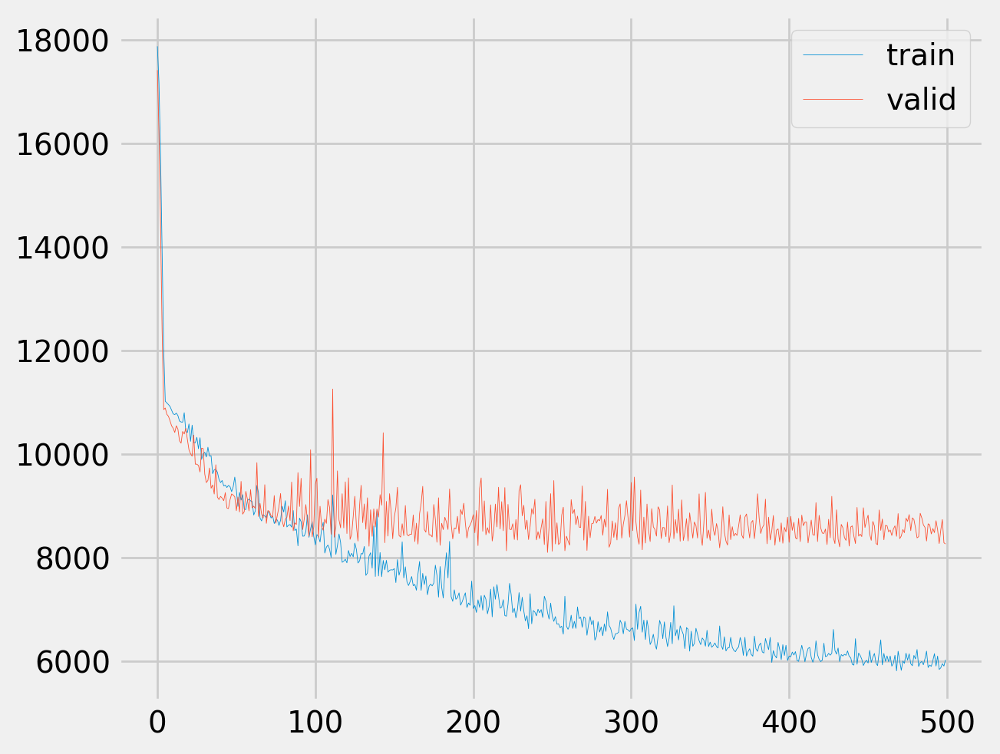

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-66-a000df0fdf5f>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


8211.720891506238 	r2 :  0.44271421432495117 	mape :  0.31375074


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


AttributeError: QuadMesh.set() got an unexpected keyword argument 'gridsize'

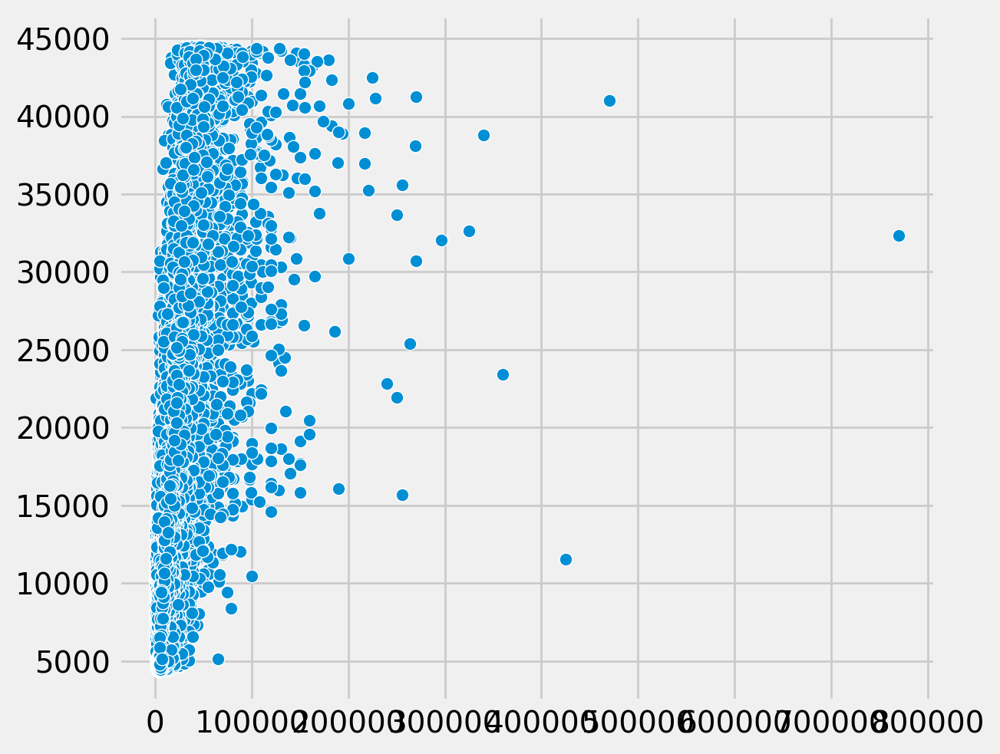

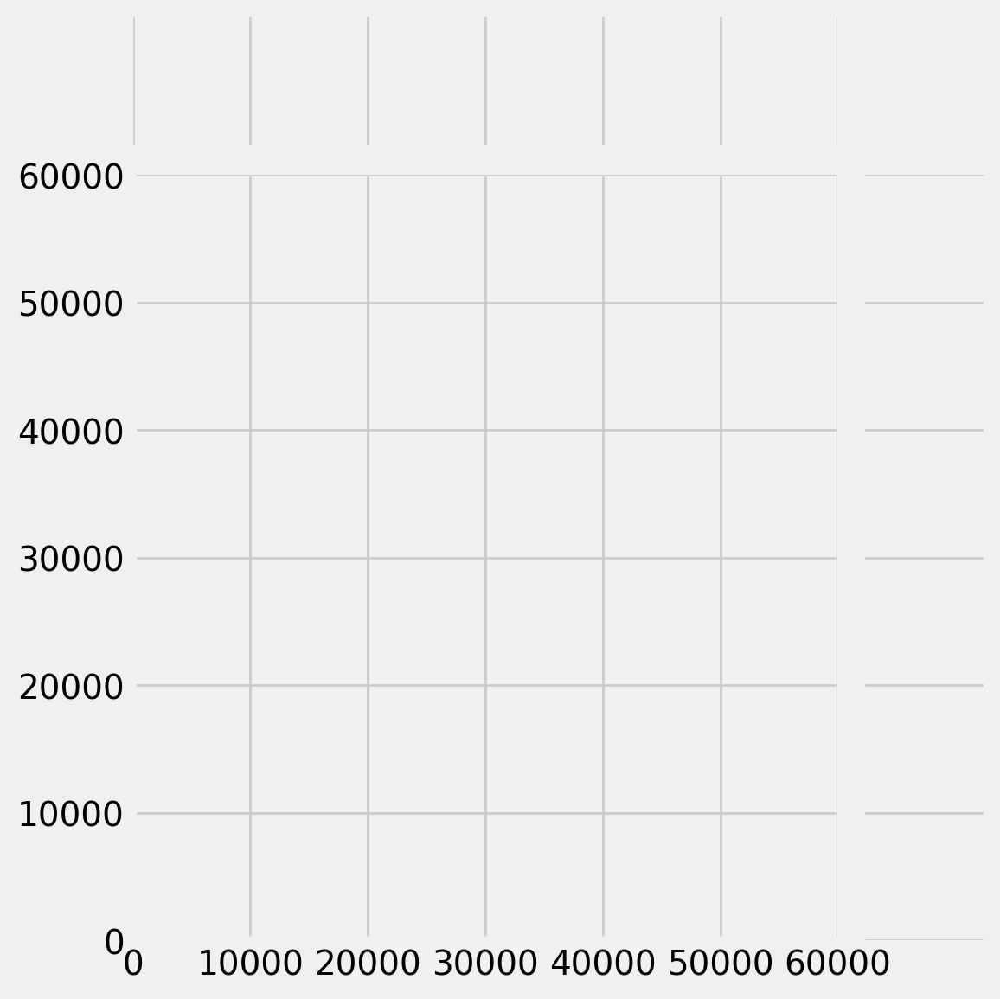

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

7880.290857576261 	r2 :  0.4187297821044922 	mape :  0.33827478


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


AttributeError: QuadMesh.set() got an unexpected keyword argument 'gridsize'

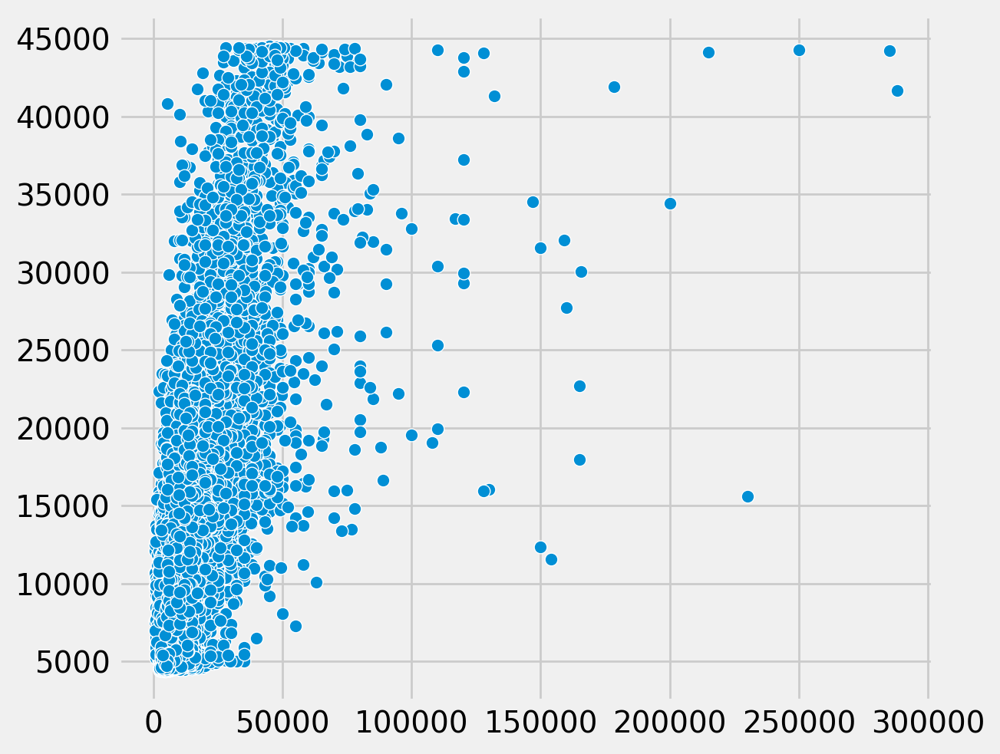

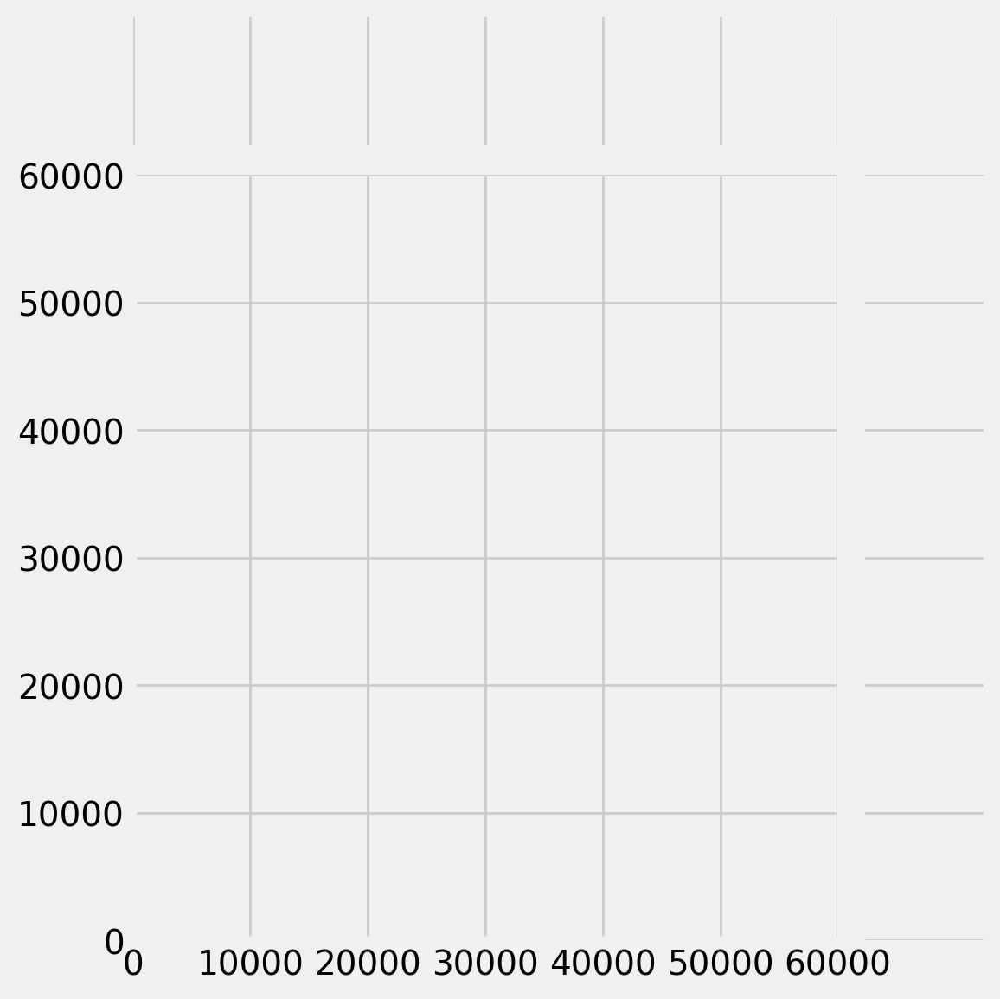

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

9135.527133121548 	r2 :  0.36897462606430054 	mape :  0.33919618


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


9135.527133121548 	r2 :  0.36897462606430054 	mape :  0.33919618


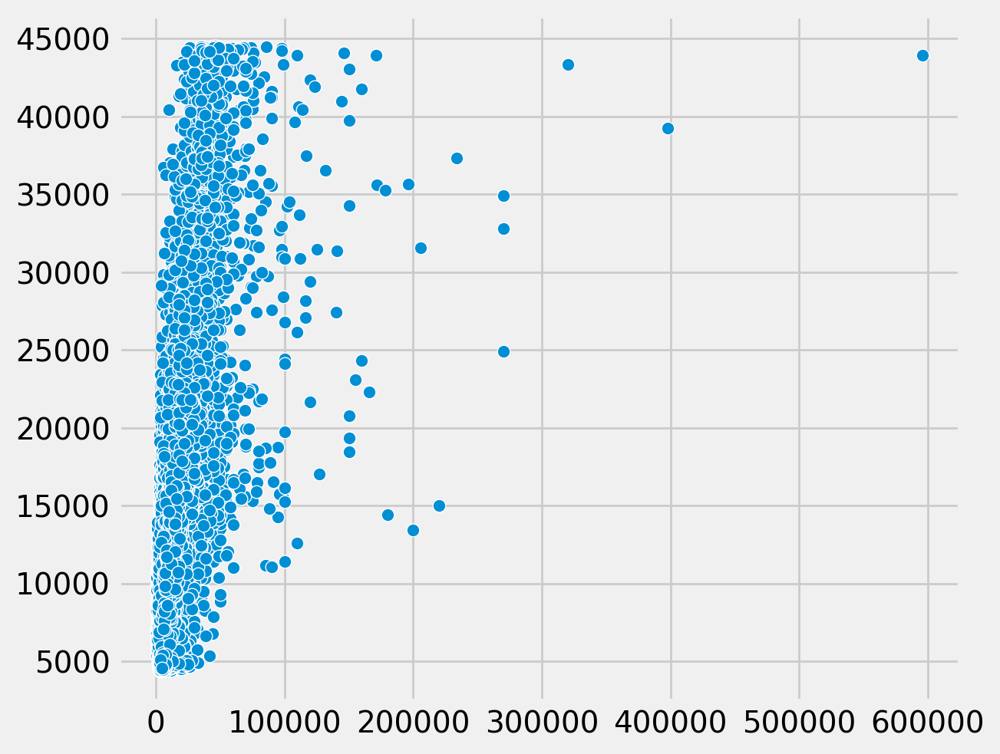

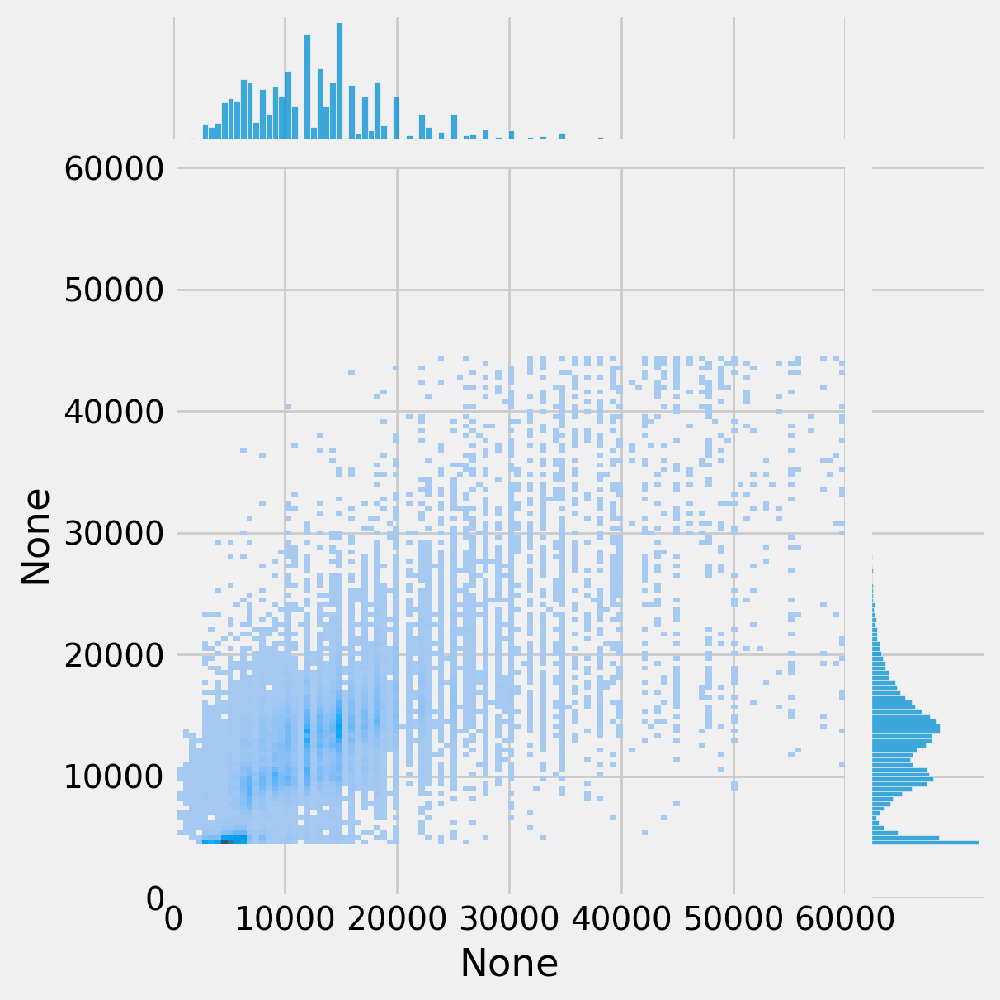

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False)

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


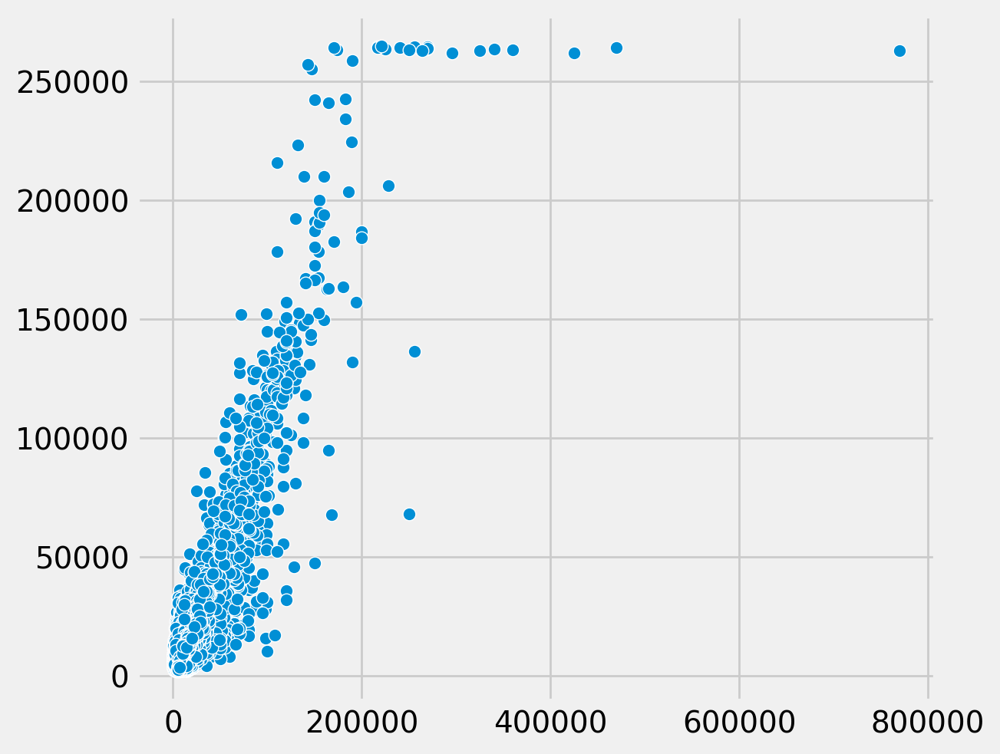

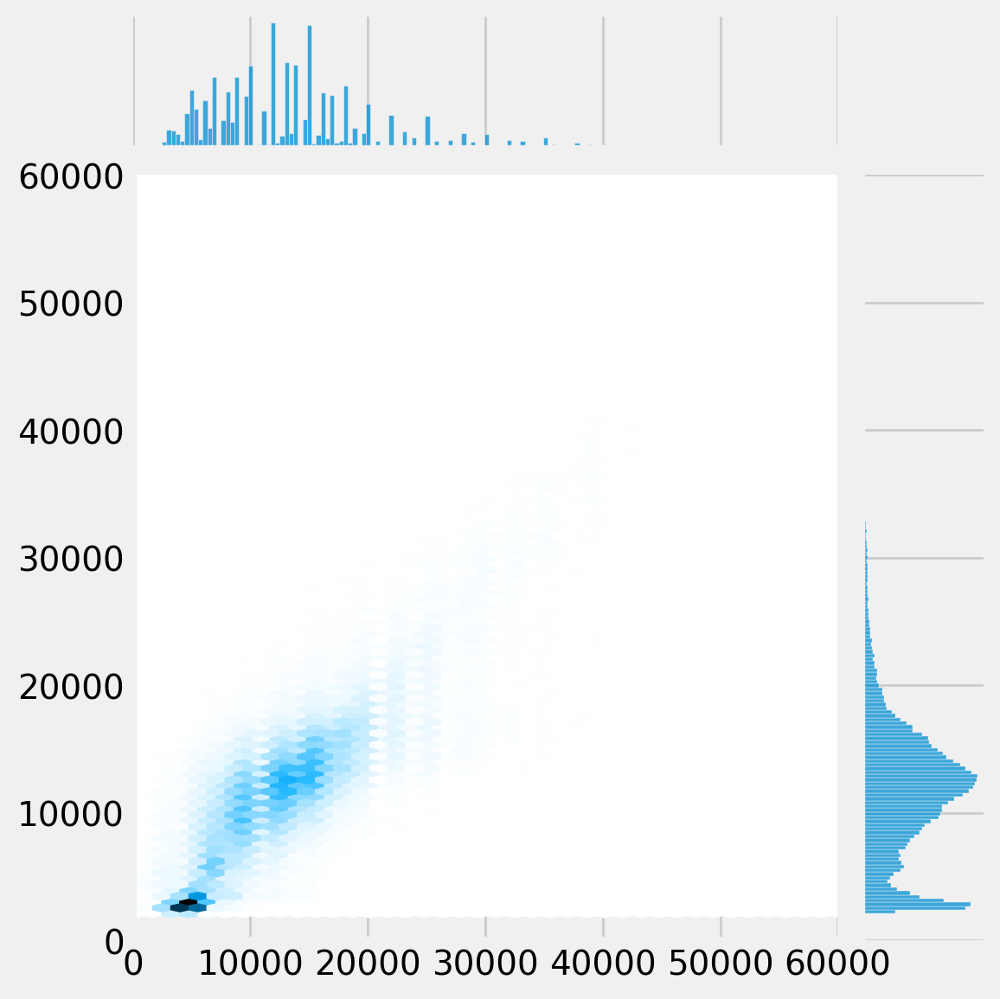

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


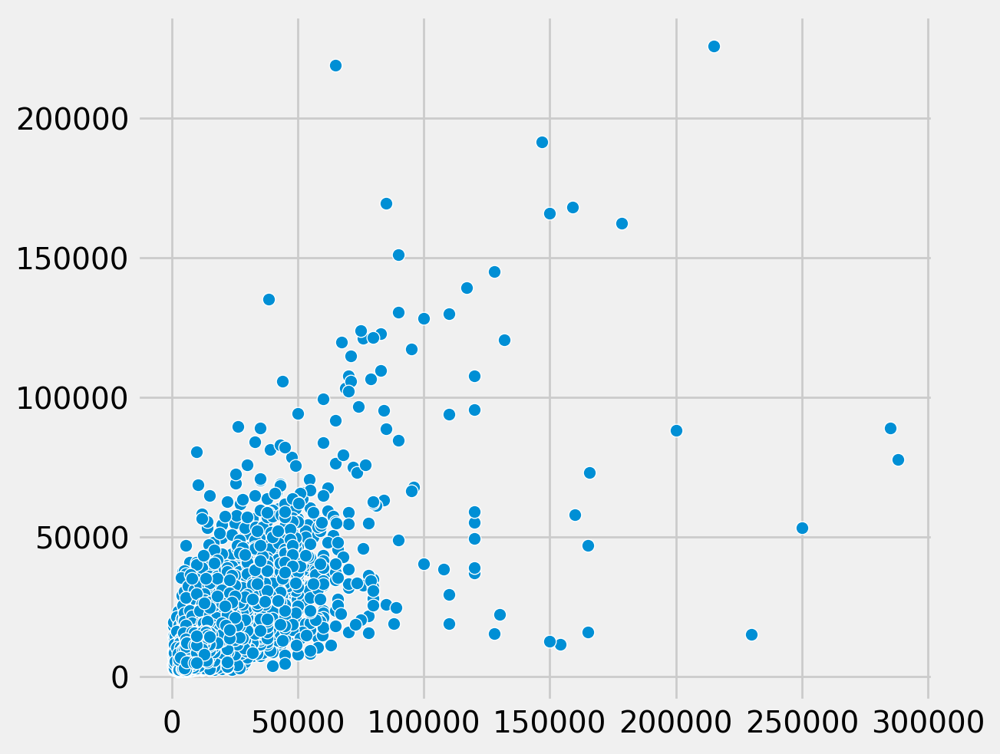

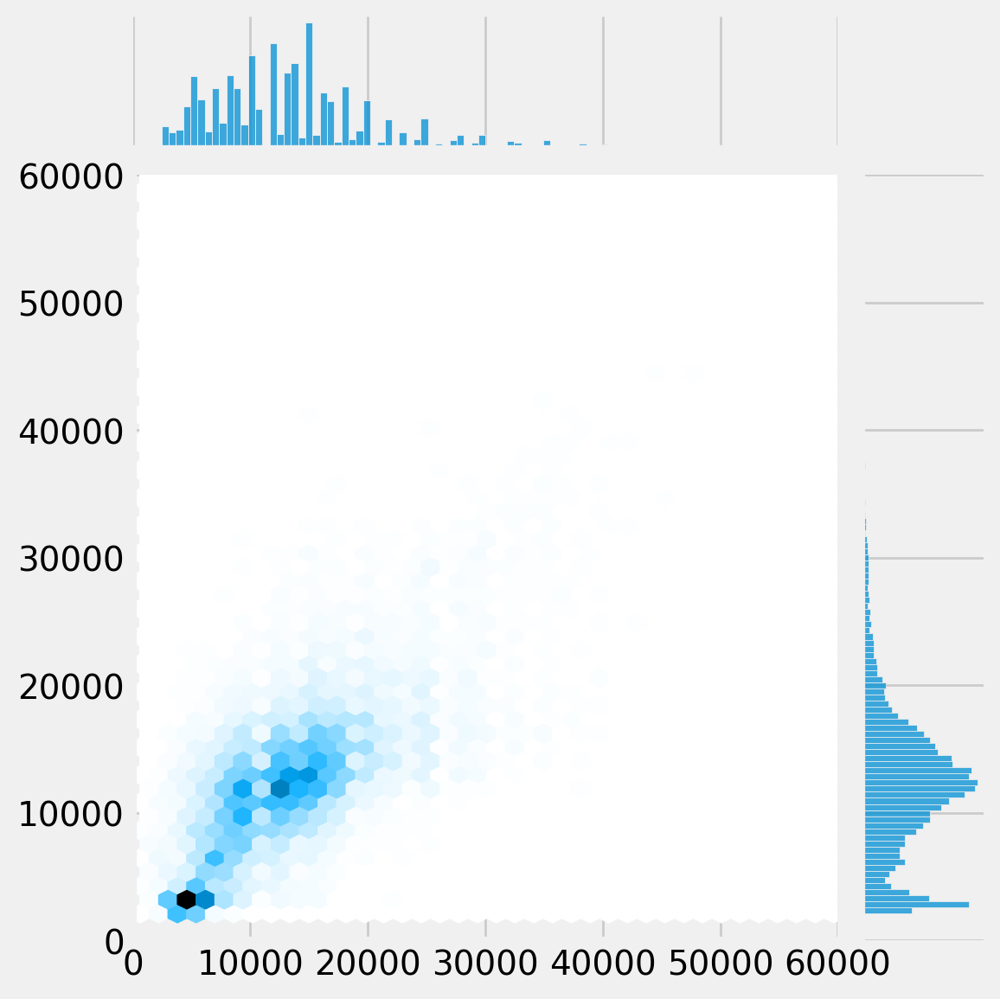

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


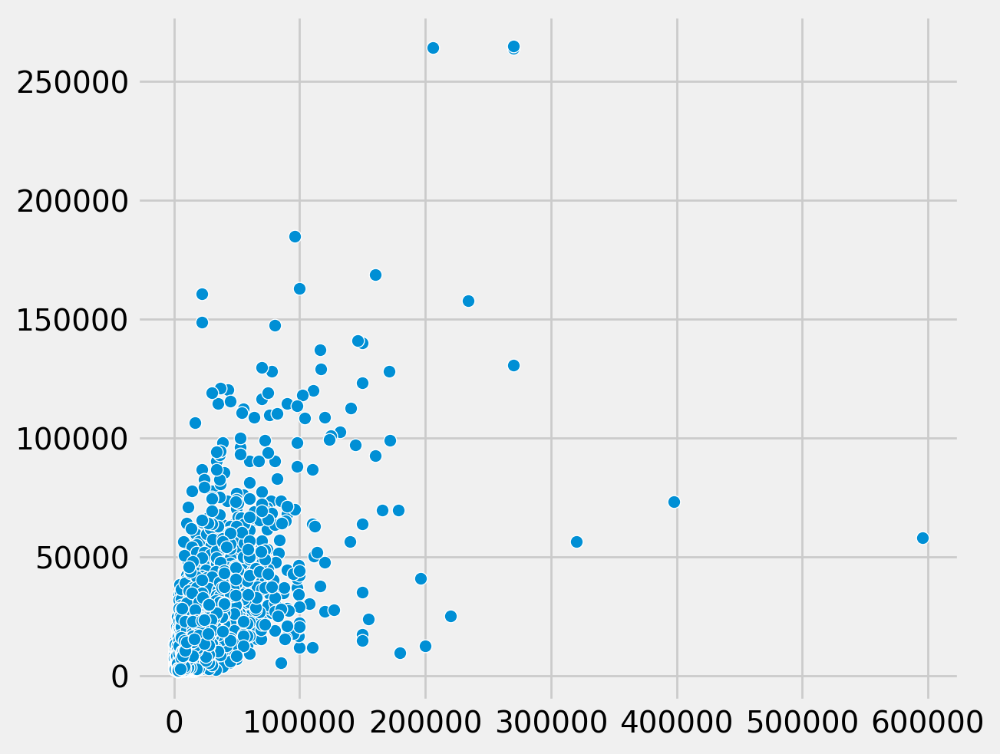

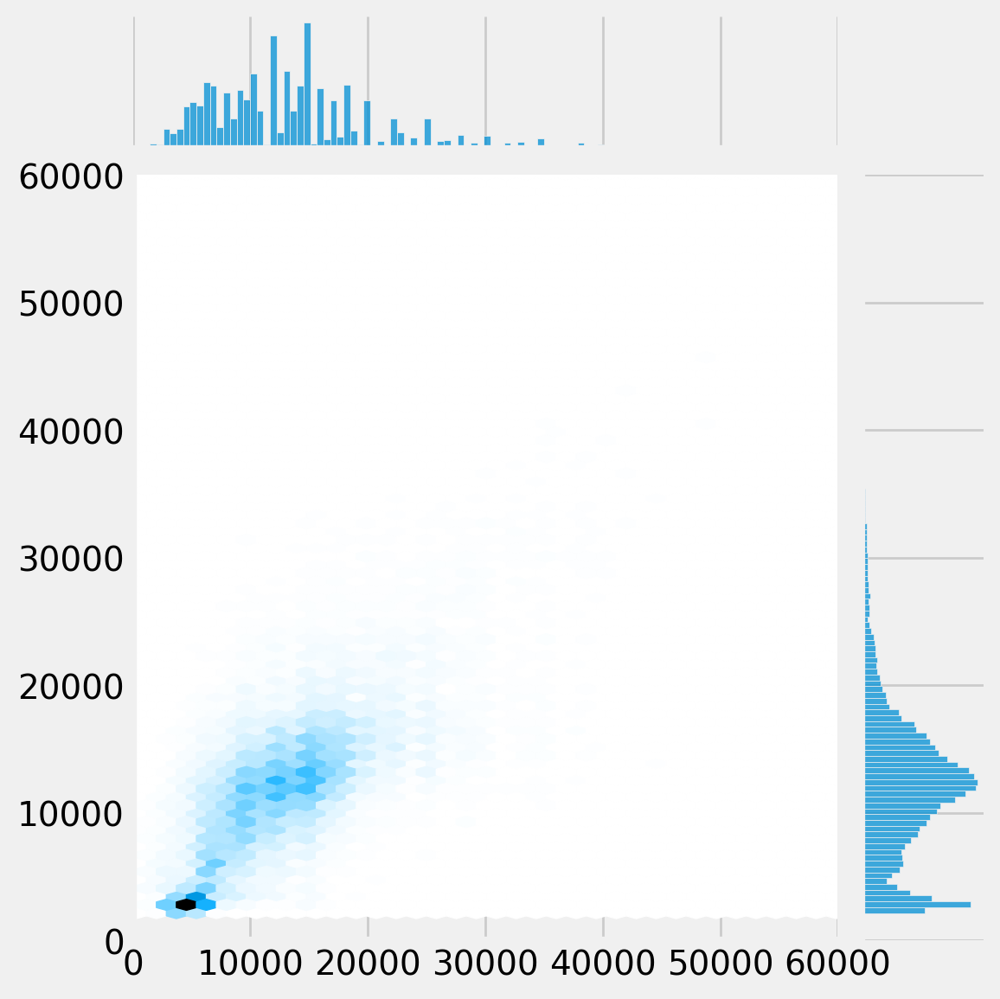

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

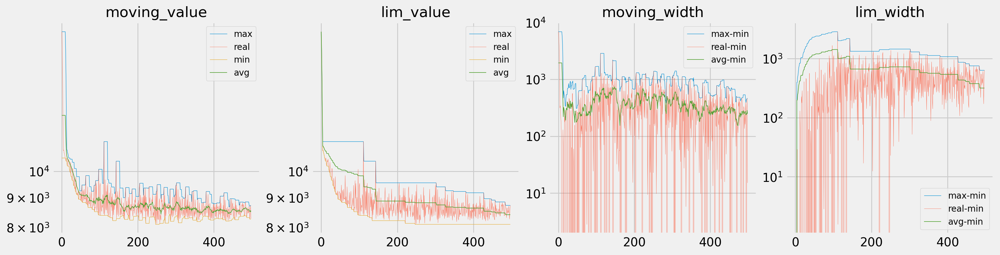

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

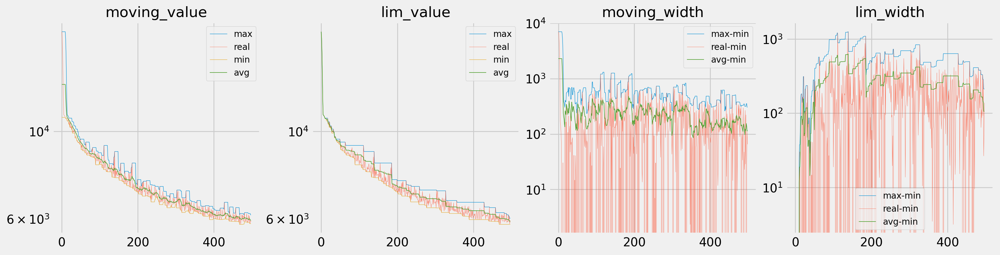

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

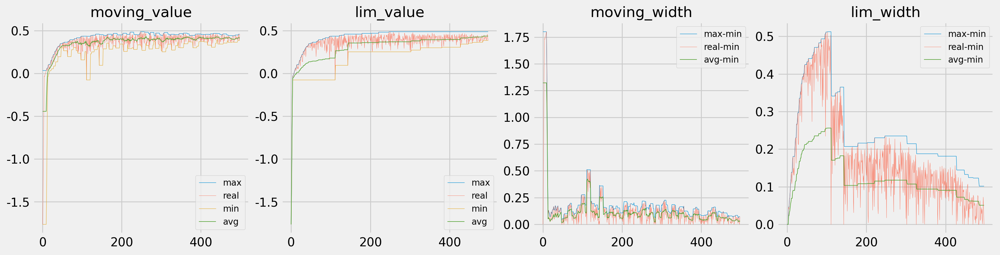

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 2

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008266
	Train Loss: 16032.707	Train Score: -2.851	Val Loss: 15926.162	Val Score: -2.839
Epoch:     2		lr: 0.00008266
	Train Loss: 15836.106	Train Score: -2.760	Val Loss: 15608.287	Val Score: -2.688
Epoch:     3		lr: 0.00008266
	Train Loss: 15451.237	Train Score: -2.582	Val Loss: 15080.171	Val Score: -2.444
Epoch:     4		lr: 0.00008266
	Train Loss: 14875.775	Train Score: -2.323	Val Loss: 14366.283	Val Score: -2.127
Epoch:     5		lr: 0.00008266
	Train Loss: 14131.655	Train Score: -2.001	Val Loss: 13499.520	Val Score: -1.763
Epoch:     6		lr: 0.00008266
	Train Loss: 13247.823	Train Score: -1.640	Val Loss: 12509.313	Val Score: -1.375
Epoch:     7		lr: 0.00008266
	Train Loss: 12254.234	Train Score: -1.260	Val Loss: 11435.630	Val Score: -0.987
Epoch:     8		lr: 0.00008266
	Train Loss: 11189.237	Train Score: -0.886	Val Loss: 10324.171	Val Score: -0.623
Epoch:     9		lr: 0.00008266
	Train Loss: 10115.093	Train Score: -0.542	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:164: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


Epoch:     1		lr: 0.00008266
	Train Loss: 16037.856	Train Score: -2.854	Val Loss: 15939.787	Val Score: -2.846
Epoch:     2		lr: 0.00008266
	Train Loss: 15849.734	Train Score: -2.766	Val Loss: 15636.926	Val Score: -2.702
Epoch:     3		lr: 0.00008266
	Train Loss: 15478.325	Train Score: -2.594	Val Loss: 15135.593	Val Score: -2.469
Epoch:     4		lr: 0.00008266
	Train Loss: 14929.329	Train Score: -2.346	Val Loss: 14463.107	Val Score: -2.169
Epoch:     5		lr: 0.00008266
	Train Loss: 14229.336	Train Score: -2.042	Val Loss: 13648.813	Val Score: -1.824
Epoch:     6		lr: 0.00008266
	Train Loss: 13400.066	Train Score: -1.700	Val Loss: 12714.636	Val Score: -1.453
Epoch:     7		lr: 0.00008266
	Train Loss: 12460.191	Train Score: -1.336	Val Loss: 11686.923	Val Score: -1.075
Epoch:     8		lr: 0.00008266
	Train Loss: 11438.243	Train Score: -0.970	Val Loss: 10605.330	Val Score: -0.711
Epoch:     9		lr: 0.00008266
	Train Loss: 10383.511	Train Score: -0.625	Val Loss: 9549.345	Val Score: -0.391
Epoch:    1

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (353/450) * (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008266
	Train Loss: 16036.604	Train Score: -2.853	Val Loss: 15937.798	Val Score: -2.845
Epoch:     2		lr: 0.00008266
	Train Loss: 15852.568	Train Score: -2.767	Val Loss: 15644.949	Val Score: -2.706
Epoch:     3		lr: 0.00008266
	Train Loss: 15499.222	Train Score: -2.604	Val Loss: 15168.937	Val Score: -2.484
Epoch:     4		lr: 0.00008266
	Train Loss: 14975.594	Train Score: -2.367	Val Loss: 14520.588	Val Score: -2.194
Epoch:     5		lr: 0.00008266
	Train Loss: 14296.282	Train Score: -2.070	Val Loss: 13716.710	Val Score: -1.852
Epoch:     6		lr: 0.00008266
	Train Loss: 13473.591	Train Score: -1.729	Val Loss: 12776.395	Val Score: -1.476
Epoch:     7		lr: 0.00008266
	Train Loss: 12525.410	Train Score: -1.361	Val Loss: 11729.123	Val Score: -1.090
Epoch:     8		lr: 0.00008266
	Train Loss: 11483.109	Train Score: -0.986	Val Loss: 10624.210	Val Score: -0.717
Epoch:     9		lr: 0.00008266
	Train Loss: 10402.177	Train Score: -0.631	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(2)
init_lr *= (best_epoch/450)* (353/450) * (365/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008266
	Train Loss: 16043.966	Train Score: -2.857	Val Loss: 15955.930	Val Score: -2.854
Epoch:     2		lr: 0.00008266
	Train Loss: 15880.816	Train Score: -2.781	Val Loss: 15692.391	Val Score: -2.728
Epoch:     3		lr: 0.00008266
	Train Loss: 15553.001	Train Score: -2.628	Val Loss: 15242.965	Val Score: -2.518
Epoch:     4		lr: 0.00008266
	Train Loss: 15048.365	Train Score: -2.399	Val Loss: 14613.188	Val Score: -2.235
Epoch:     5		lr: 0.00008266
	Train Loss: 14380.815	Train Score: -2.107	Val Loss: 13828.092	Val Score: -1.898
Epoch:     6		lr: 0.00008266
	Train Loss: 13571.895	Train Score: -1.769	Val Loss: 12907.708	Val Score: -1.527
Epoch:     7		lr: 0.00008266
	Train Loss: 12643.585	Train Score: -1.405	Val Loss: 11881.396	Val Score: -1.144
Epoch:     8		lr: 0.00008266
	Train Loss: 11621.607	Train Score: -1.034	Val Loss: 10786.941	Val Score: -0.770
Epoch:     9		lr: 0.00008266
	Train Loss: 10553.868	Train Score: -0.678	Va

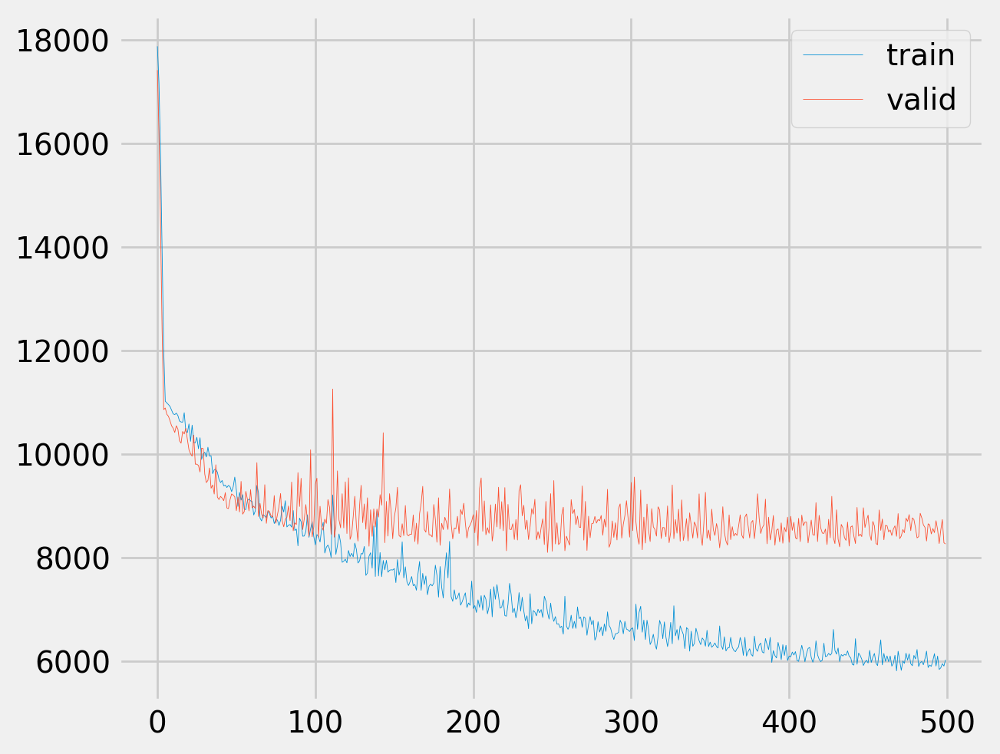

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


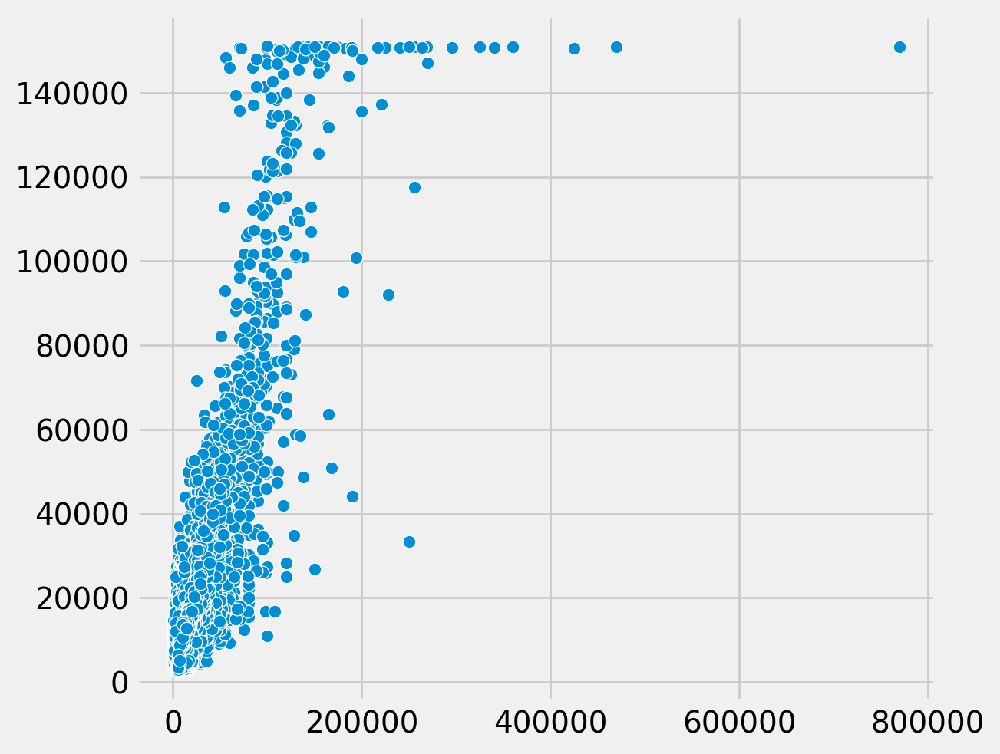

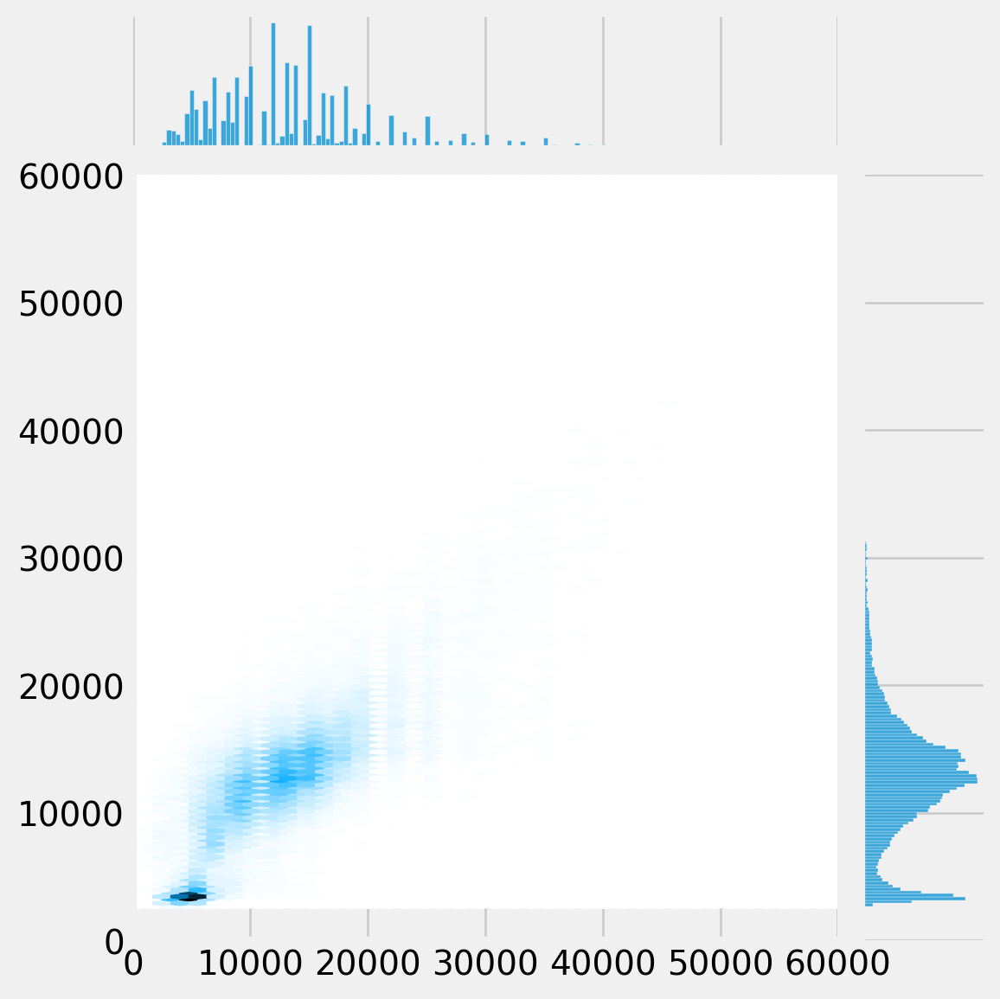

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


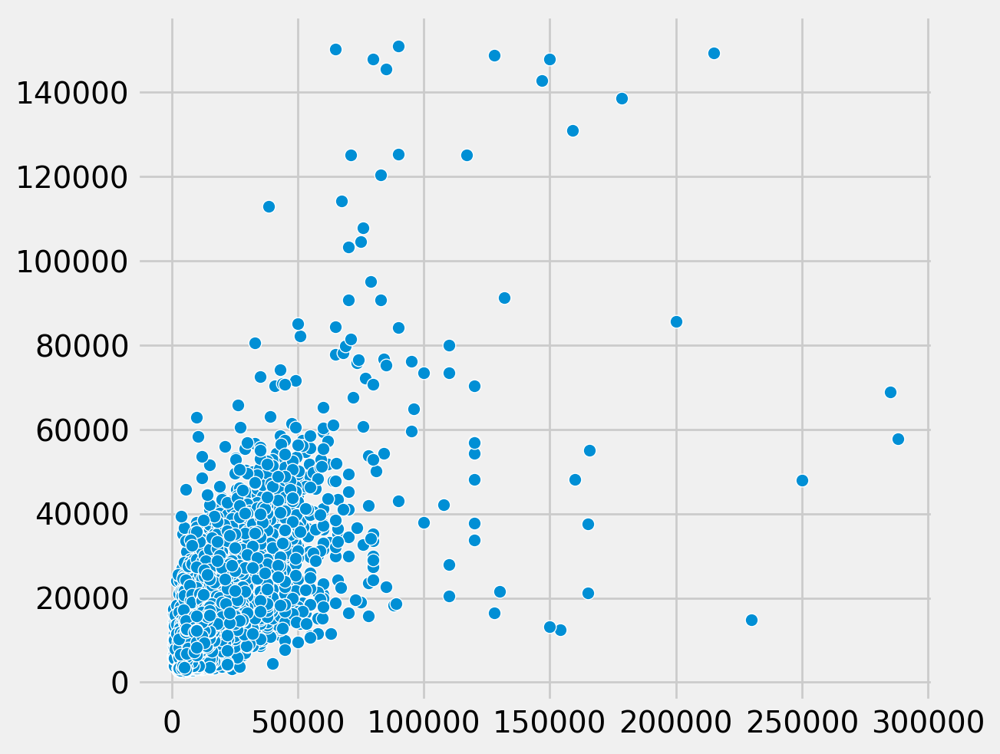

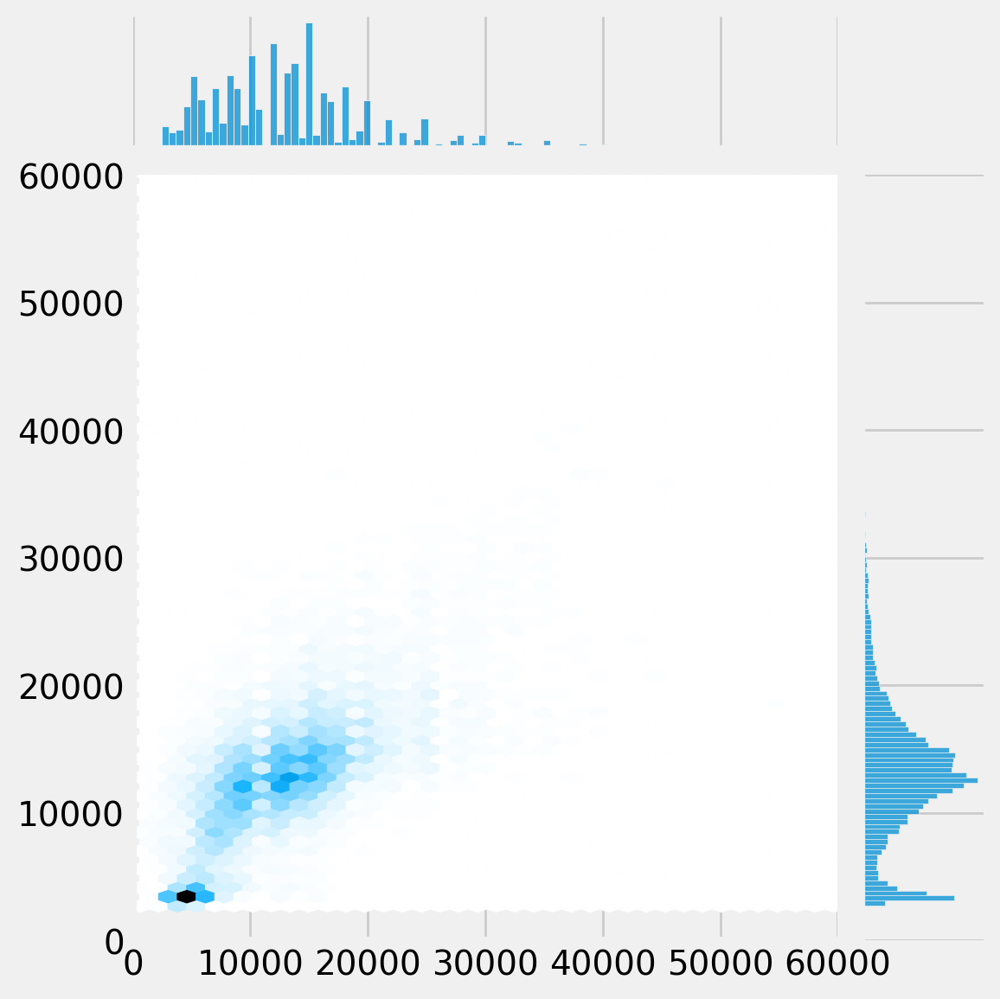

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


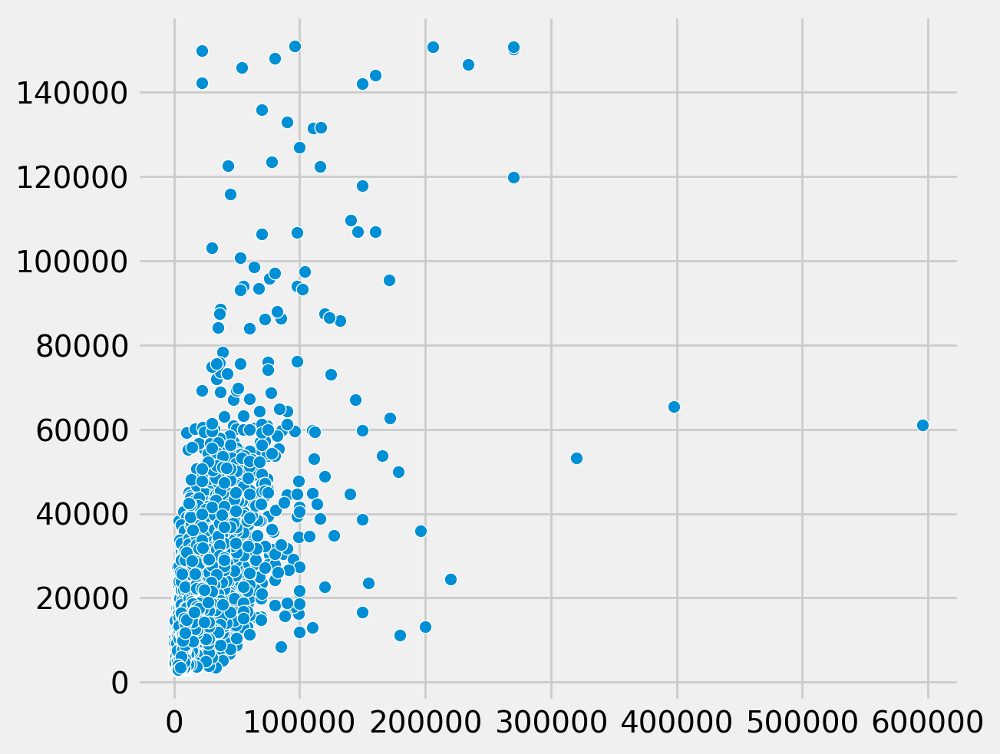

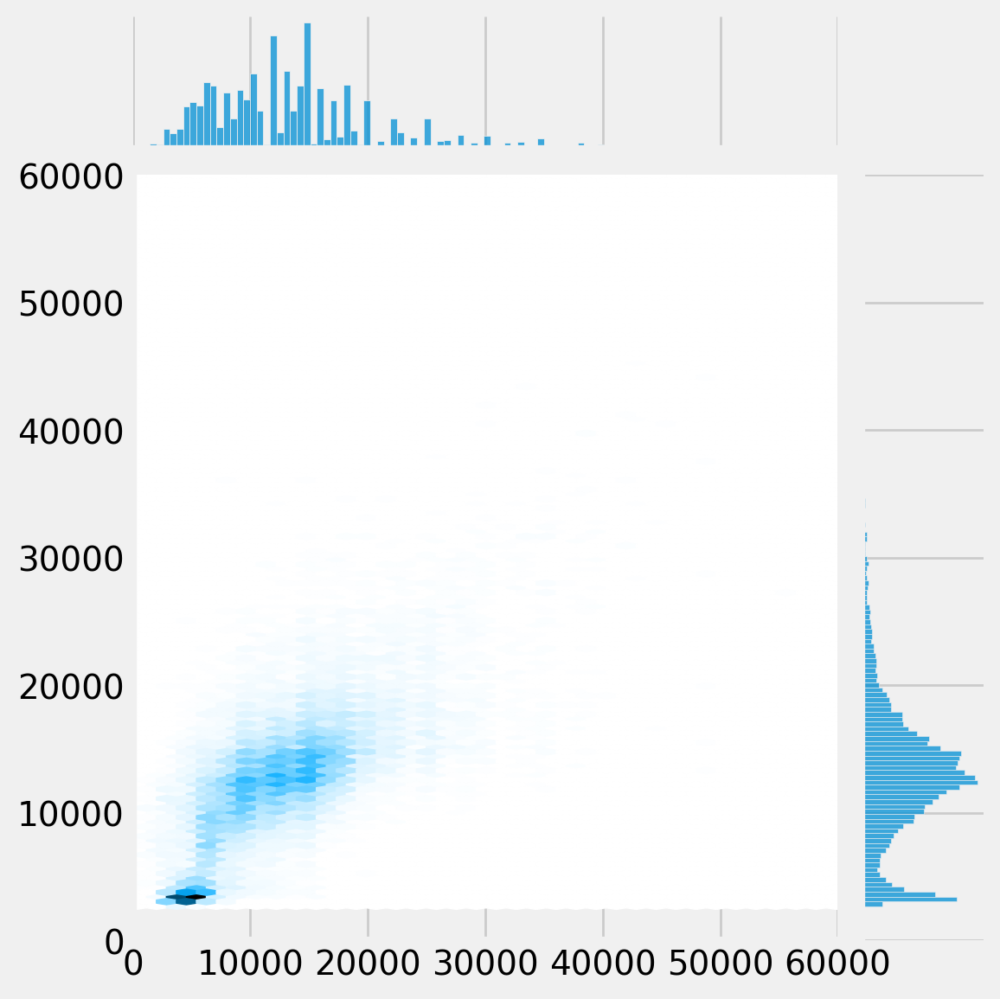

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


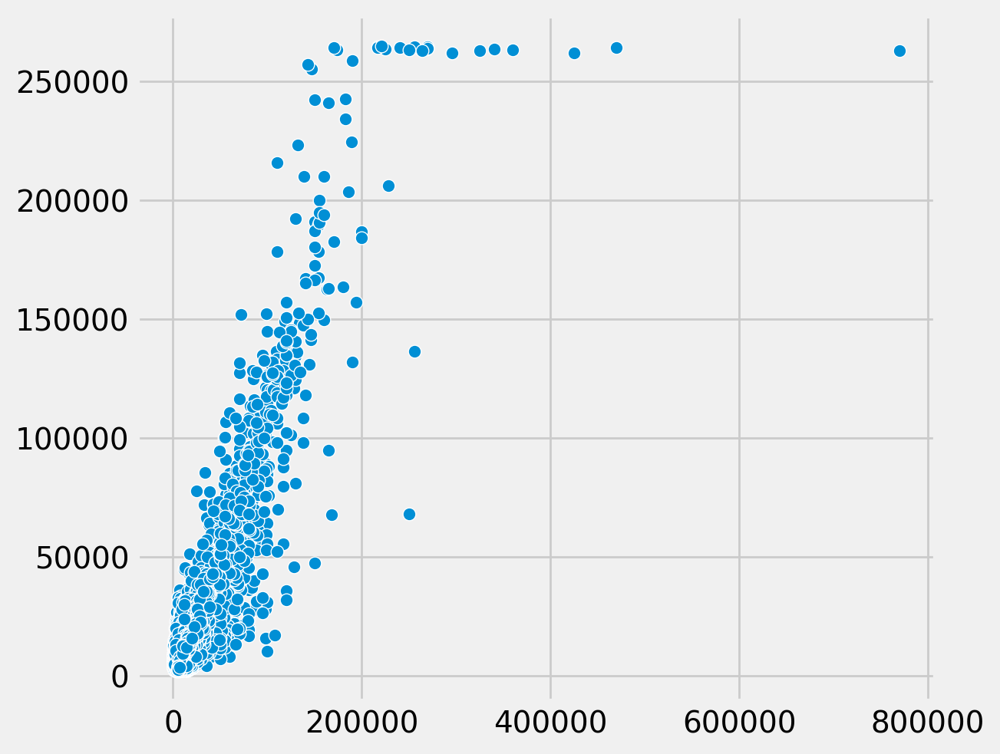

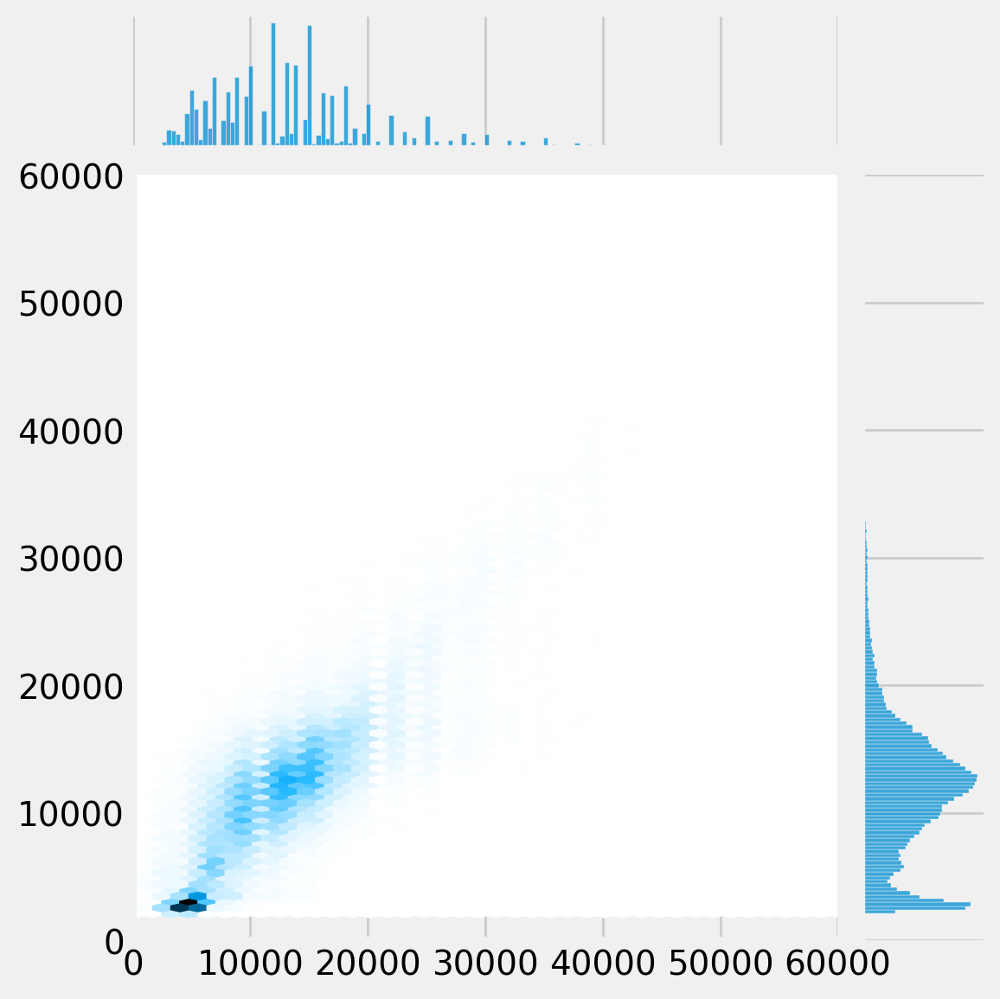

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


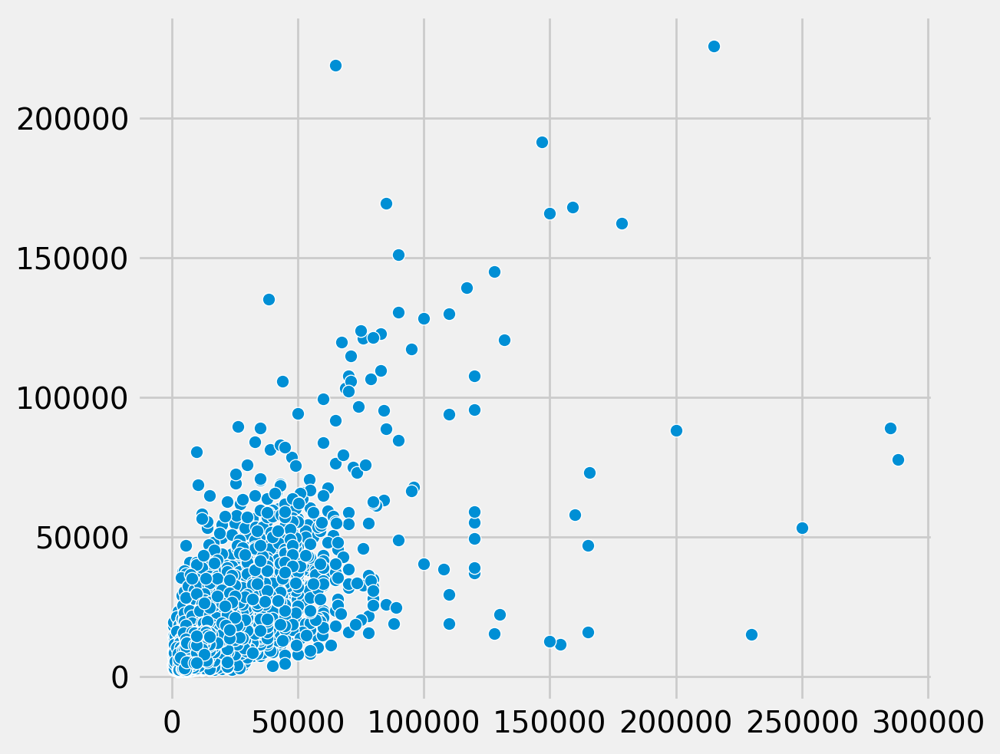

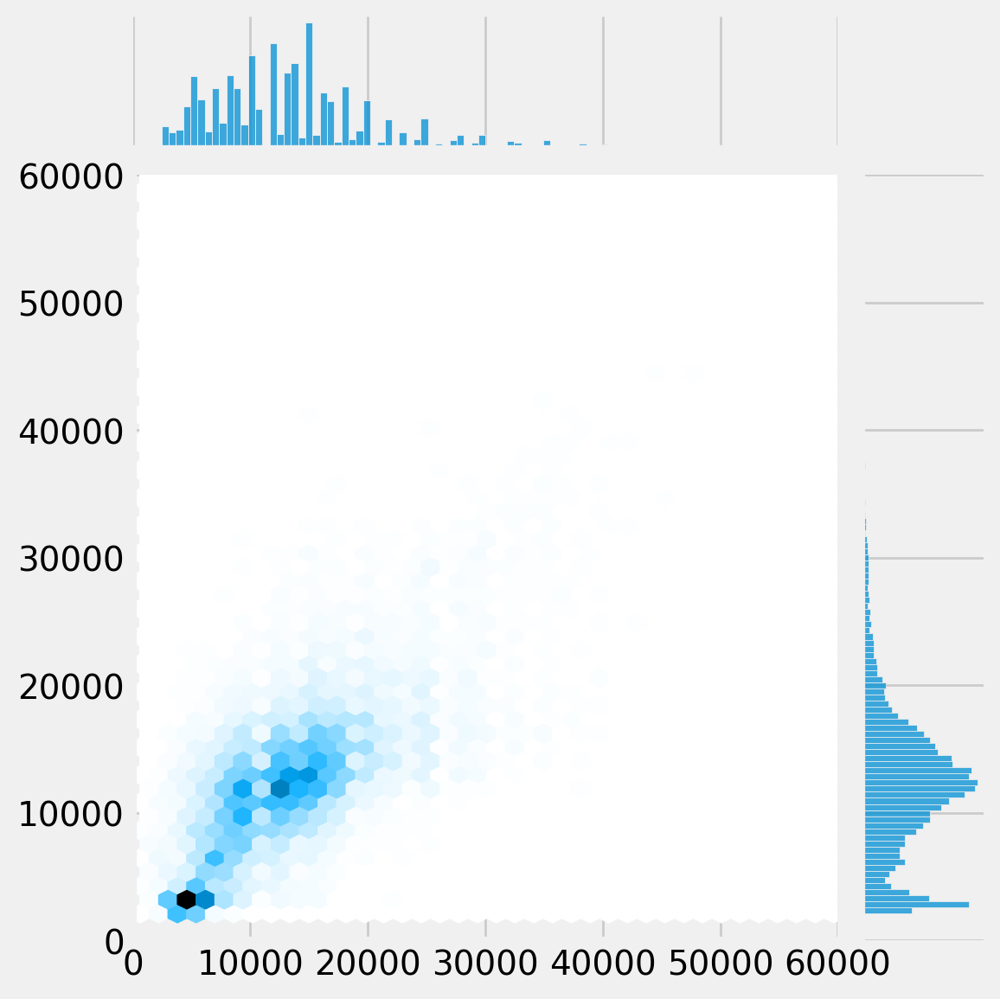

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


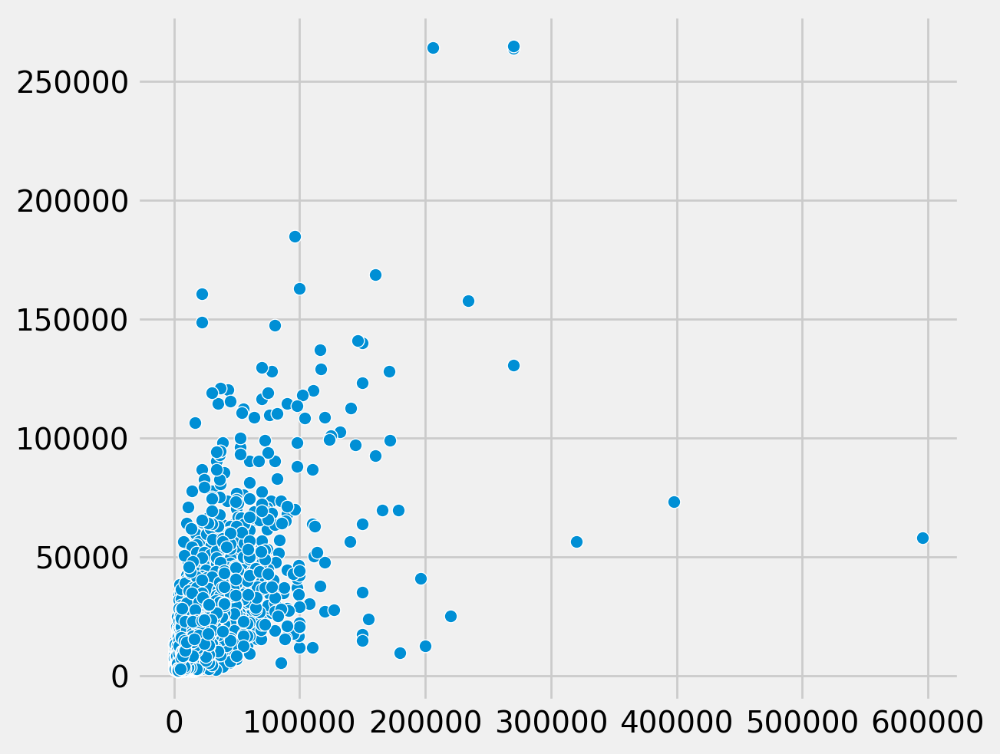

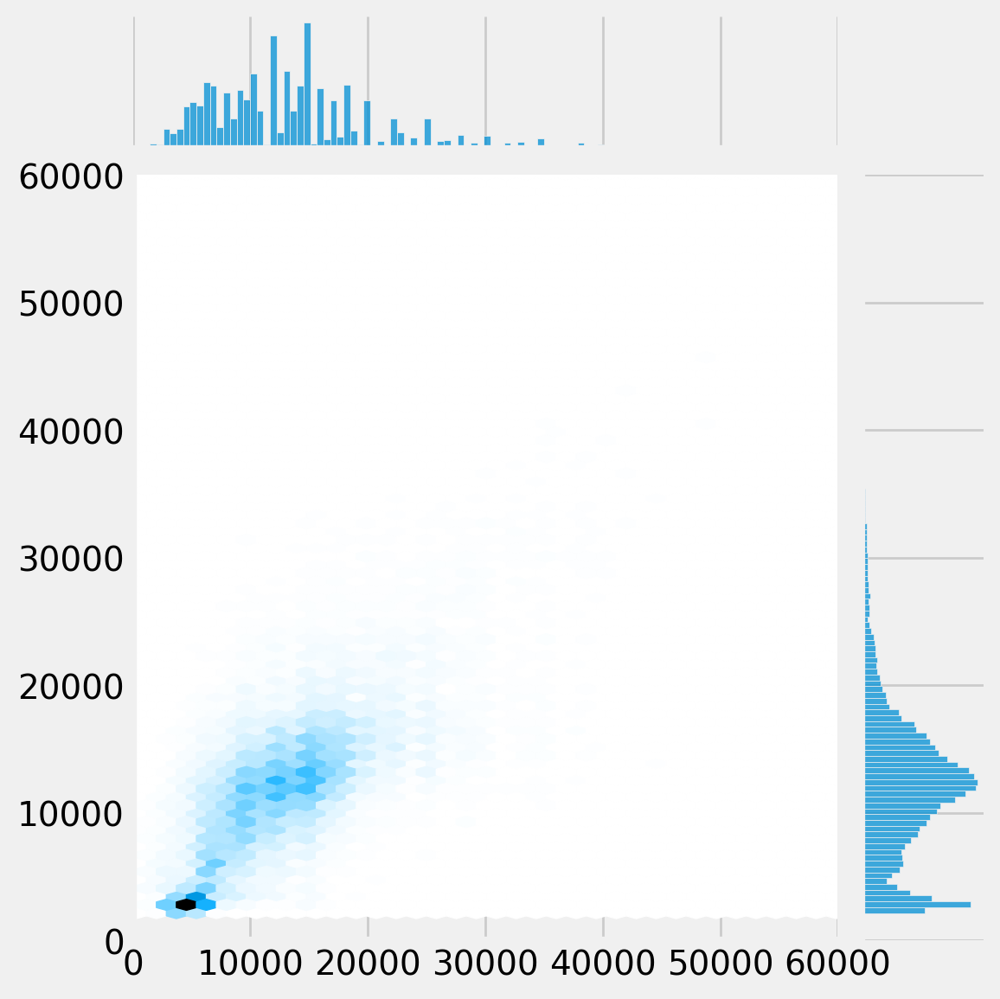

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

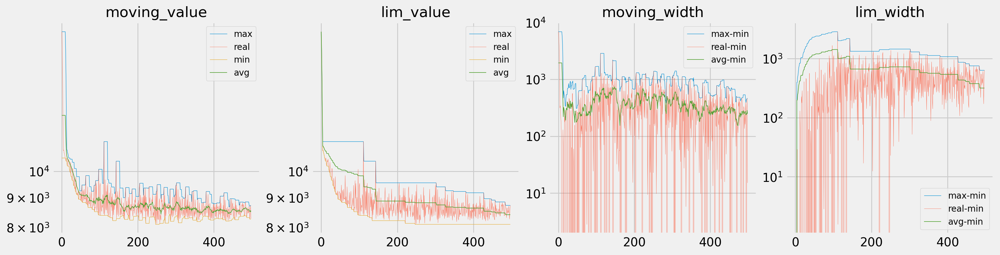

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

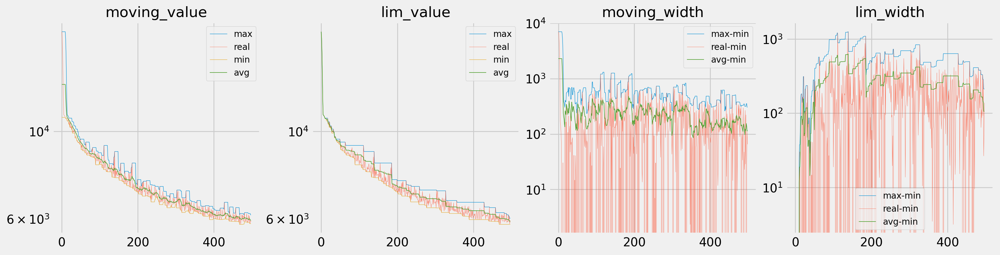

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

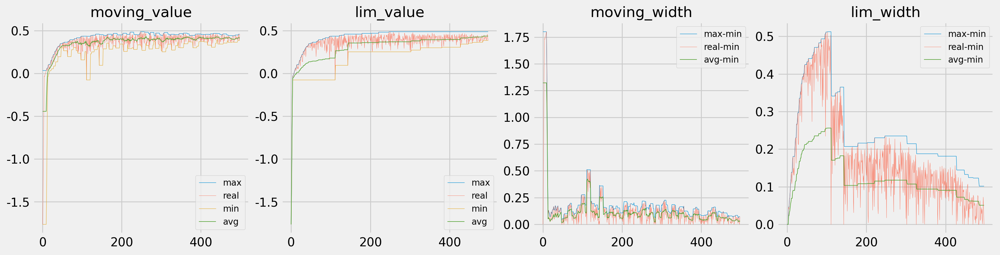

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 3

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16037.955	Train Score: -2.854	Val Loss: 15939.502	Val Score: -2.846
Epoch:     2		lr: 0.00008425
	Train Loss: 15855.209	Train Score: -2.769	Val Loss: 15645.640	Val Score: -2.706
Epoch:     3		lr: 0.00008425
	Train Loss: 15499.601	Train Score: -2.604	Val Loss: 15158.708	Val Score: -2.480


KeyboardInterrupt: 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16037.185	Train Score: -2.854	Val Loss: 15937.355	Val Score: -2.845
Epoch:     2		lr: 0.00008425
	Train Loss: 15850.333	Train Score: -2.767	Val Loss: 15635.160	Val Score: -2.701
Epoch:     3		lr: 0.00008425
	Train Loss: 15486.098	Train Score: -2.598	Val Loss: 15141.165	Val Score: -2.472
Epoch:     4		lr: 0.00008425
	Train Loss: 14948.232	Train Score: -2.355	Val Loss: 14475.010	Val Score: -2.174
Epoch:     5		lr: 0.00008425
	Train Loss: 14256.850	Train Score: -2.054	Val Loss: 13665.026	Val Score: -1.831
Epoch:     6		lr: 0.00008425
	Train Loss: 13432.604	Train Score: -1.713	Val Loss: 12723.813	Val Score: -1.456
Epoch:     7		lr: 0.00008425
	Train Loss: 12491.106	Train Score: -1.348	Val Loss: 11687.452	Val Score: -1.075
Epoch:     8		lr: 0.00008425
	Train Loss: 11461.972	Train Score: -0.979	Val Loss: 10597.133	Val Score: -0.709
Epoch:     9		lr: 0.00008425
	Train Loss: 10397.351	Train Score: -0.629	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (395/450) * (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16038.438	Train Score: -2.854	Val Loss: 15938.736	Val Score: -2.845
Epoch:     2		lr: 0.00008425
	Train Loss: 15853.203	Train Score: -2.768	Val Loss: 15635.549	Val Score: -2.701
Epoch:     3		lr: 0.00008425
	Train Loss: 15486.341	Train Score: -2.598	Val Loss: 15128.526	Val Score: -2.466
Epoch:     4		lr: 0.00008425
	Train Loss: 14933.152	Train Score: -2.348	Val Loss: 14439.569	Val Score: -2.159
Epoch:     5		lr: 0.00008425
	Train Loss: 14215.678	Train Score: -2.036	Val Loss: 13595.926	Val Score: -1.802
Epoch:     6		lr: 0.00008425
	Train Loss: 13355.918	Train Score: -1.682	Val Loss: 12620.300	Val Score: -1.417
Epoch:     7		lr: 0.00008425
	Train Loss: 12376.783	Train Score: -1.306	Val Loss: 11546.471	Val Score: -1.026
Epoch:     8		lr: 0.00008425
	Train Loss: 11313.046	Train Score: -0.928	Val Loss: 10424.905	Val Score: -0.654
Epoch:     9		lr: 0.00008425
	Train Loss: 10224.113	Train Score: -0.576	Va

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
init_lr *= (best_epoch/450) * (395/450) * (391/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00008425
	Train Loss: 16038.071	Train Score: -2.854	Val Loss: 15940.042	Val Score: -2.846
Epoch:     2		lr: 0.00008425
	Train Loss: 15853.134	Train Score: -2.768	Val Loss: 15645.513	Val Score: -2.706
Epoch:     3		lr: 0.00008425
	Train Loss: 15494.115	Train Score: -2.601	Val Loss: 15162.412	Val Score: -2.481
Epoch:     4		lr: 0.00008425
	Train Loss: 14961.391	Train Score: -2.360	Val Loss: 14503.952	Val Score: -2.187
Epoch:     5		lr: 0.00008425
	Train Loss: 14272.222	Train Score: -2.060	Val Loss: 13689.024	Val Score: -1.841
Epoch:     6		lr: 0.00008425
	Train Loss: 13439.944	Train Score: -1.716	Val Loss: 12739.658	Val Score: -1.462
Epoch:     7		lr: 0.00008425
	Train Loss: 12484.377	Train Score: -1.346	Val Loss: 11683.606	Val Score: -1.074
Epoch:     8		lr: 0.00008425
	Train Loss: 11435.822	Train Score: -0.970	Val Loss: 10569.112	Val Score: -0.700
Epoch:     9		lr: 0.00008425
	Train Loss: 10350.427	Train Score: -0.615	Va

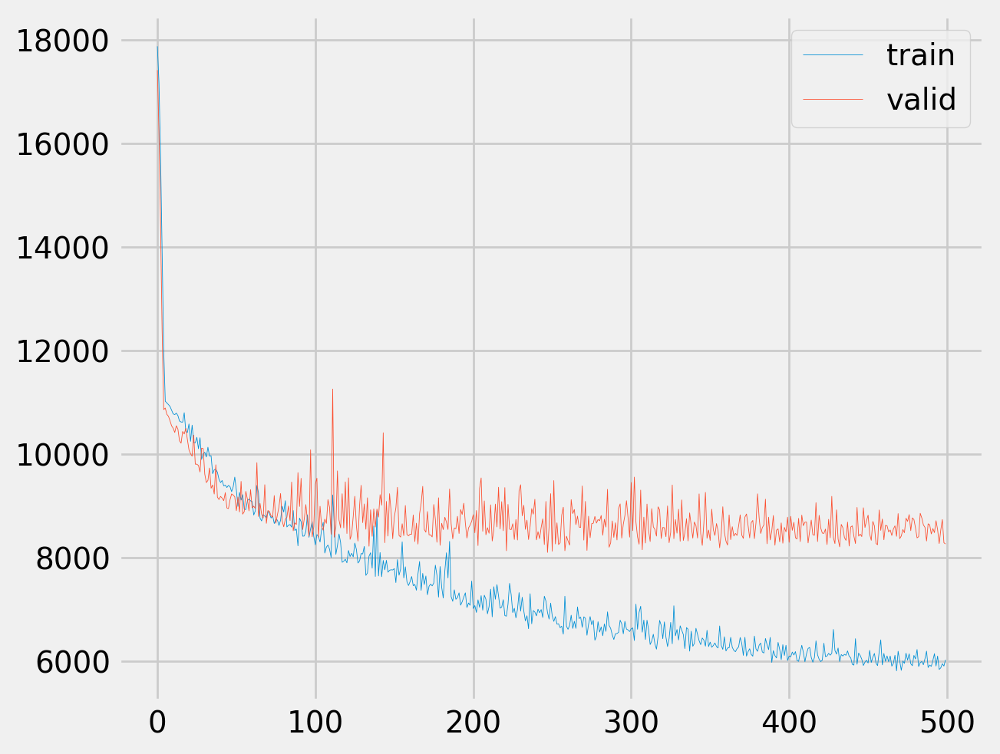

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

#### TEST

In [ ]:
total_model_path = os.path.join(RSLT_DIR,'model/model4.5_8192_500_N6_lr0.000082','best_model_241115.pt')

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(3)
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
total_model = torch.load(total_model_path)
criterion = train_config[-2]

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:175: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(
<ipython-input-44-ff201c90abf1>:2: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to b

4160.324987305679 	r2 :  -0.486175537109375 	mape :  0.24889141


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


4160.324987305679 	r2 :  -0.486175537109375 	mape :  0.24889141


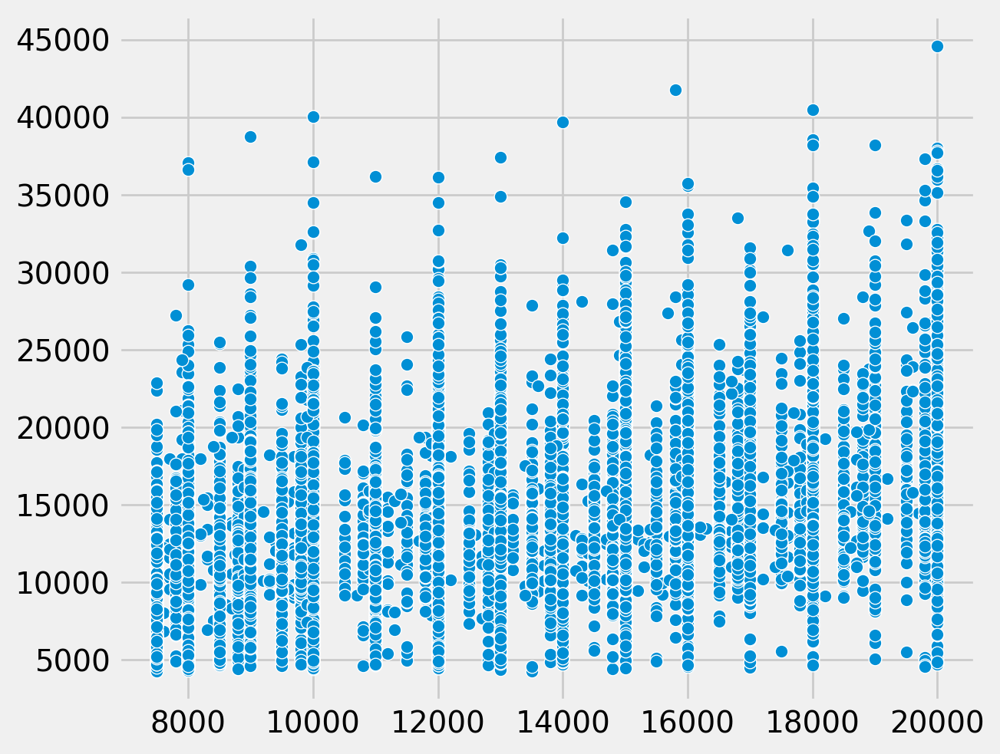

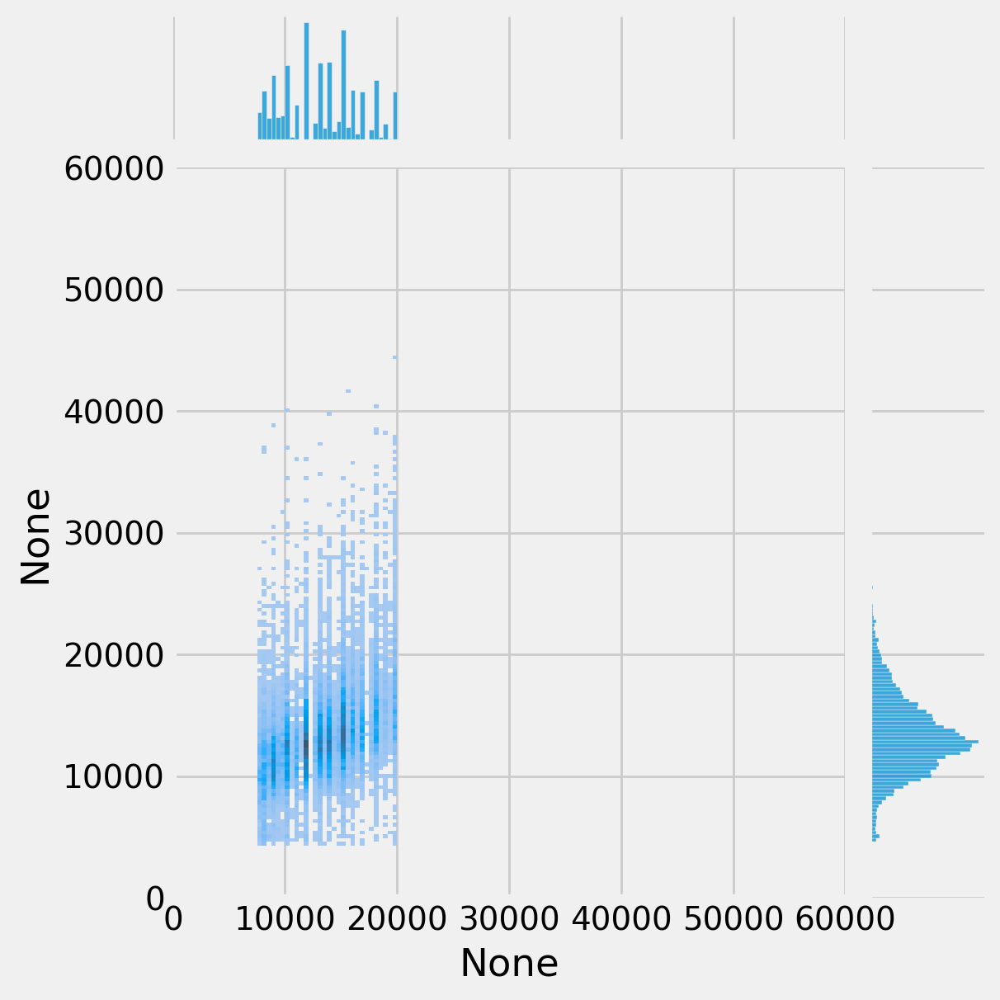

In [ ]:
test_n_plot(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict_box[7]['tst'],criterion,device,scatter=False) #gridsize 500

In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_best = val1-val2
#sns.histplot(val_best)
#sns.jointplot(x=y_true,y=val_best,kind='hist',bins=300,ylim=(0,15),cbar=True)
np.mean(1-val_best)

-0.4861754

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_total = val1-val2
#sns.histplot(val_total)
#sns.jointplot(x=y_true,y=val_total,kind='hist',bins=300,ylim=(0,15),cbar=True)
np.mean(1-val_total)

-0.4380049

<Axes: xlabel='val', ylabel='Count'>

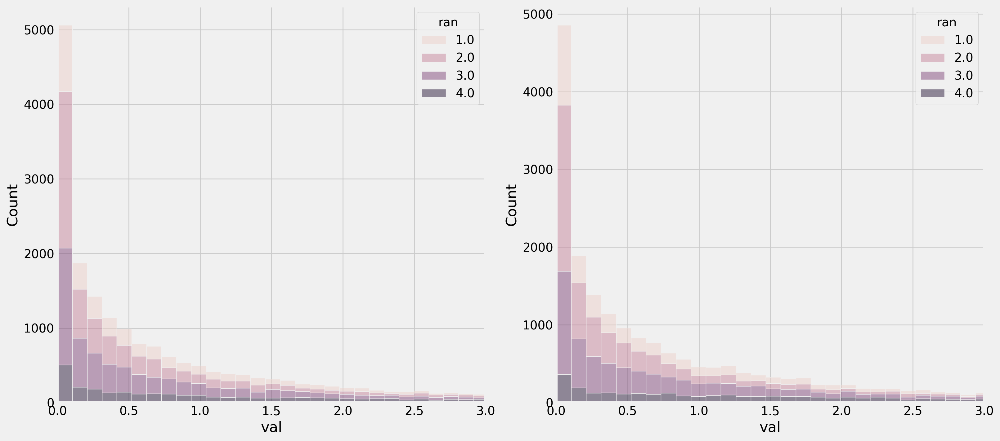

In [ ]:
ran = (y_true-3000)//3500
fig,ax=plt.subplots(1,2,figsize=(16,7))
ax[0].set_xlim(0,3)
ax[1].set_xlim(0,3)
data1 = {'val':val_best,'ran':ran}
data2 = {'val':val_total,'ran':ran}
sns.histplot(data=data1,x='val',hue='ran',alpha=0.5,ax=ax[0],multiple='stack')
sns.histplot(data=data2,x='val',hue='ran',alpha=0.5,ax=ax[1],multiple='stack')

In [ ]:
print(np.min(val_best),np.max(val_best))
print(np.min(val_total),np.max(val_total))

-2.3841858e-07 77.42485
-9.536743e-07 81.29799


In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_best = val1-val2
#sns.histplot(val_best)
#sns.jointplot(x=y_true,y=val_best,kind='hist',bins=300,ylim=(0,15),cbar=True)
y_true1 = y_true
np.mean(1-val_best)

0.49826893

In [ ]:
y_pred,y_true=get_test_rslt(best_model,iter_dict_box[7]['tst'],criterion,device) #gridsize 500
val1 = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val2 = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
val_part= val1-val2
#sns.histplot(val_total)
#sns.jointplot(x=y_true,y=val_total,kind='hist',bins=300,ylim=(0,15),cbar=True)
y_true2 = y_true
np.mean(1-val_part)

-0.4861754

<Axes: xlabel='val', ylabel='Count'>

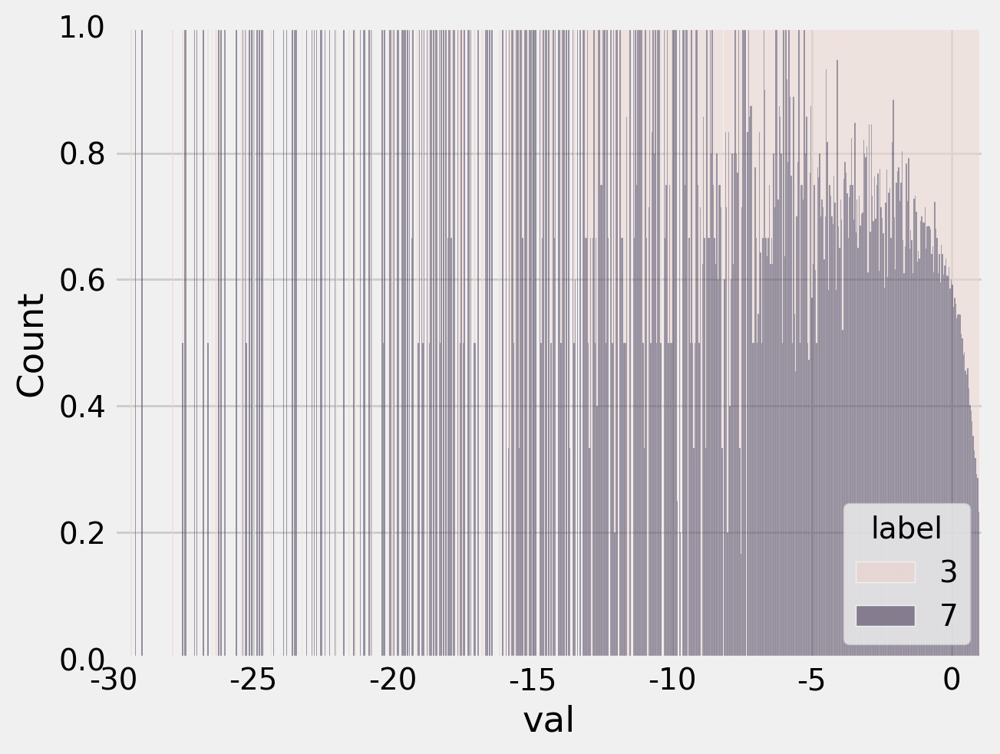

In [ ]:
ran1 = (y_true1-3000)//3500
ran2 = (y_true2-3000)//3500
fig,ax=plt.subplots()#(1,2,figsize=(16,7))
ax.set_xlim(-30,1.2)
data1 = pd.DataFrame({'val':1-val_best,'ran':ran1,'label':3})
data2 = pd.DataFrame({'val':1-val_part,'ran':ran2,'label':7})
data = pd.concat([data1,data2])
sns.histplot(data=data,x='val',hue='label',alpha=0.5,ax=ax,multiple='fill')

In [ ]:
display(data1.describe())
display(data2.describe())

,val,ran,label
count,30104.000000,30104.000000,30104.0
mean,0.498269,2.757740,3.0
std,1.484012,2.335231,0.0
min,-36.211140,0.000000,3.0
25%,0.612786,1.000000,3.0
50%,0.894864,2.000000,3.0
75%,0.981797,4.000000,3.0
max,1.000000,17.000000,3.0


,val,ran,label
count,20601.000000,20601.00000,20601.0
mean,-0.486175,2.44425,7.0
std,3.283754,1.00403,0.0
min,-76.424850,1.00000,7.0
25%,-0.536052,2.00000,7.0
50%,0.499799,2.00000,7.0
75%,0.891211,3.00000,7.0
max,1.000000,4.00000,7.0


In [ ]:
print(np.min(val_best),np.max(val_best))
print(np.min(val_total),np.max(val_total))

-2.3841858e-07 77.42485
-9.536743e-07 81.29799


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


-1.0

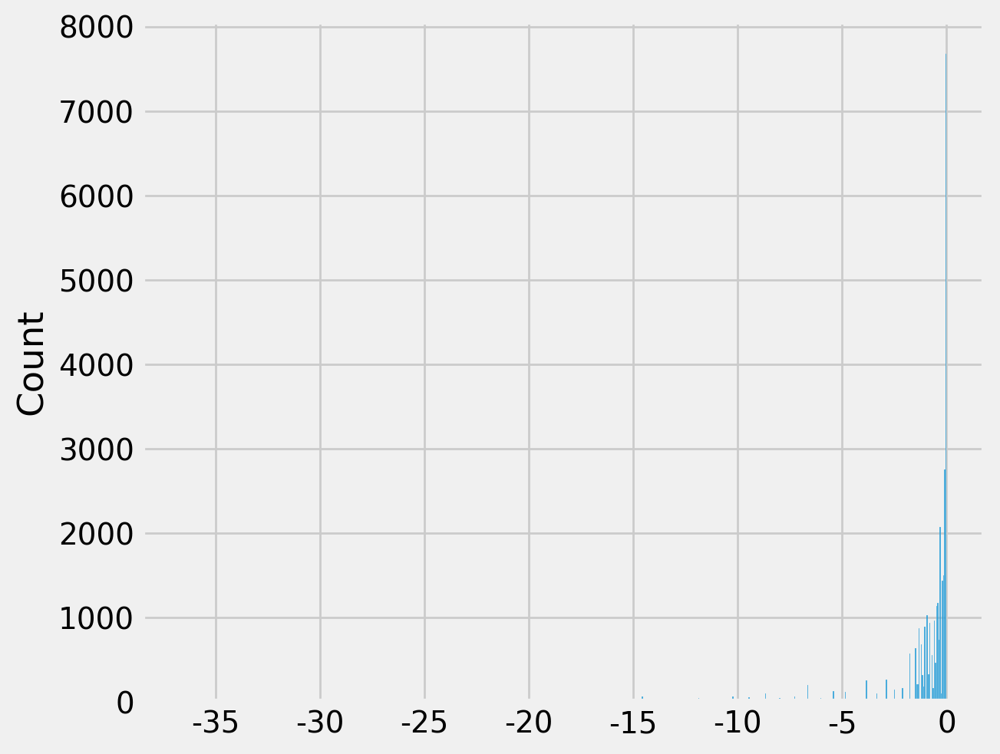

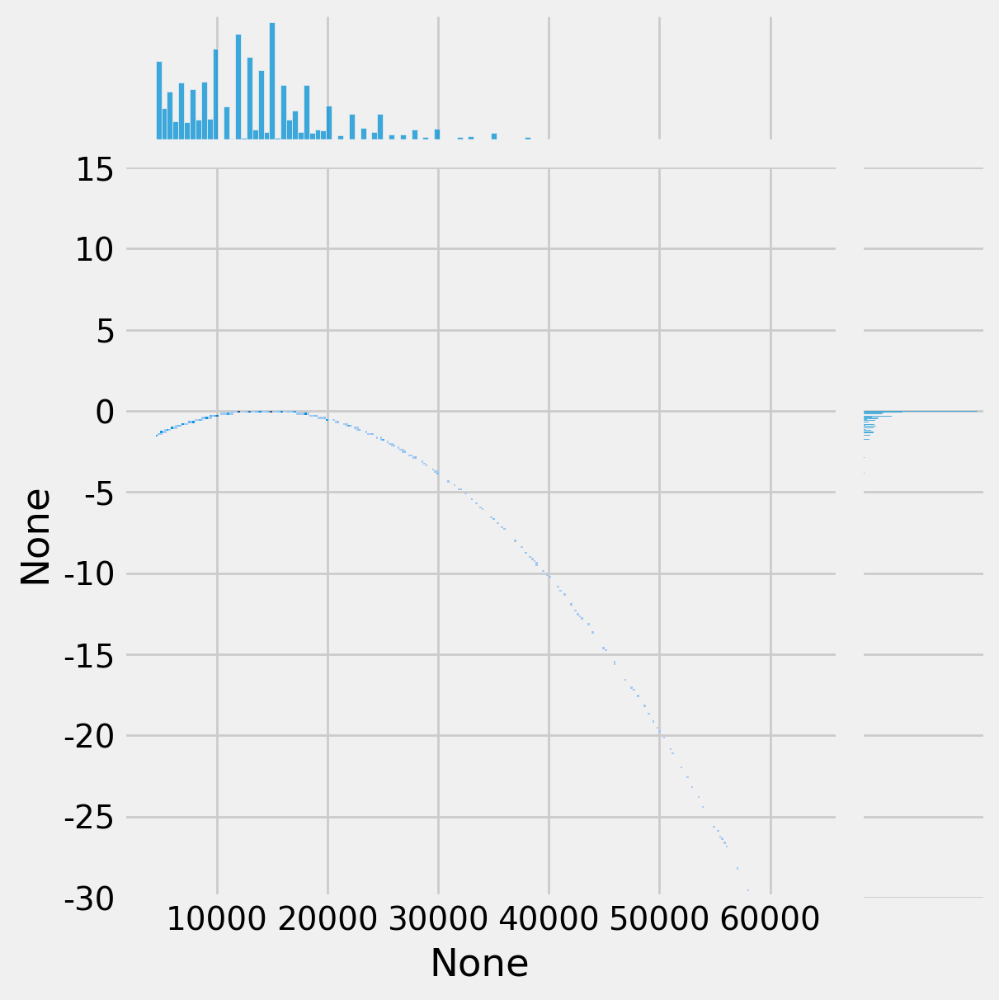

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val = (y_true-np.mean(y_true))*(y_true+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
sns.histplot(val)
sns.jointplot(x=y_true,y=val,kind='hist',ylim=(-30,15),bins=300)
np.mean(val)

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


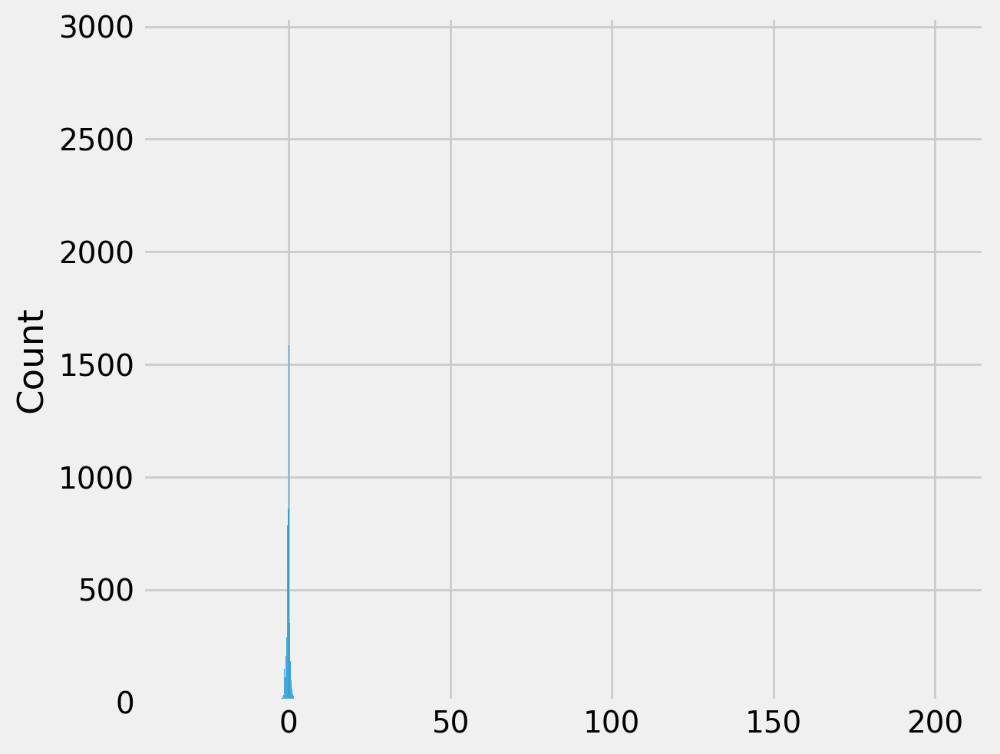

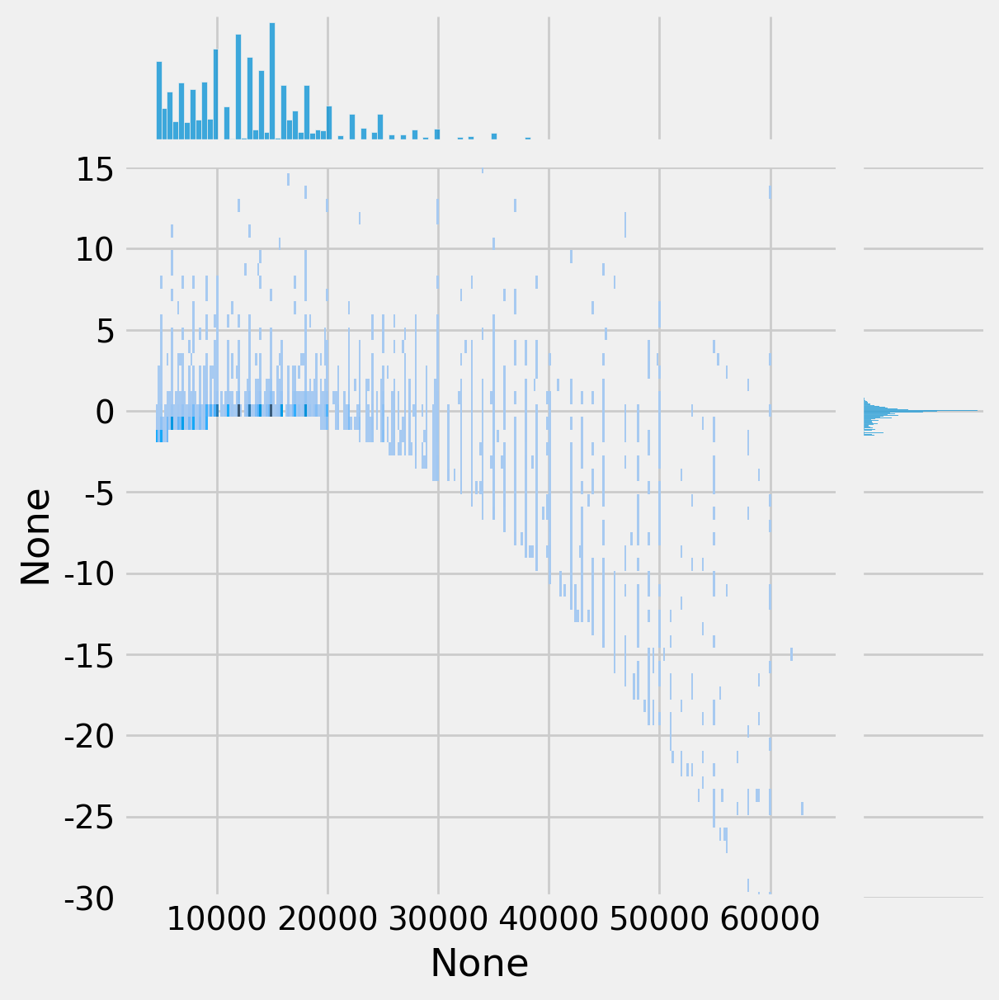

In [ ]:
y_pred,y_true=get_test_rslt(total_model,iter_dict_box[3]['tst'],criterion,device) #gridsize 500
val = (y_pred-np.mean(y_true))*(y_pred+np.mean(y_true)-2*y_true)/(np.mean((y_true-np.mean(y_true))**2))
sns.histplot(val)
sns.jointplot(x=y_true,y=val,kind='hist',ylim=(-30,15),bins=300)

In [ ]:
np.mean(val)

-0.42722005

In [ ]:
r2_score(y_true,y_pred)

0.42722010612487793

In [ ]:
i = np.argmin(val)
y_pred[i],y_true[i],np.mean(y_true)

(44096.94, 62000.0, 14291.837)

In [ ]:
fig,ax=plt.subplots()
ax.set_xlim(0,10)
sns.histplot(val,ax=ax)
#sns.jointplot(x=y_true,y=val,kind='hist',ylim=(0,5))

In [ ]:
np.sum((y_pred-np.mean(y_true))**2)/np.sum((y_true-np.mean(y_true))**2)
1-np.sum((y_pred-y_true)**2)/np.sum((y_true-np.mean(y_true))**2)

0.49826890230178833

7829.522335366315 	r2 :  0.42619526386260986 	mape :  0.34356847


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


7829.522335366315 	r2 :  0.42619526386260986 	mape :  0.34356847


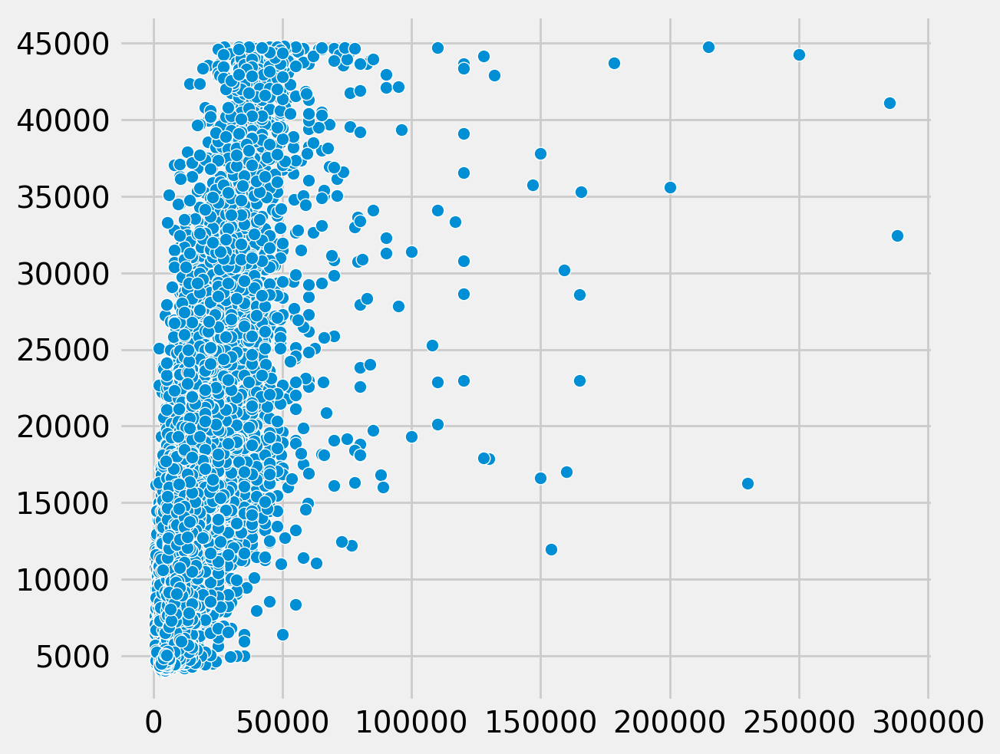

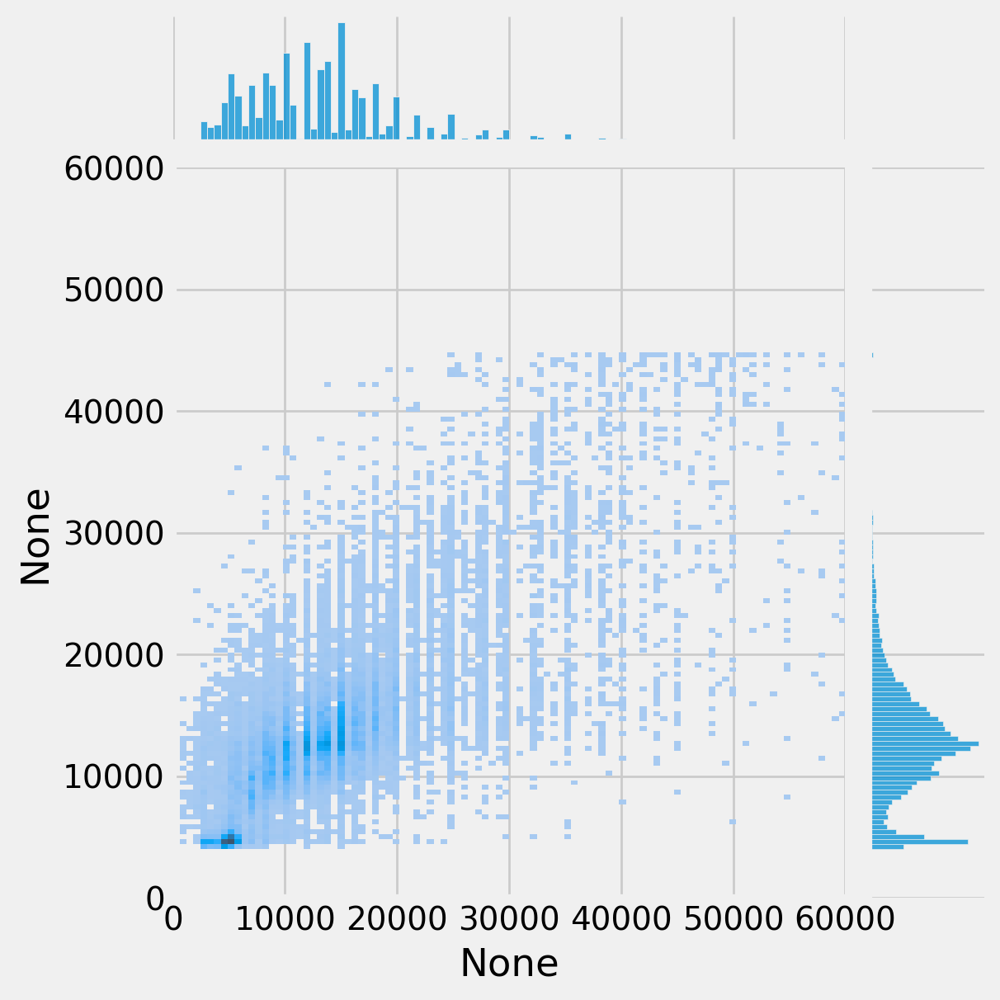

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False) #gridsize 180

9043.04373538025 	r2 :  0.381686270236969 	mape :  0.34596652


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


9043.04373538025 	r2 :  0.381686270236969 	mape :  0.34596652


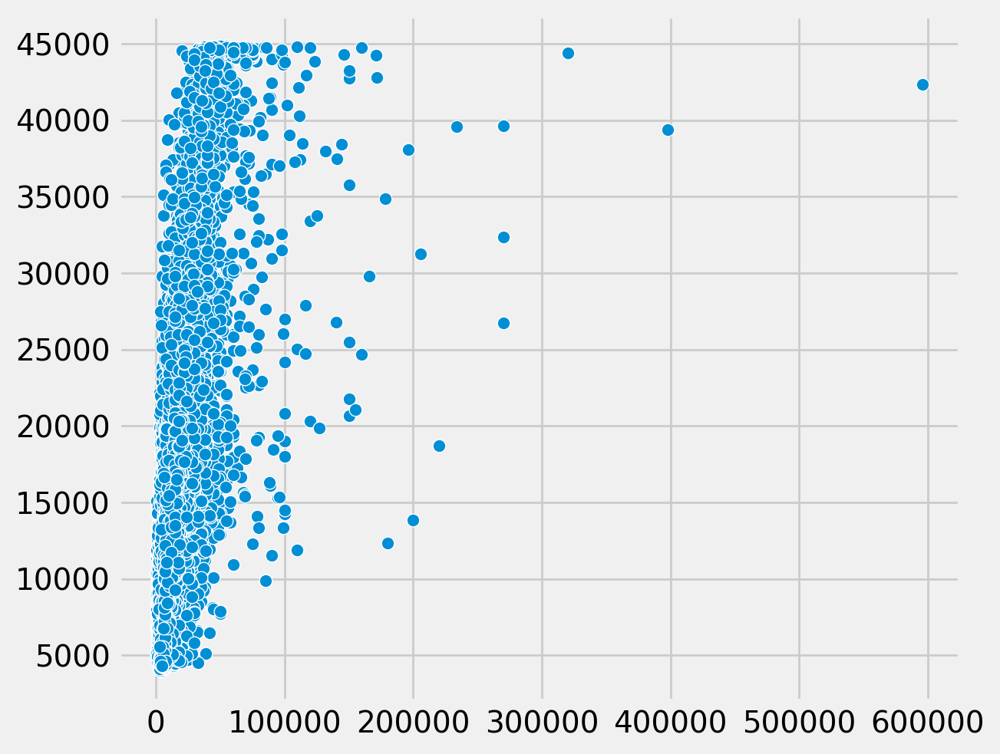

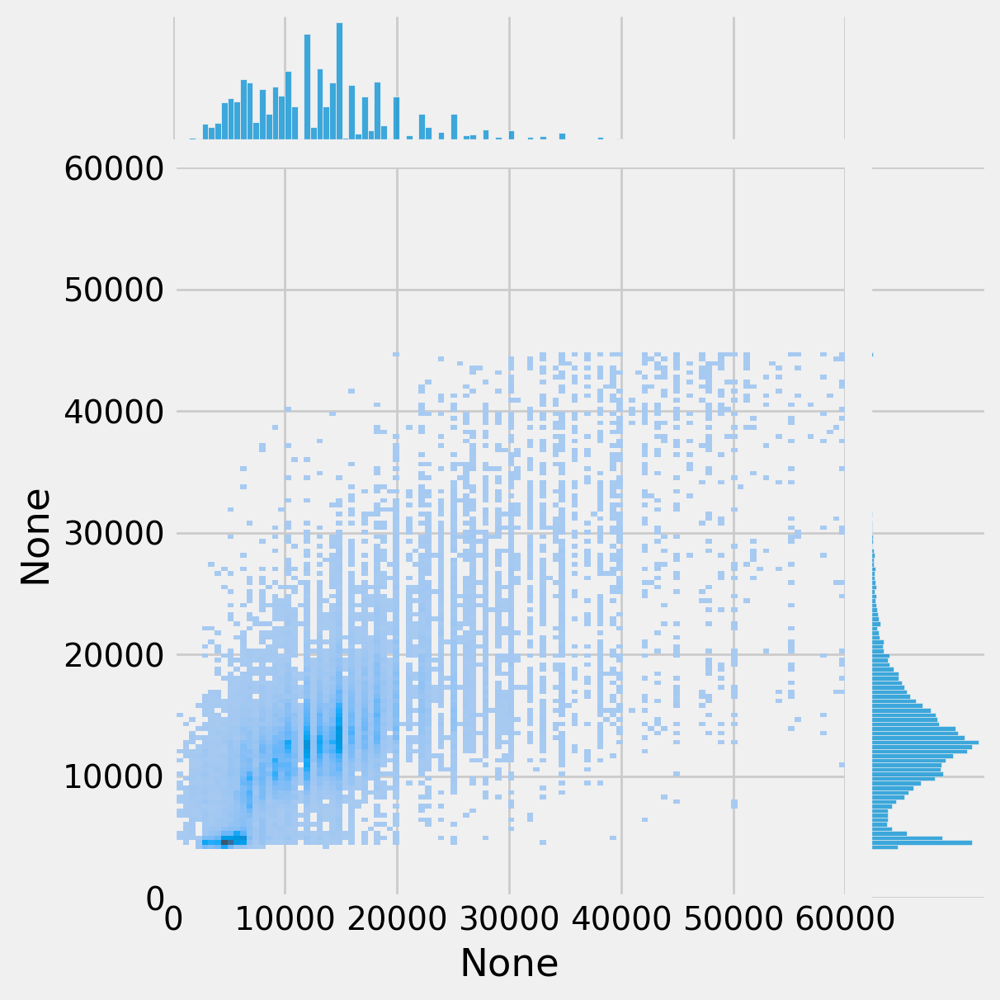

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False) #gridsize 350

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


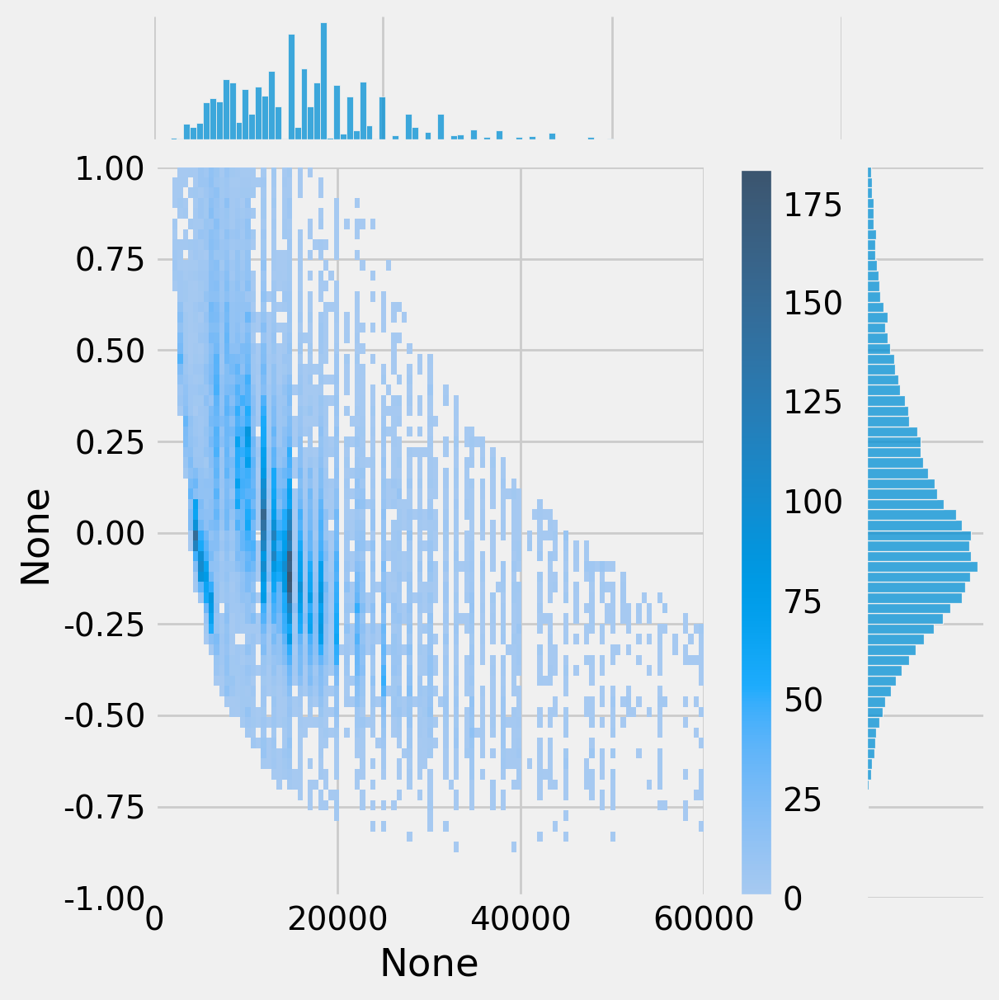

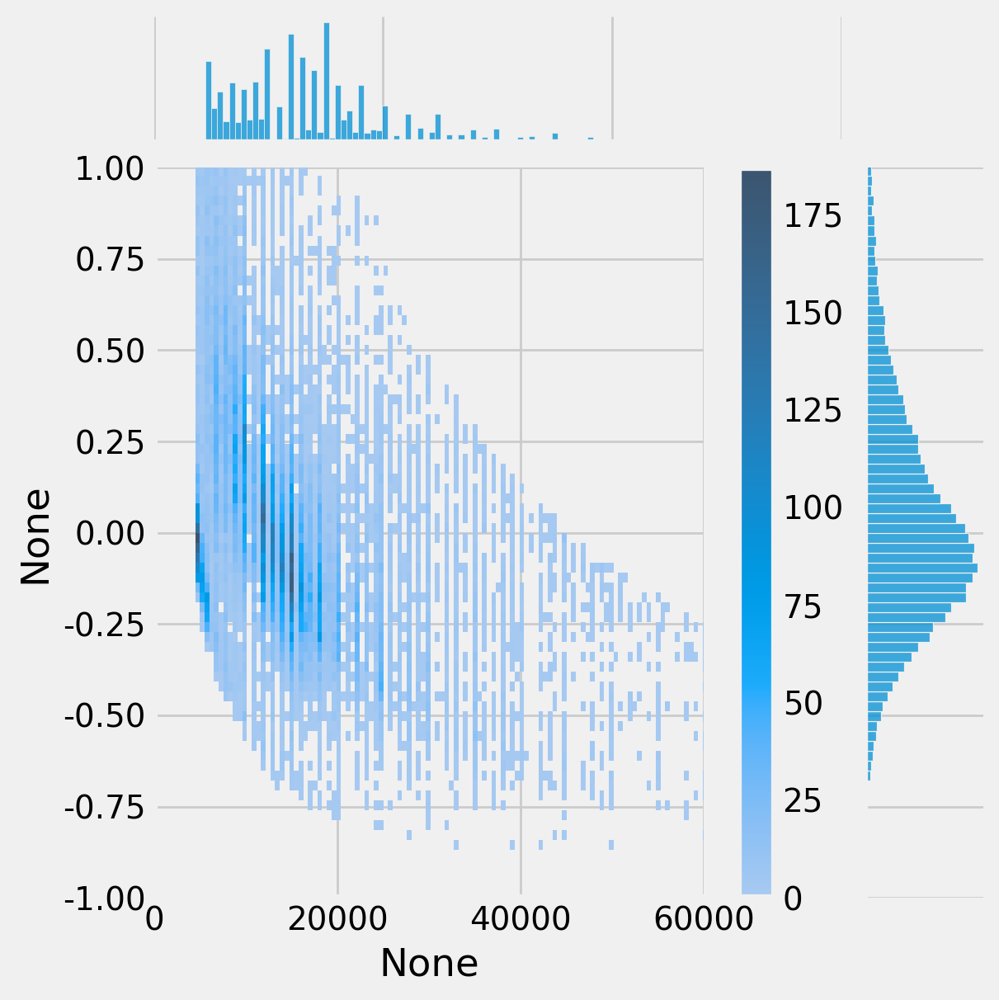

In [ ]:
test_plot_err_dist(best_model,iter_dict['tst'],criterion,device,percent=True,ylim=(-1,1),xlim=(0,60000),cbar=True) #gridsize 180
test_plot_err_dist(best_model,iter_dict_box[3]['tst'],criterion,device,percent=True,ylim=(-1,1),xlim=(0,60000),cbar=True) #gridsize 180

/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()
/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


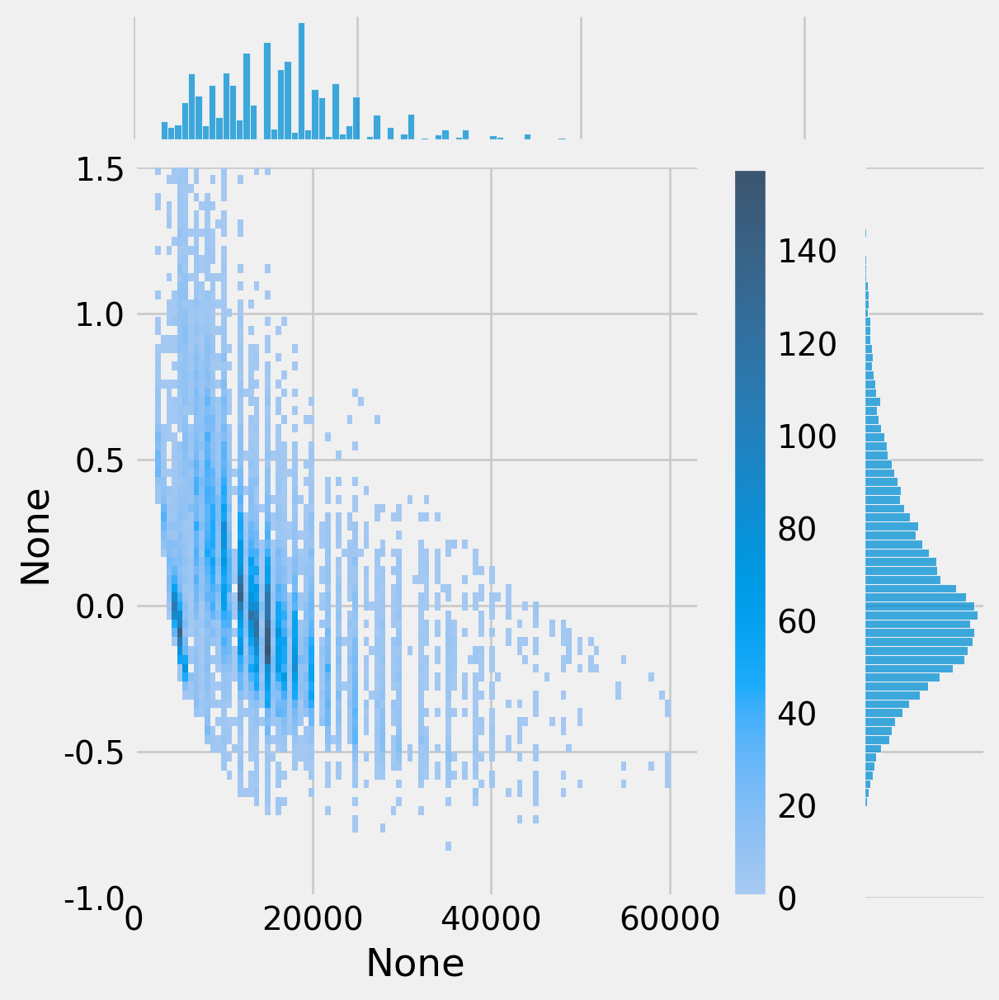

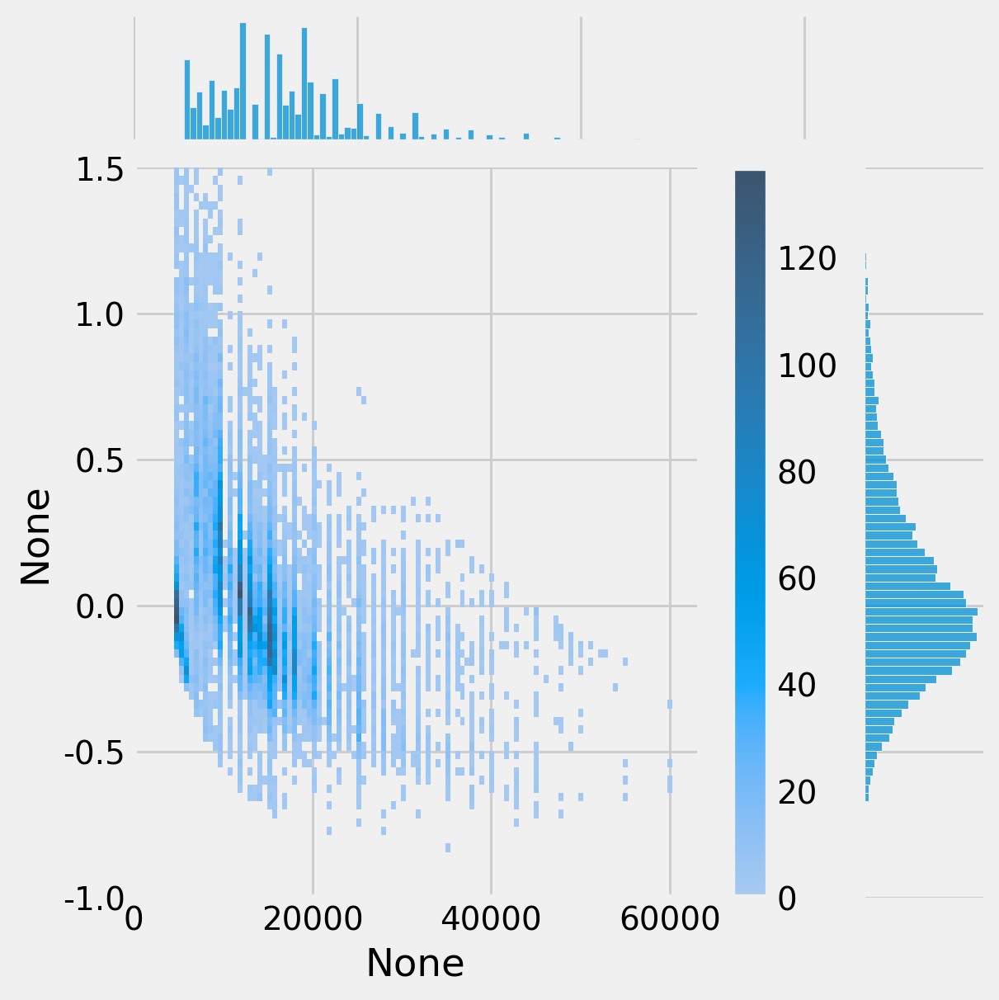

In [ ]:
test_plot_err_dist(best_model,iter_dict['vld'],criterion,device,percent=True,cbar=True,pthresh=0.00001,xlim=(0,63000),ylim=(-1,1.5)) #gridsize 180
test_plot_err_dist(best_model,iter_dict_box[3]['vld'],criterion,device,percent=True,cbar=True,pthresh=0.00001,xlim=(0,63000),ylim=(-1,1.5)) #gridsize 180

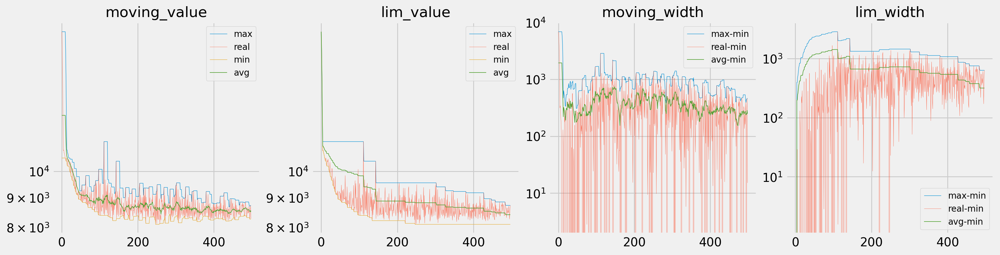

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

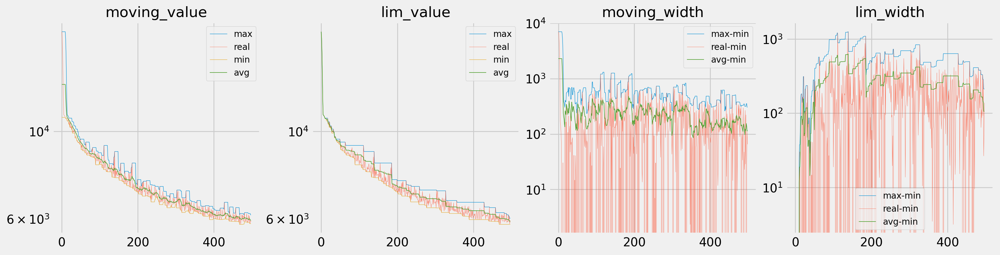

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

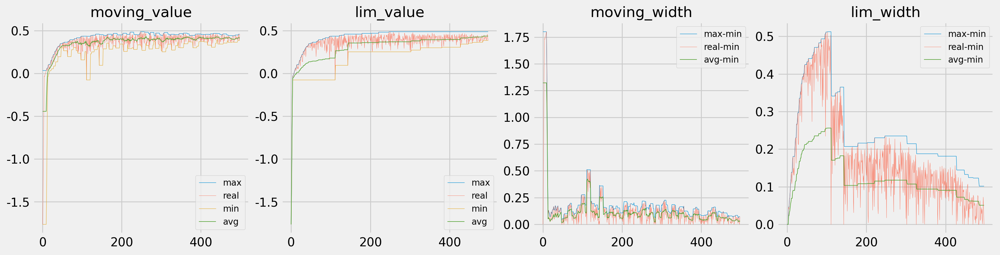

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 4

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(4)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008247
	Train Loss: 16041.199	Train Score: -2.855	Val Loss: 15946.197	Val Score: -2.849
Epoch:     2		lr: 0.00008247
	Train Loss: 15866.778	Train Score: -2.774	Val Loss: 15668.166	Val Score: -2.717
Epoch:     3		lr: 0.00008247
	Train Loss: 15529.277	Train Score: -2.618	Val Loss: 15204.042	Val Score: -2.500
Epoch:     4		lr: 0.00008247
	Train Loss: 15020.101	Train Score: -2.387	Val Loss: 14567.724	Val Score: -2.215
Epoch:     5		lr: 0.00008247
	Train Loss: 14351.619	Train Score: -2.094	Val Loss: 13772.713	Val Score: -1.875
Epoch:     6		lr: 0.00008247
	Train Loss: 13539.609	Train Score: -1.756	Val Loss: 12844.129	Val Score: -1.503
Epoch:     7		lr: 0.00008247
	Train Loss: 12603.100	Train Score: -1.390	Val Loss: 11802.895	Val Score: -1.116
Epoch:     8		lr: 0.00008247
	Train Loss: 11572.751	Train Score: -1.017	Val Loss: 10701.478	Val Score: -0.742
Epoch:     9		lr: 0.00008247
	Train Loss: 10499.588	Train Score: -0.661	Val Loss: 9616.320	Val Score: -0.410
Epoch:    1

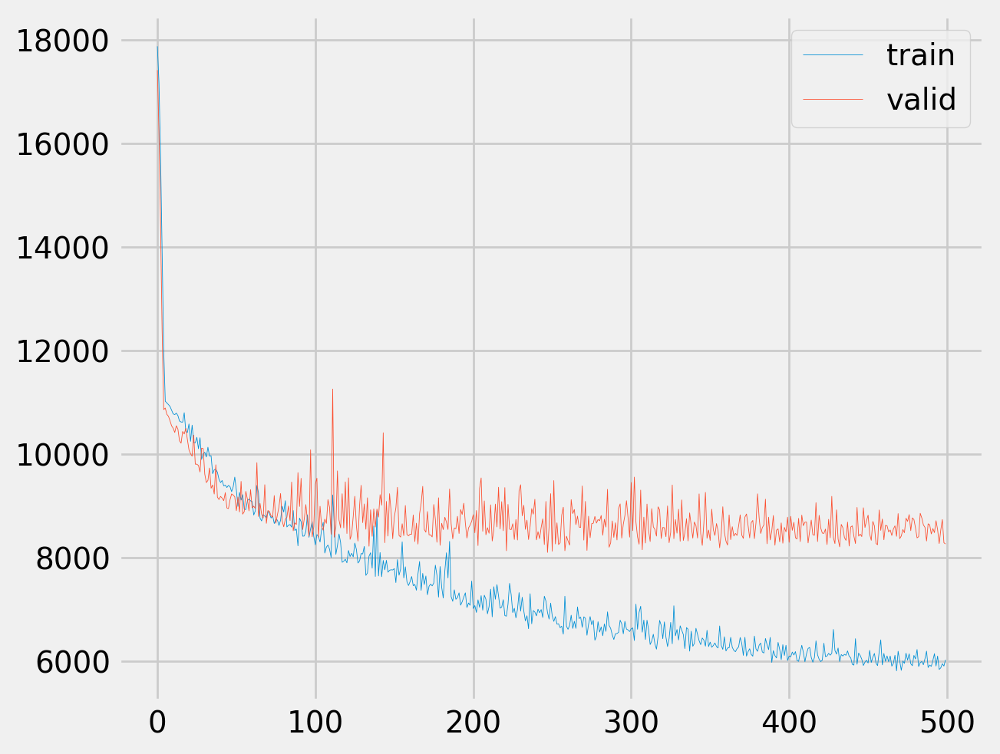

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


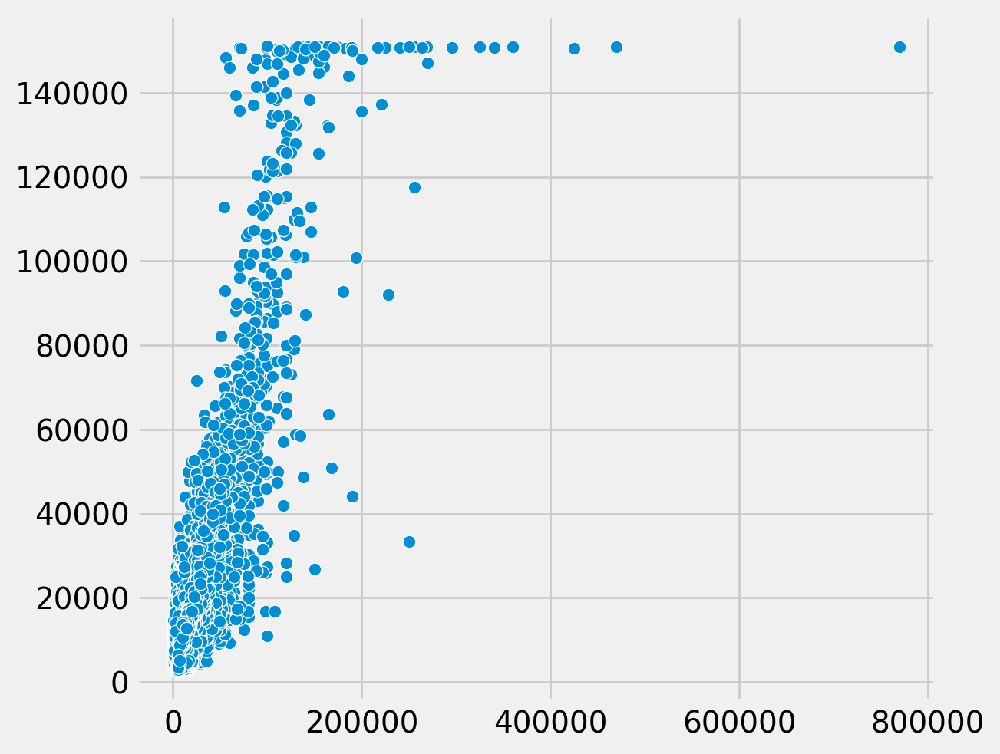

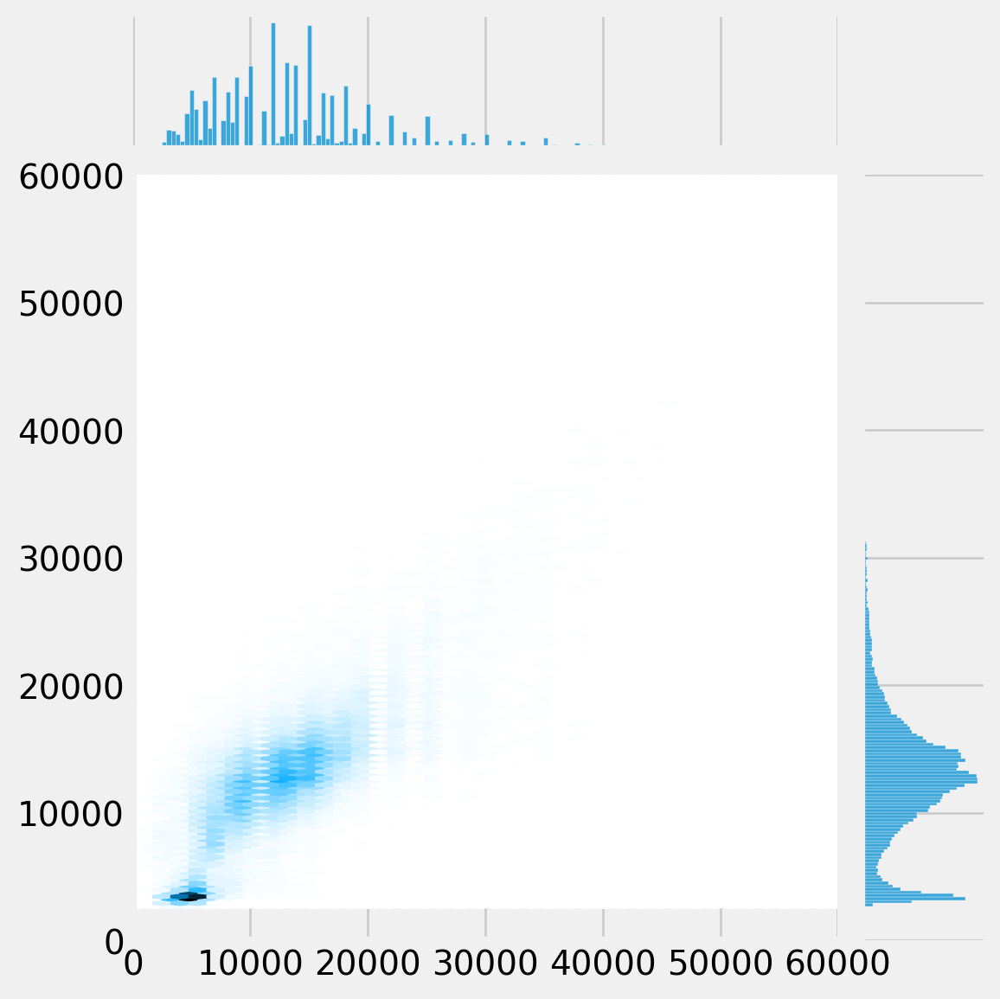

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


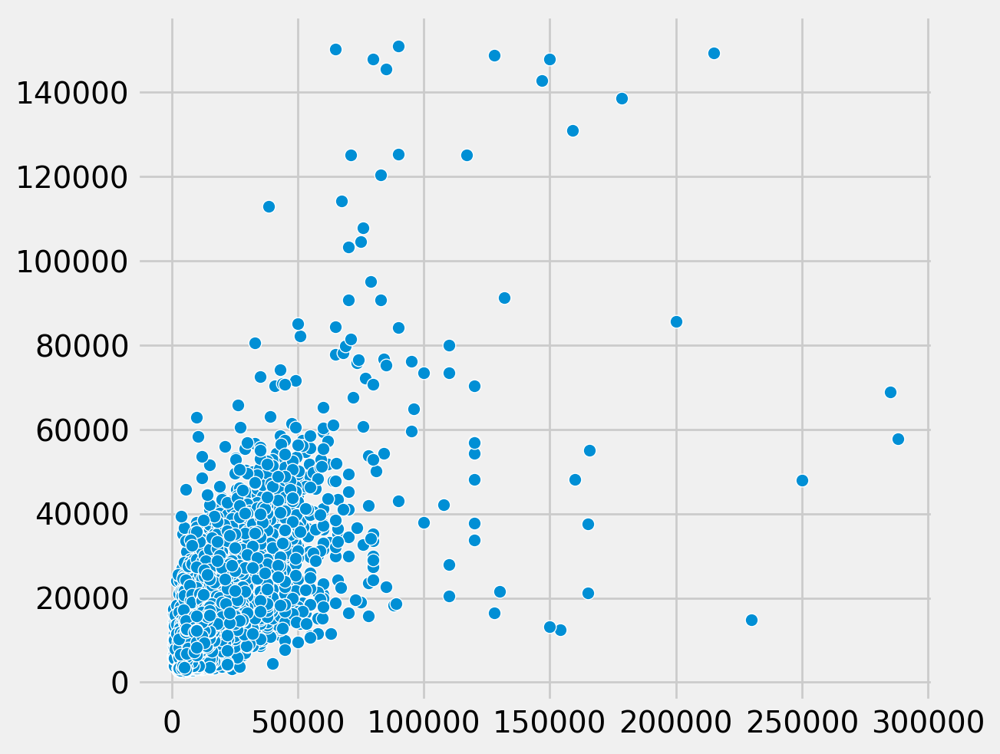

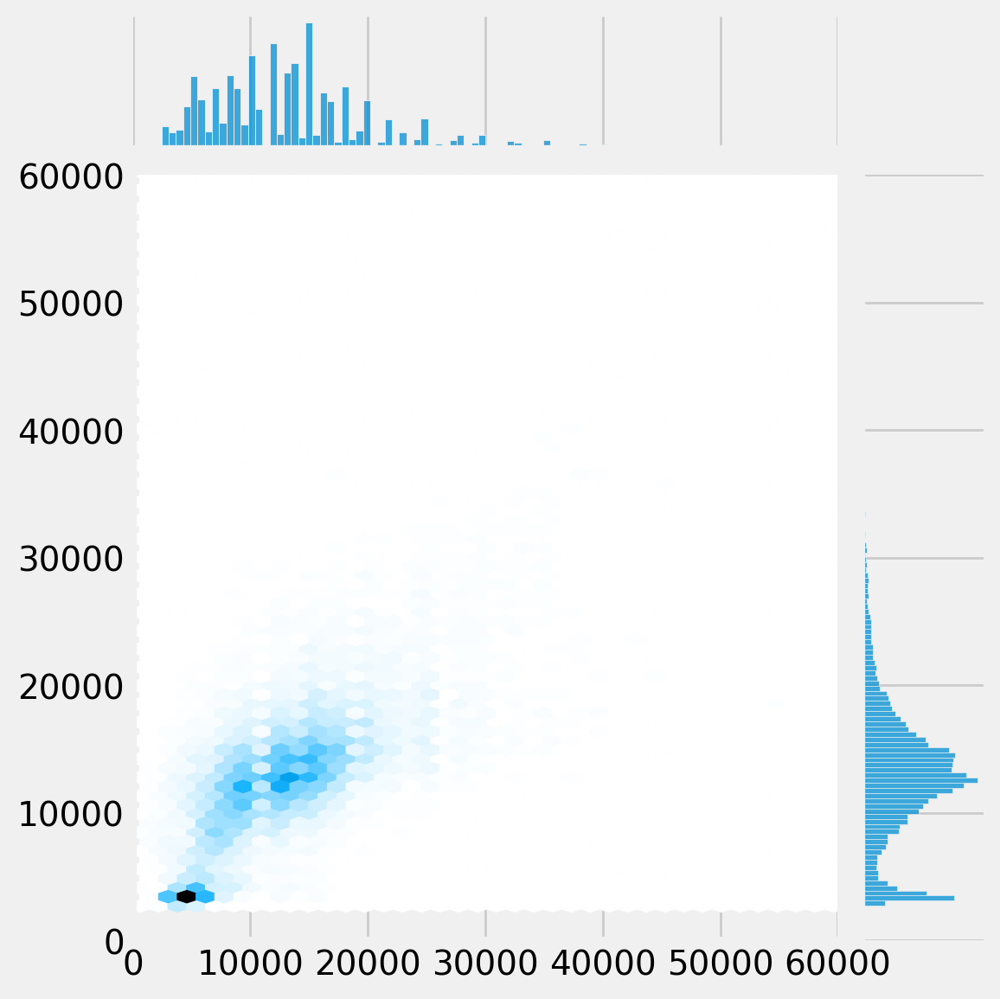

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


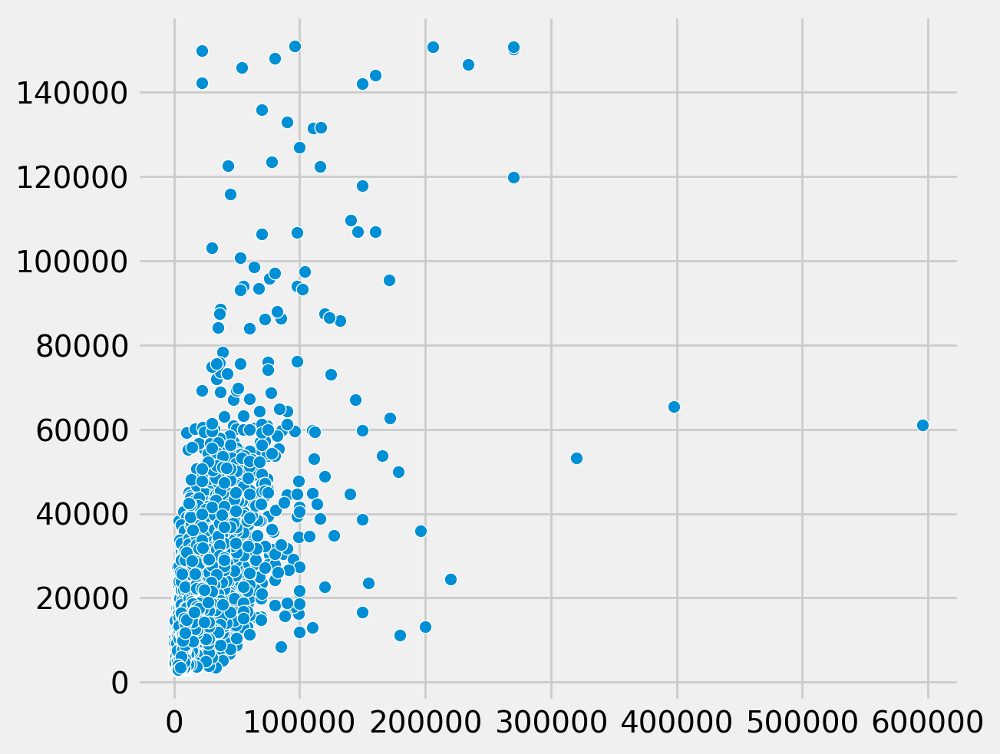

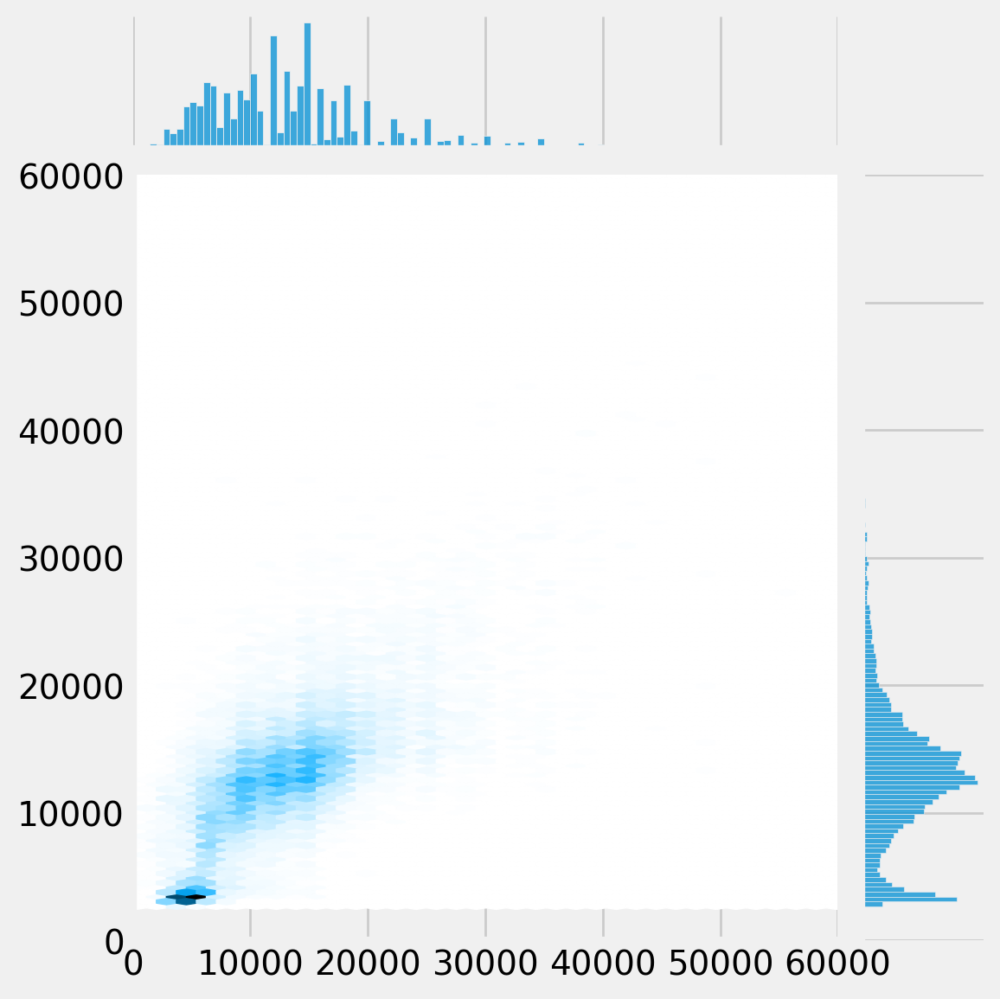

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


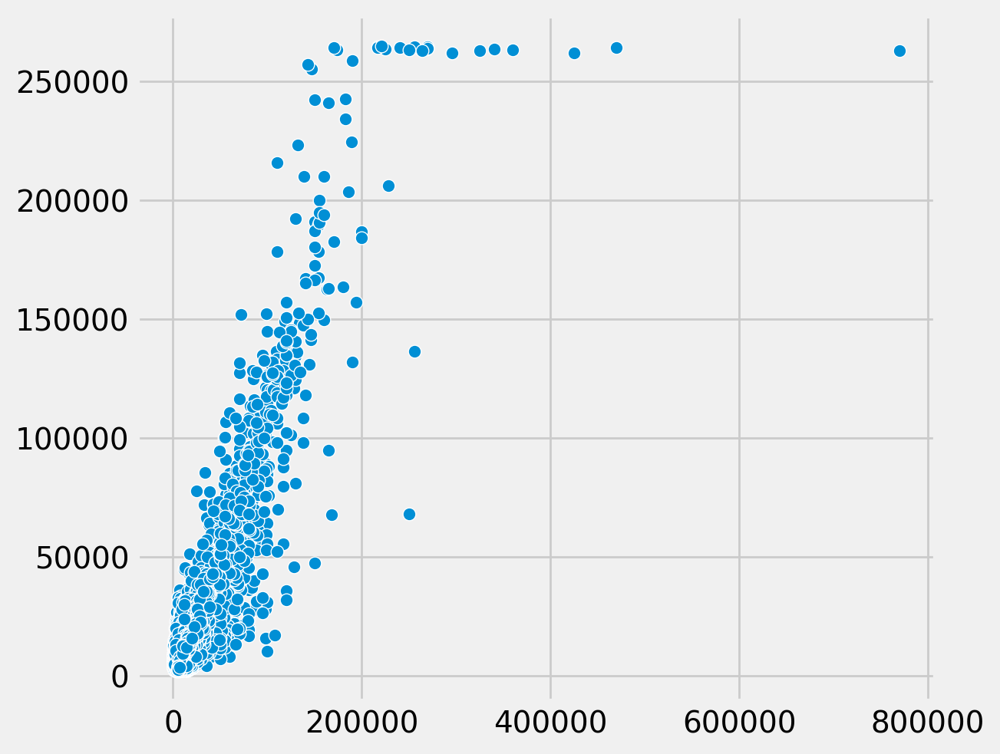

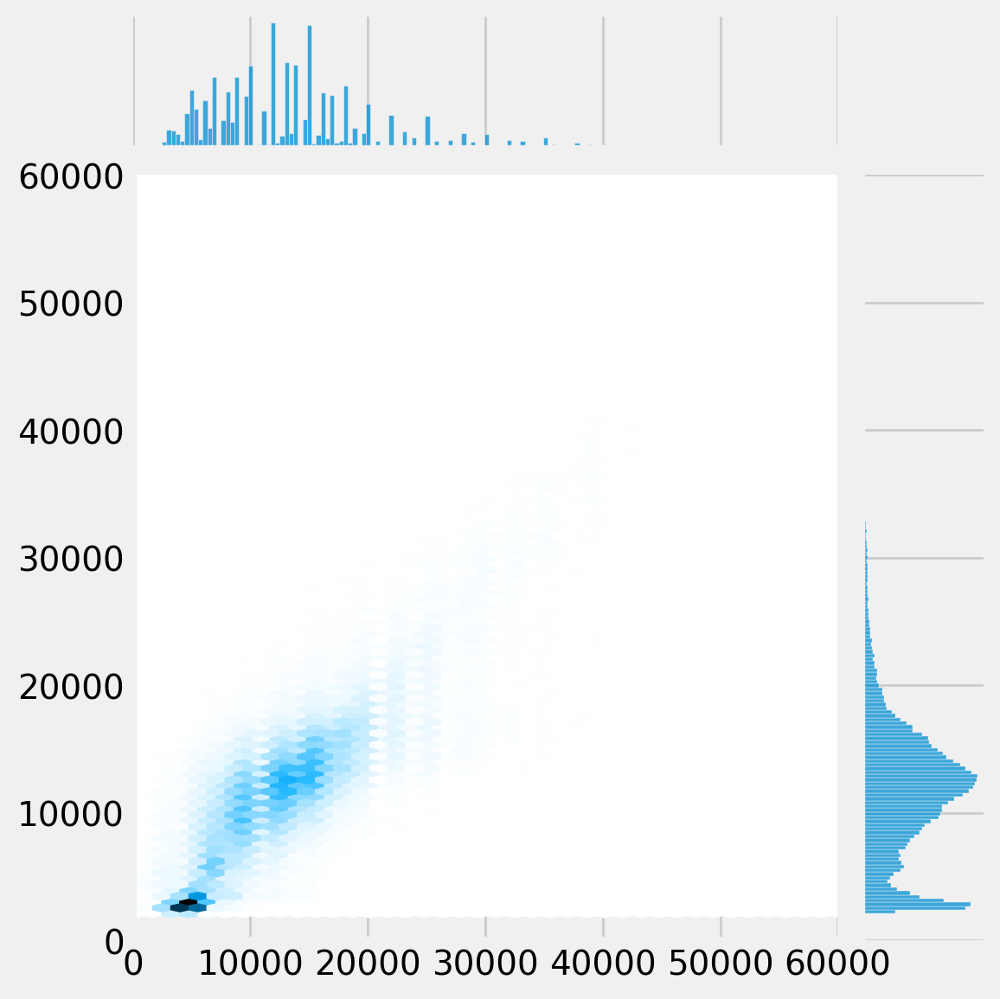

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


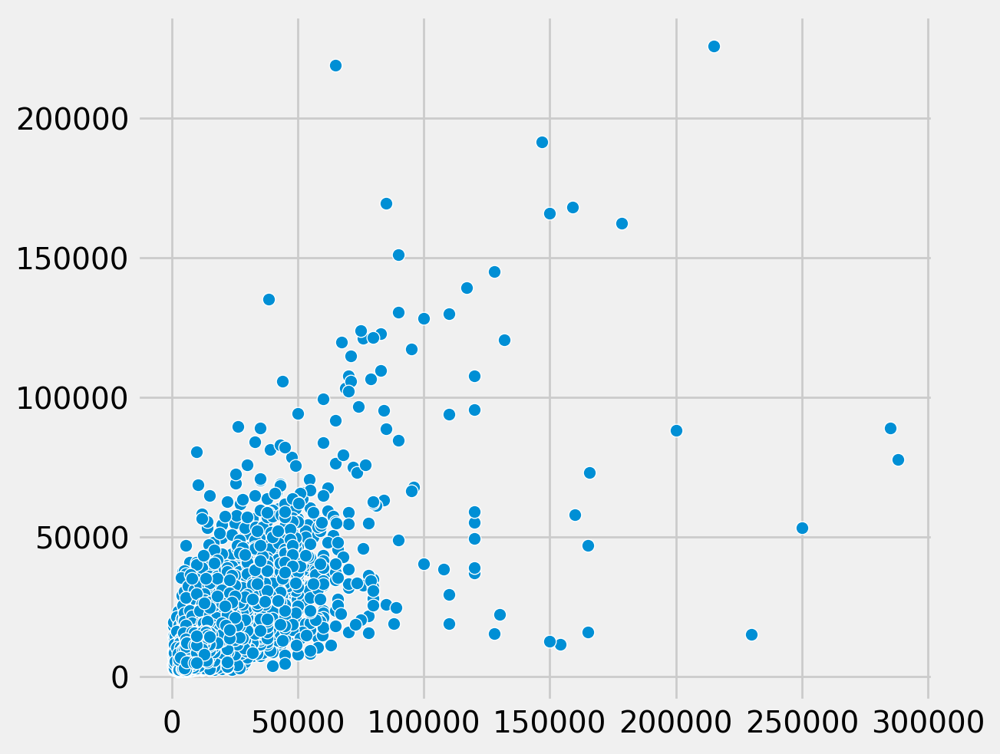

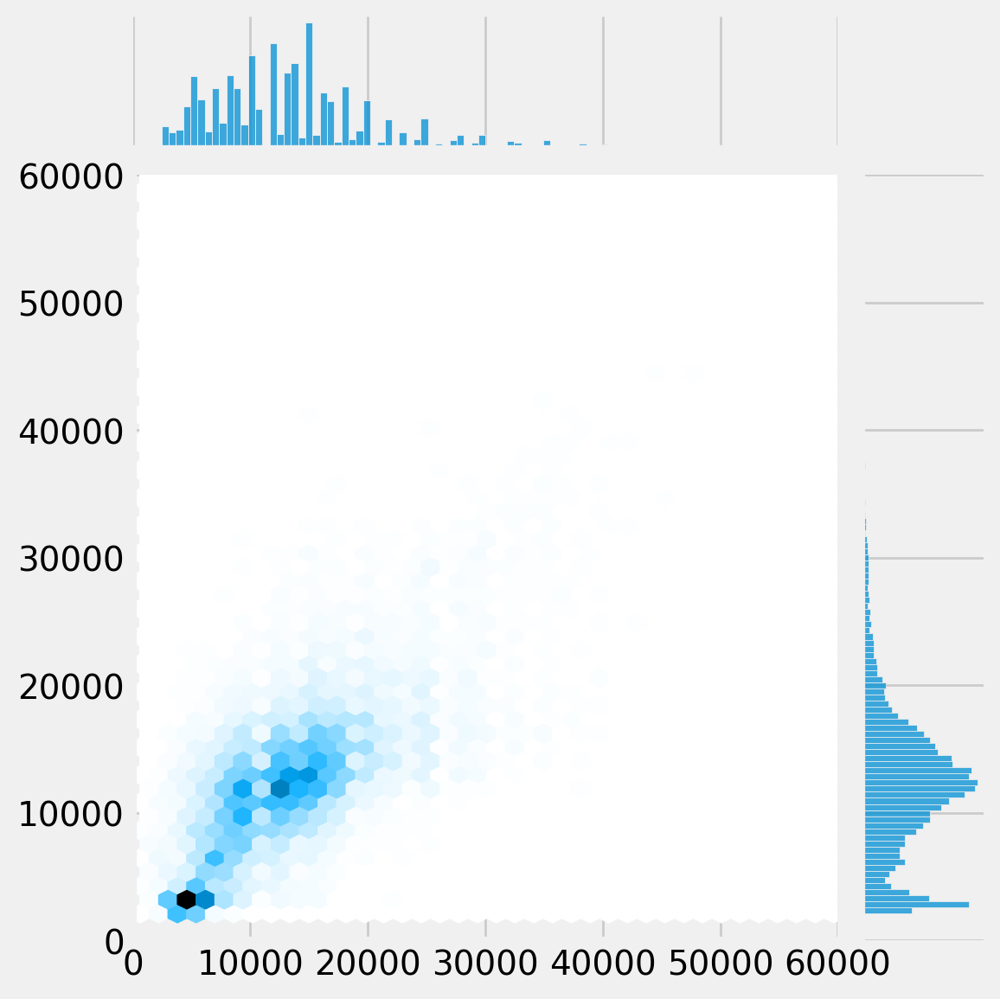

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


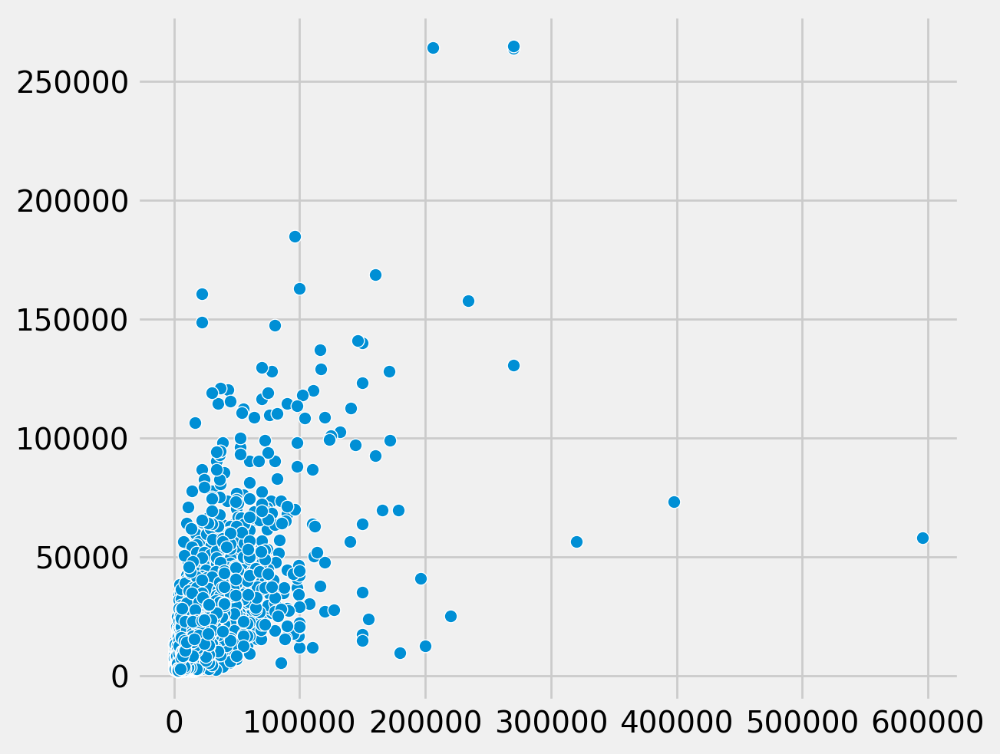

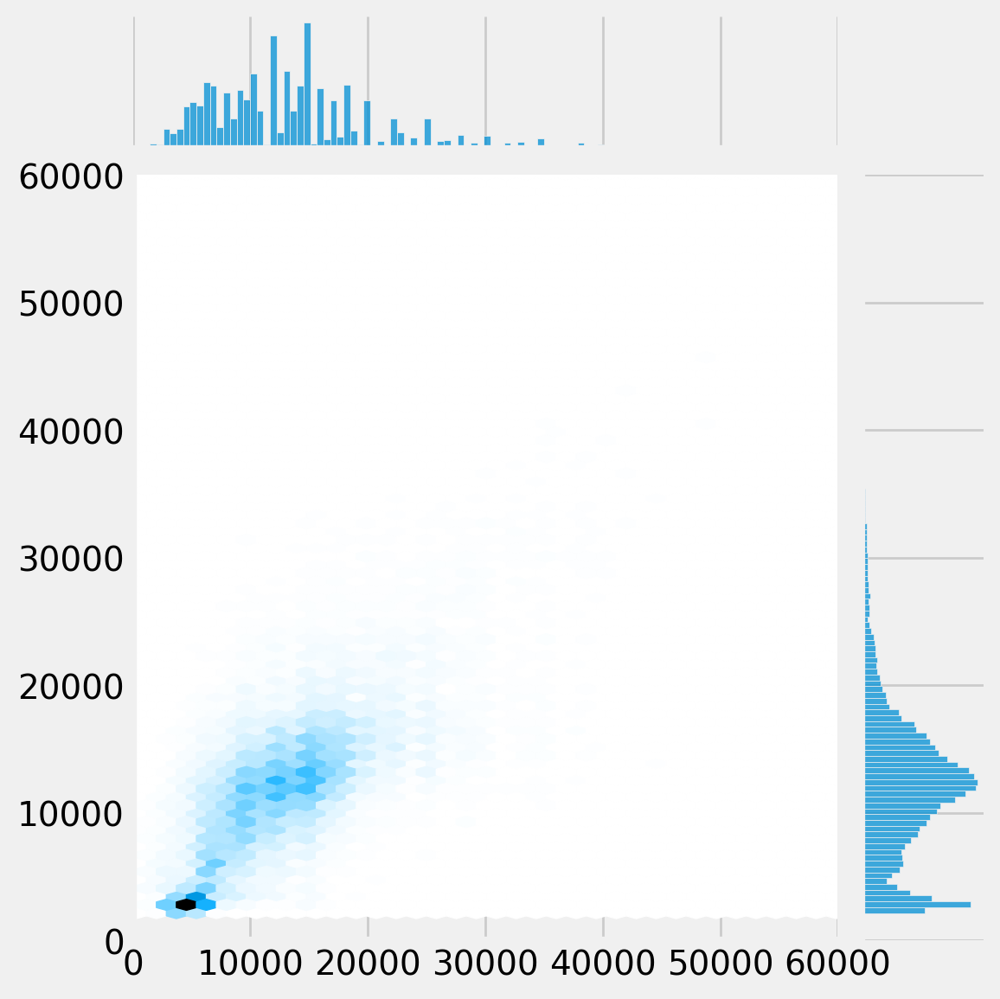

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

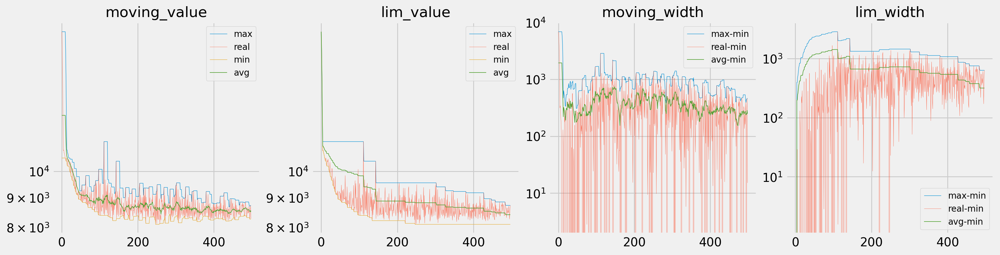

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

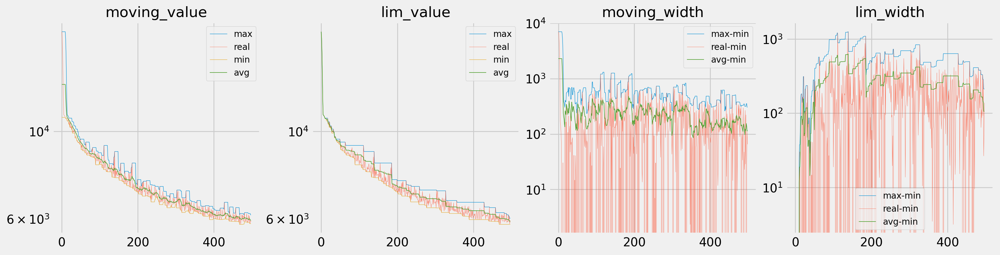

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

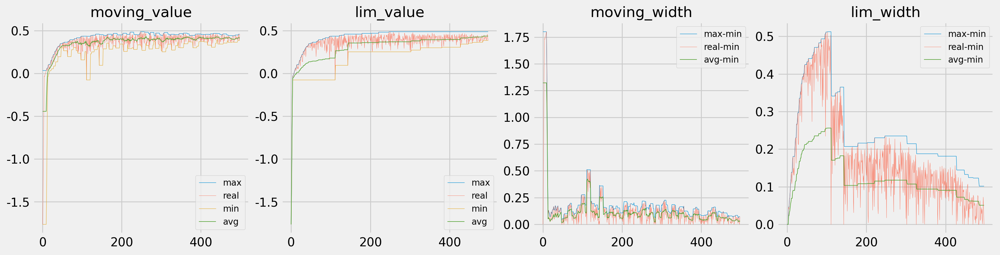

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 5

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(5)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

Epoch:     1		lr: 0.00008247
	Train Loss: 16041.199	Train Score: -2.855	Val Loss: 15946.197	Val Score: -2.849
Epoch:     2		lr: 0.00008247
	Train Loss: 15866.778	Train Score: -2.774	Val Loss: 15668.166	Val Score: -2.717
Epoch:     3		lr: 0.00008247
	Train Loss: 15529.277	Train Score: -2.618	Val Loss: 15204.042	Val Score: -2.500
Epoch:     4		lr: 0.00008247
	Train Loss: 15020.101	Train Score: -2.387	Val Loss: 14567.724	Val Score: -2.215
Epoch:     5		lr: 0.00008247
	Train Loss: 14351.619	Train Score: -2.094	Val Loss: 13772.713	Val Score: -1.875
Epoch:     6		lr: 0.00008247
	Train Loss: 13539.609	Train Score: -1.756	Val Loss: 12844.129	Val Score: -1.503
Epoch:     7		lr: 0.00008247
	Train Loss: 12603.100	Train Score: -1.390	Val Loss: 11802.895	Val Score: -1.116
Epoch:     8		lr: 0.00008247
	Train Loss: 11572.751	Train Score: -1.017	Val Loss: 10701.478	Val Score: -0.742
Epoch:     9		lr: 0.00008247
	Train Loss: 10499.588	Train Score: -0.661	Val Loss: 9616.320	Val Score: -0.410
Epoch:    1

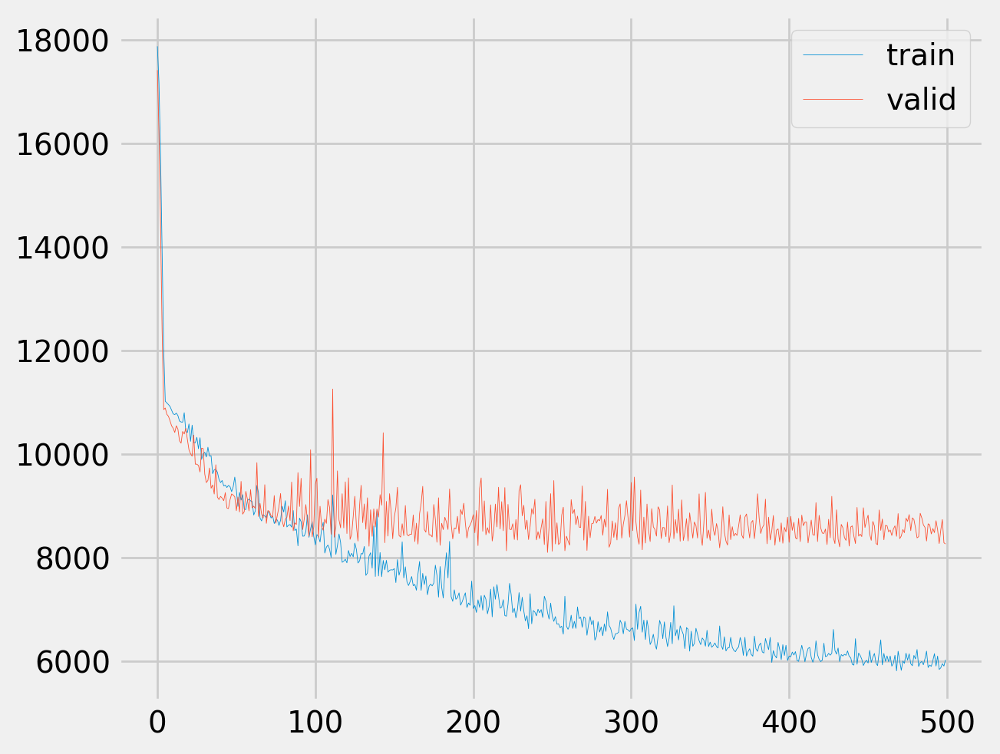

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-45-1790dcb0272c>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


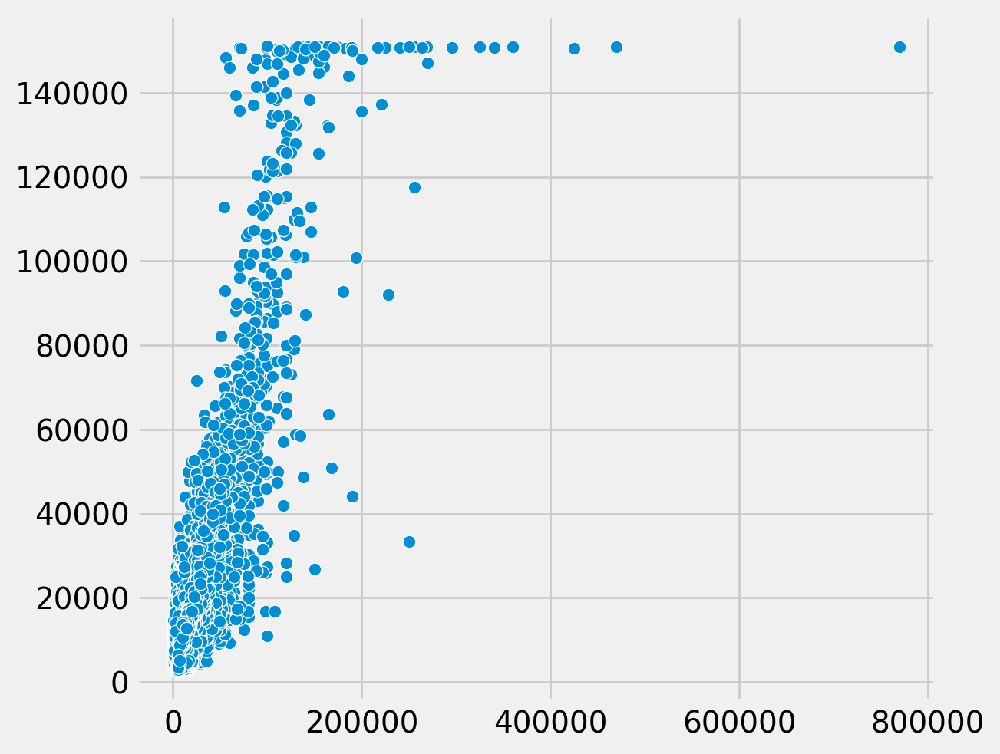

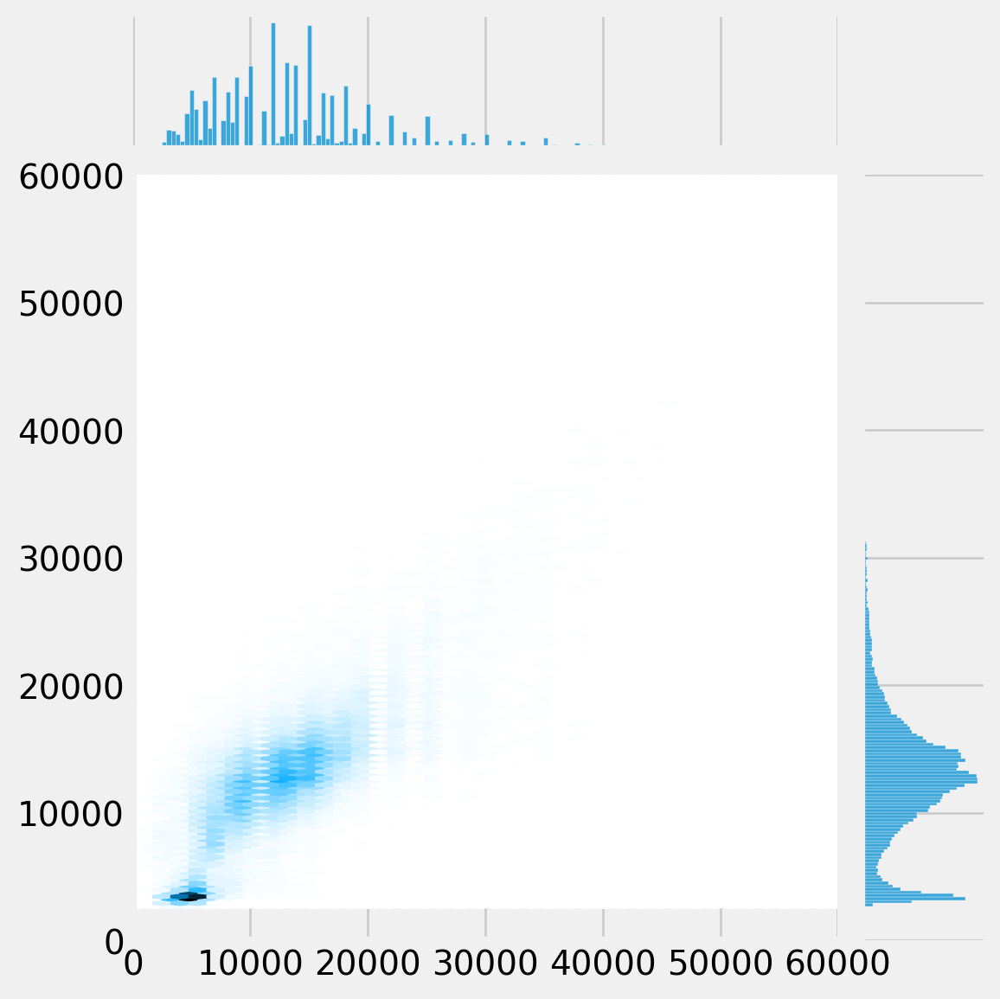

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


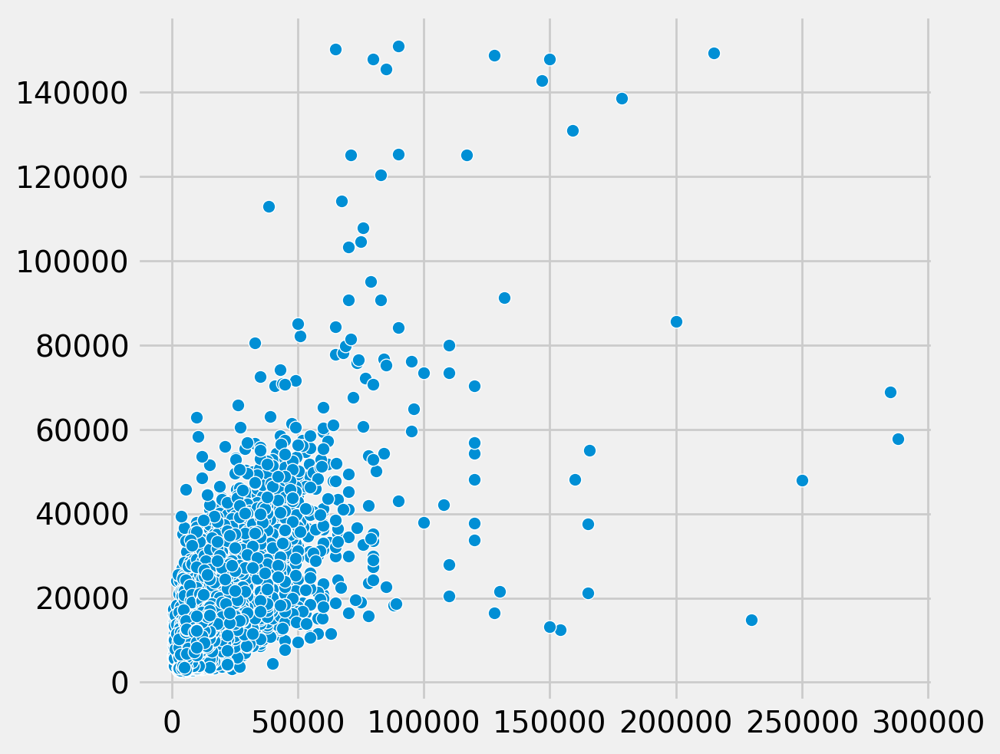

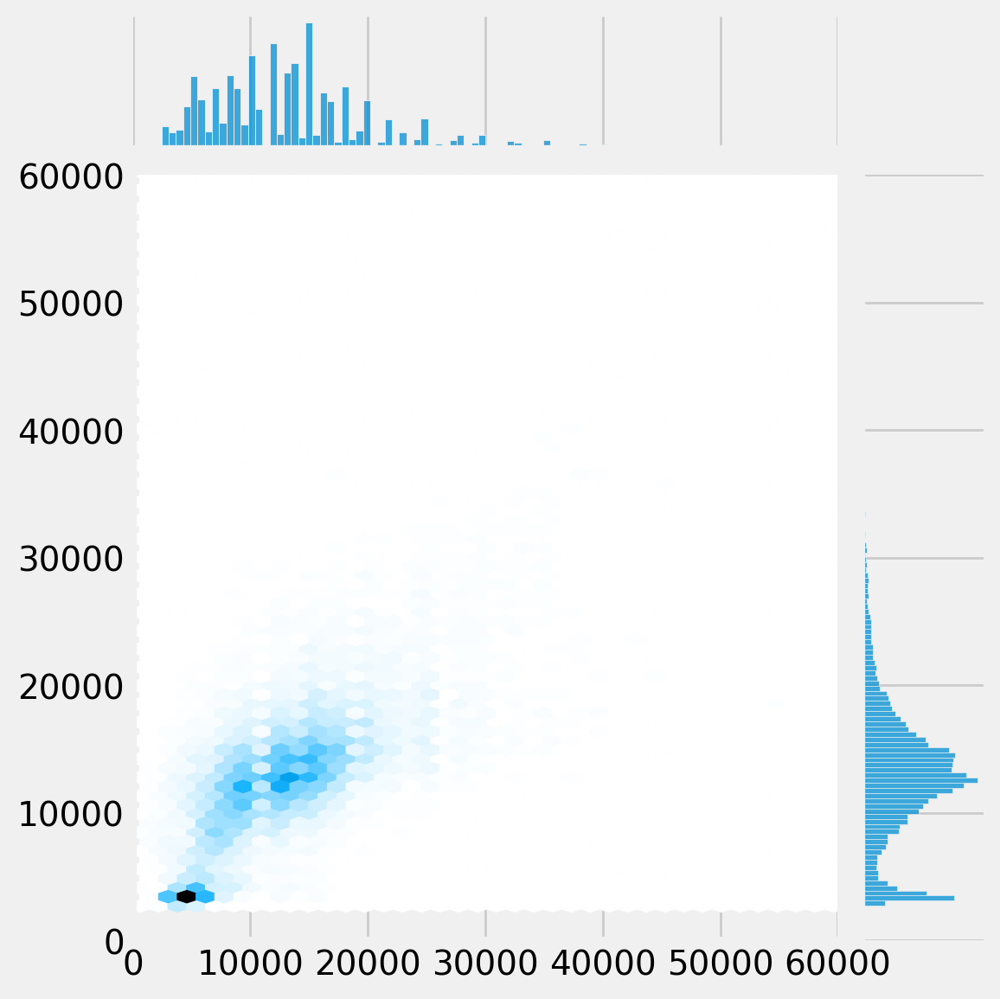

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


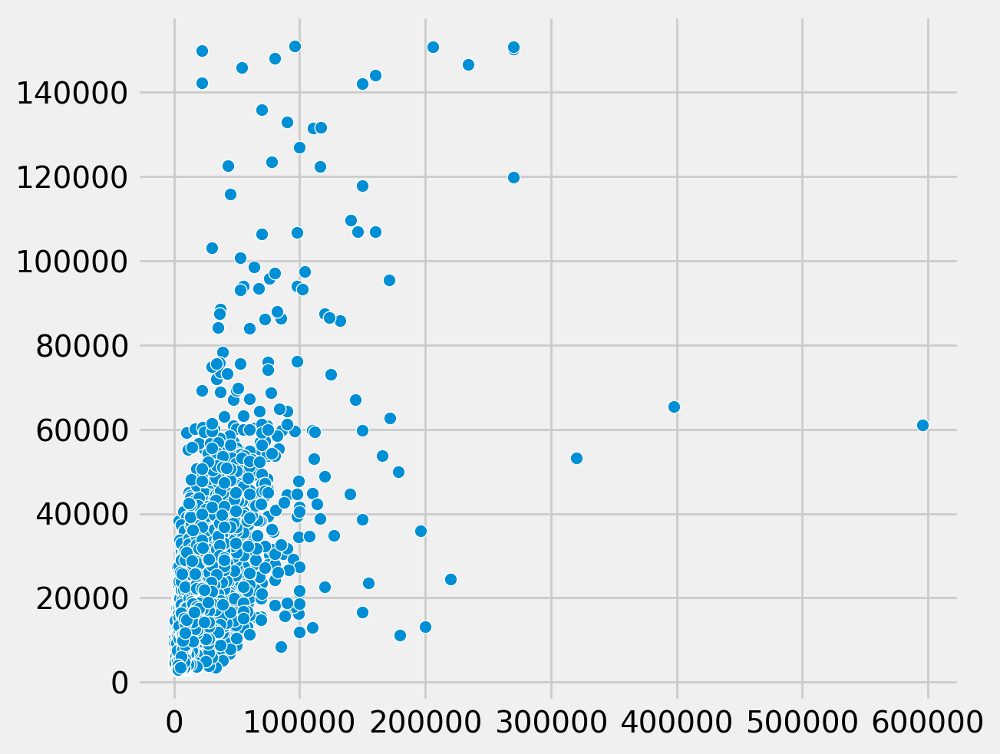

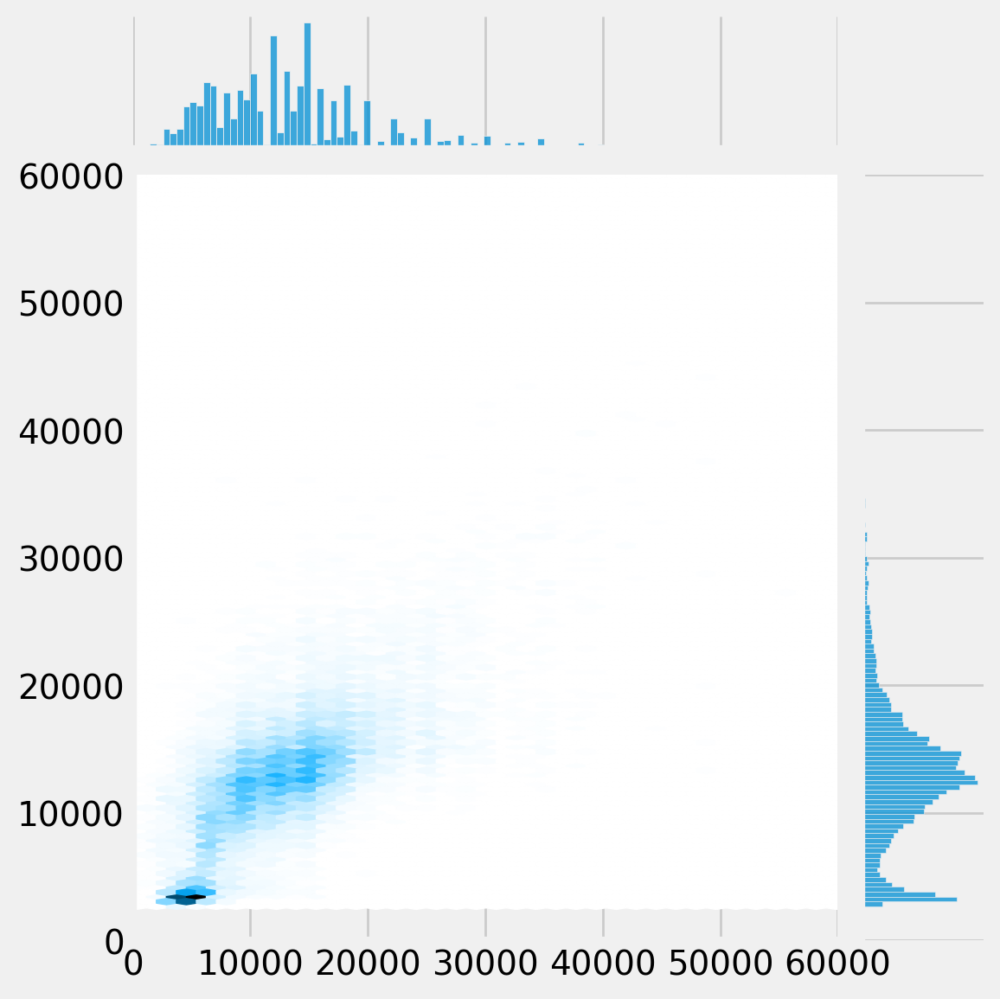

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


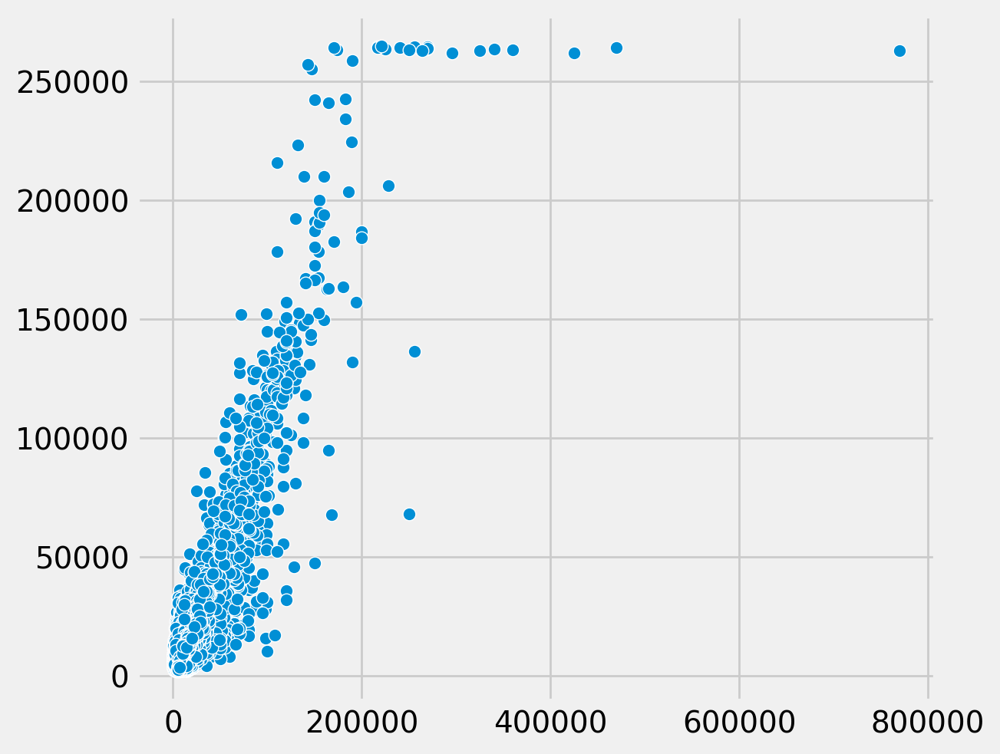

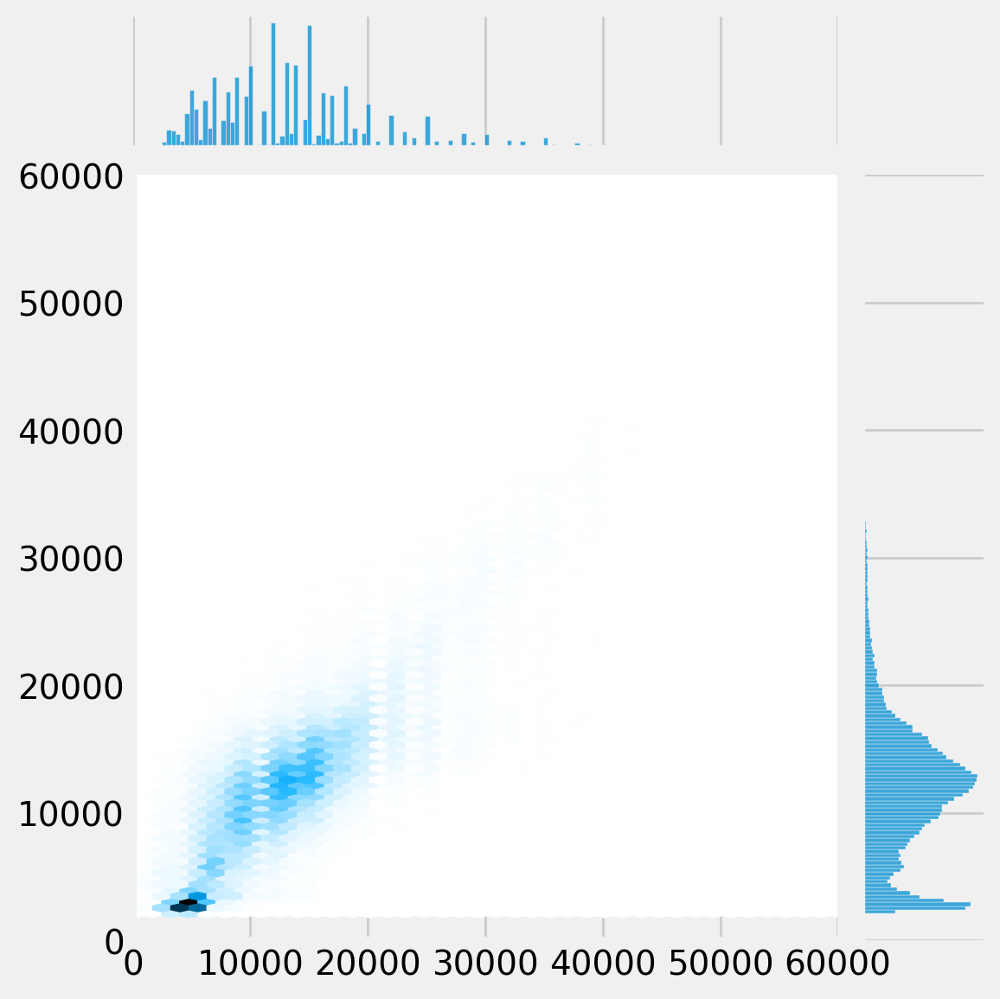

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


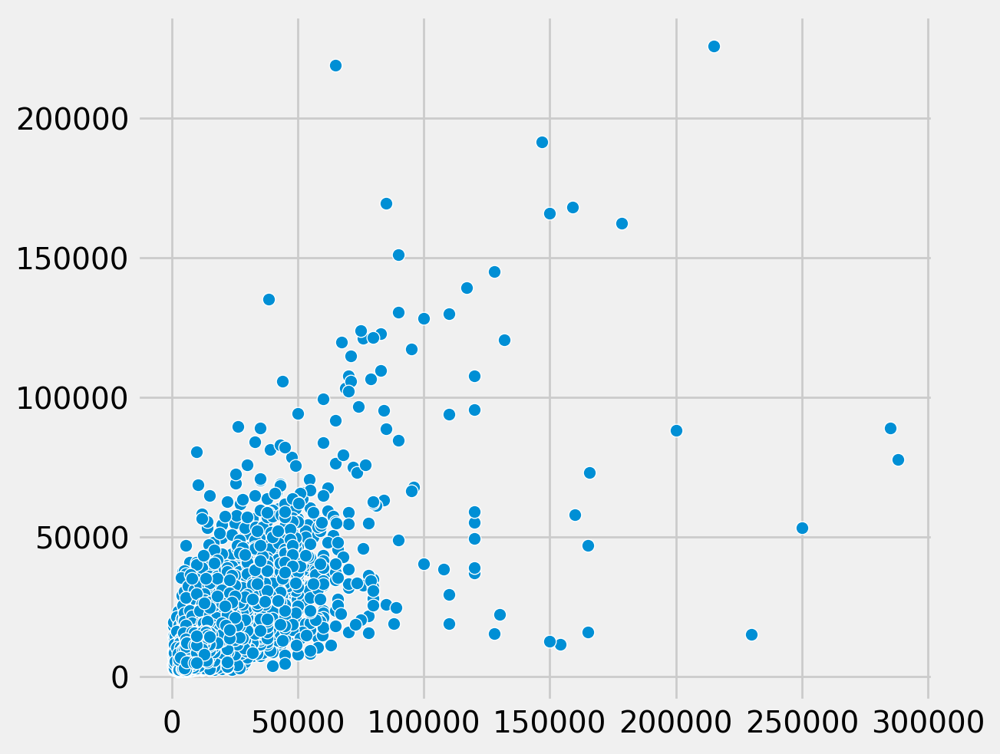

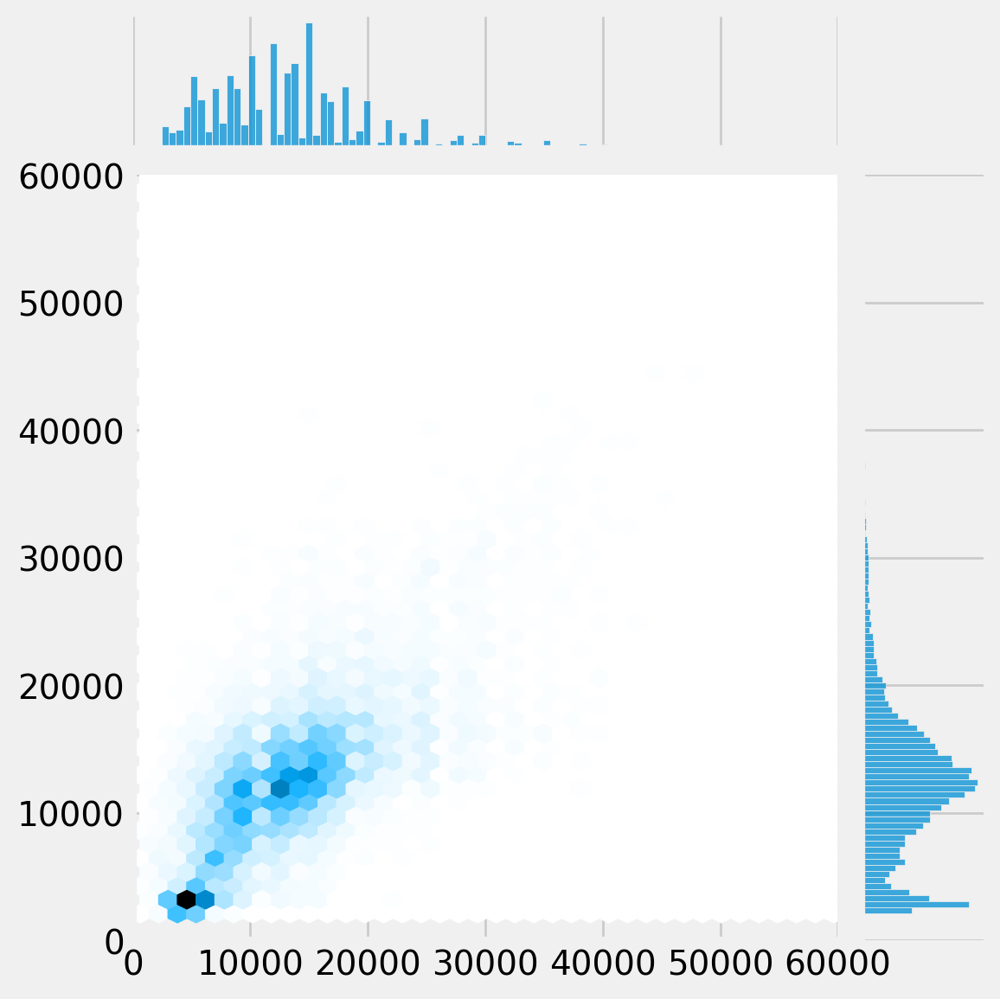

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


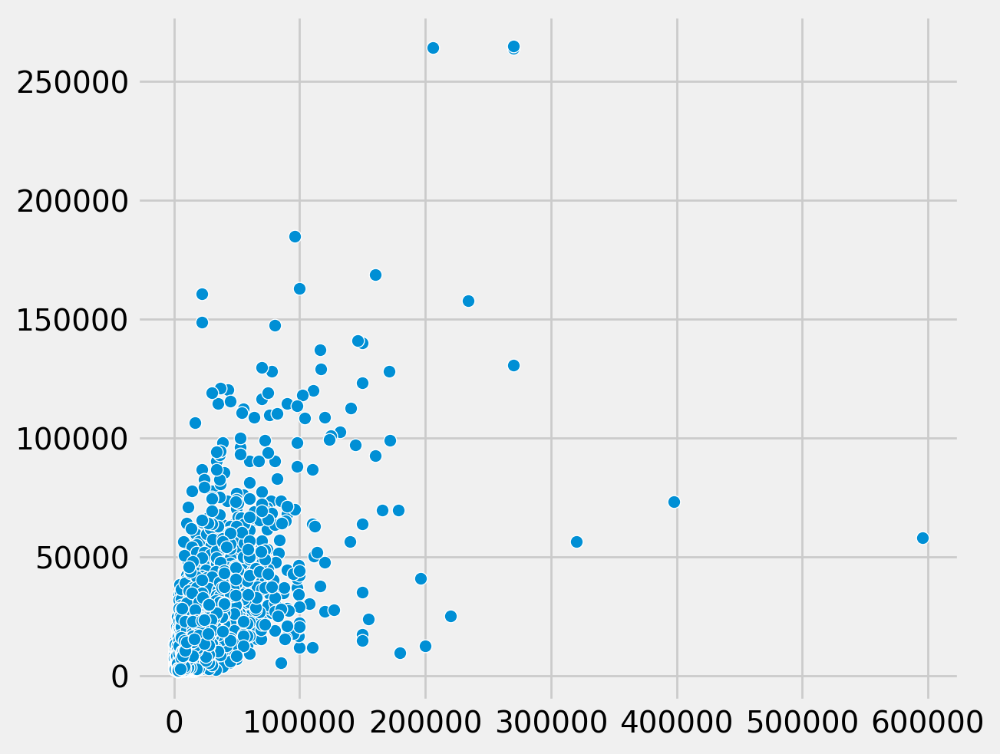

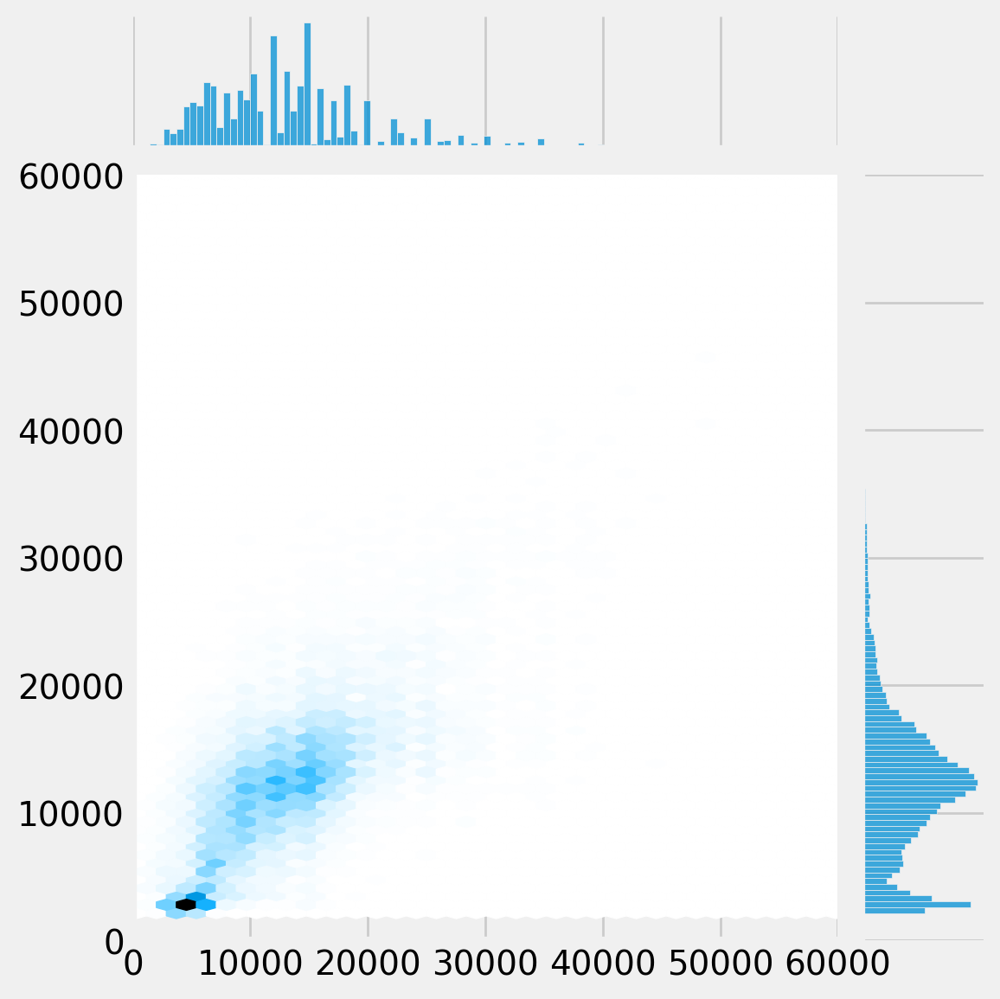

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

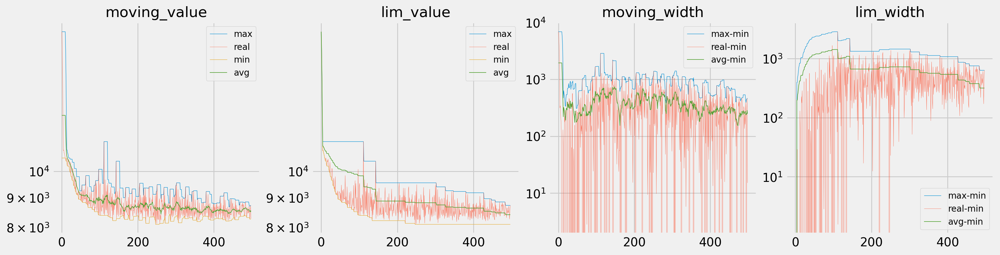

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

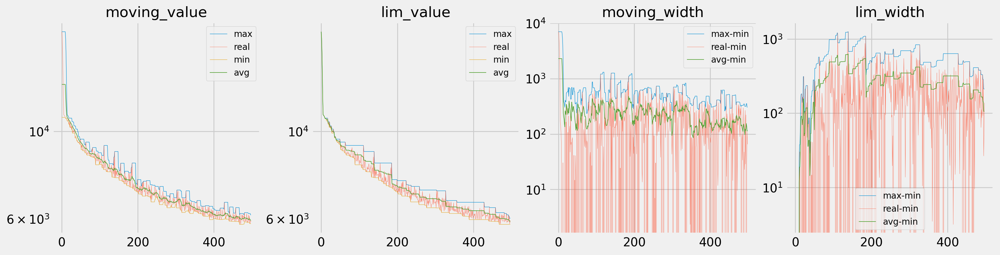

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

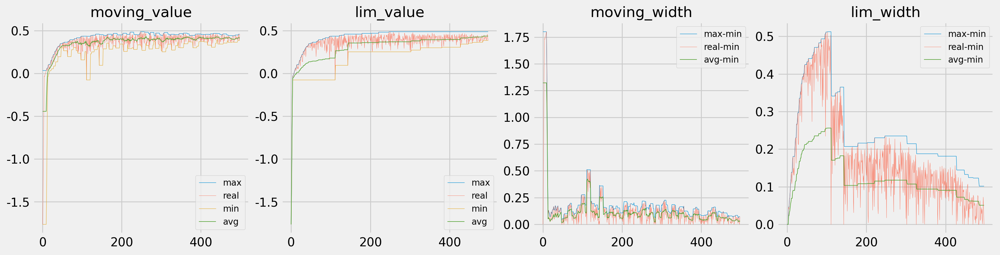

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);

# data box 6

# train, evaluate

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16028.539	Train Score: -2.850	Val Loss: 15907.730	Val Score: -2.831
Epoch:     2		lr: 0.00009245
	Train Loss: 15792.346	Train Score: -2.740	Val Loss: 15527.422	Val Score: -2.650
Epoch:     3		lr: 0.00009245
	Train Loss: 15332.240	Train Score: -2.528	Val Loss: 14912.197	Val Score: -2.368
Epoch:     4		lr: 0.00009245
	Train Loss: 14660.773	Train Score: -2.229	Val Loss: 14094.904	Val Score: -2.011
Epoch:     5		lr: 0.00009245
	Train Loss: 13808.672	Train Score: -1.867	Val Loss: 13108.078	Val Score: -1.606
Epoch:     6		lr: 0.00009245
	Train Loss: 12806.008	Train Score: -1.468	Val Loss: 11990.887	Val Score: -1.183
Epoch:     7		lr: 0.00009245
	Train Loss: 11693.129	Train Score: -1.060	Val Loss: 10795.863	Val Score: -0.773
Epoch:     8		lr: 0.00009245
	Train Loss: 10530.860	Train Score: -0.672	Val Loss: 9621.622	Val Score: -0.412
Epoch:     9		lr: 0.00009245
	Train Loss: 9422.528	Train Score: -0.338	Val 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
init_lr *=(406/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16033.056	Train Score: -2.852	Val Loss: 15924.306	Val Score: -2.838
Epoch:     2		lr: 0.00009245
	Train Loss: 15818.267	Train Score: -2.752	Val Loss: 15570.205	Val Score: -2.670
Epoch:     3		lr: 0.00009245
	Train Loss: 15383.872	Train Score: -2.552	Val Loss: 14970.146	Val Score: -2.394
Epoch:     4		lr: 0.00009245
	Train Loss: 14724.848	Train Score: -2.257	Val Loss: 14143.830	Val Score: -2.031
Epoch:     5		lr: 0.00009245
	Train Loss: 13862.448	Train Score: -1.890	Val Loss: 13124.092	Val Score: -1.612
Epoch:     6		lr: 0.00009245
	Train Loss: 12826.636	Train Score: -1.477	Val Loss: 11947.307	Val Score: -1.168
Epoch:     7		lr: 0.00009245
	Train Loss: 11655.535	Train Score: -1.047	Val Loss: 10679.832	Val Score: -0.735
Epoch:     8		lr: 0.00009245
	Train Loss: 10425.184	Train Score: -0.639	Val Loss: 9446.210	Val Score: -0.361
Epoch:     9		lr: 0.00009245
	Train Loss: 9263.572	Train Score: -0.294	Val 

In [ ]:
model, train_config, init_lr,save_dir,file_name = box_expt_config(6)
init_lr *=(best_epoch/450)*(406/450)
model,train_loss,val_loss,train_score,val_score,best_epoch = run(model,train_config,iter_dict_box[1]['trn'],iter_dict_box[1]['vld'],epoch,warmup,8500,save_dir,file_name[:-3])
torch.save(model,os.path.join(save_dir,file_name))
save_pkl(save_dir,'train_loss.pkl',train_loss)
save_pkl(save_dir,'valid_loss.pkl',val_loss)
save_pkl(save_dir,'valid_score.pkl',val_score)

The model has 11,852,587 trainable parameters
Epoch:     1		lr: 0.00009245
	Train Loss: 16035.993	Train Score: -2.853	Val Loss: 15925.611	Val Score: -2.839
Epoch:     2		lr: 0.00009245
	Train Loss: 15818.309	Train Score: -2.752	Val Loss: 15564.046	Val Score: -2.667
Epoch:     3		lr: 0.00009245
	Train Loss: 15366.496	Train Score: -2.544	Val Loss: 14942.699	Val Score: -2.382
Epoch:     4		lr: 0.00009245
	Train Loss: 14679.490	Train Score: -2.237	Val Loss: 14090.675	Val Score: -2.009
Epoch:     5		lr: 0.00009245
	Train Loss: 13785.349	Train Score: -1.858	Val Loss: 13048.666	Val Score: -1.582
Epoch:     6		lr: 0.00009245
	Train Loss: 12719.556	Train Score: -1.436	Val Loss: 11853.793	Val Score: -1.134
Epoch:     7		lr: 0.00009245
	Train Loss: 11531.625	Train Score: -1.004	Val Loss: 10583.800	Val Score: -0.704
Epoch:     8		lr: 0.00009245
	Train Loss: 10298.075	Train Score: -0.599	Val Loss: 9359.549	Val Score: -0.337
Epoch:     9		lr: 0.00009245
	Train Loss: 9161.084	Train Score: -0.265	Val 

In [ ]:
ls {save_dir}/../

model4.1_1024_500_N6/              model4.5_512_1000_N3_0.2lr/
model4_16384_1000_N9/              model4.5_512_1000_N6_0.2lr/
model4.1_8192_500_N6/              model4.5_512_1000_N9_0.2lr/
model4_256_1000_N9/                model4.5_512_100_N3/
model4_512_1000/                   model4.5_512_450_N1/
model4_512_1500/                   model4.5_512_450_N3/
model4.5_16384_150_N1/             model4.5_512_450_N6/
model4.5_16384_150_N3/             model4.5_65536_450_N1/
model4.5_16384_150_N6/             model4.5_8192_150_N1/
model4.5_16384_300_N6/             model4.5_8192_200_N9/
model4.5_16384_450_N1/             model4.5_8192_450_N1/
model4.5_16384_500_N6/             model4.5_8192_450_N12/
model4.5_16384_500_N6_lr0.000045/  model4.5_8192_450_N3/
model4.5_16384_500_N6_lr0.000082/  model4.5_8192_450_N6/
model4.5_16384_500_N6_lr0.000087/  model4.5_8192_450_N9/
model4.5_16384_500_N6_lr0.000094/  model4.5_8192_500_N6/
model4.5_16384_500_N6_lr0.000167/  model4.5_8192_500_N6_lr0.00003/
model

In [ ]:
_, train_config, init_lr,save_dir,file_name = box_expt_config(6)

The model has 11,852,587 trainable parameters


/content/drive/MyDrive/kdt-EST-AI/project/project2/module_aladin/torch_train.py:164: FutureWarning: `nn.init.kaiming_uniform` is now deprecated in favor of `nn.init.kaiming_uniform_`.
  nn.init.kaiming_uniform(m.weight.data)
/usr/local/lib/python3.10/dist-packages/torch/optim/lr_scheduler.py:62: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn(


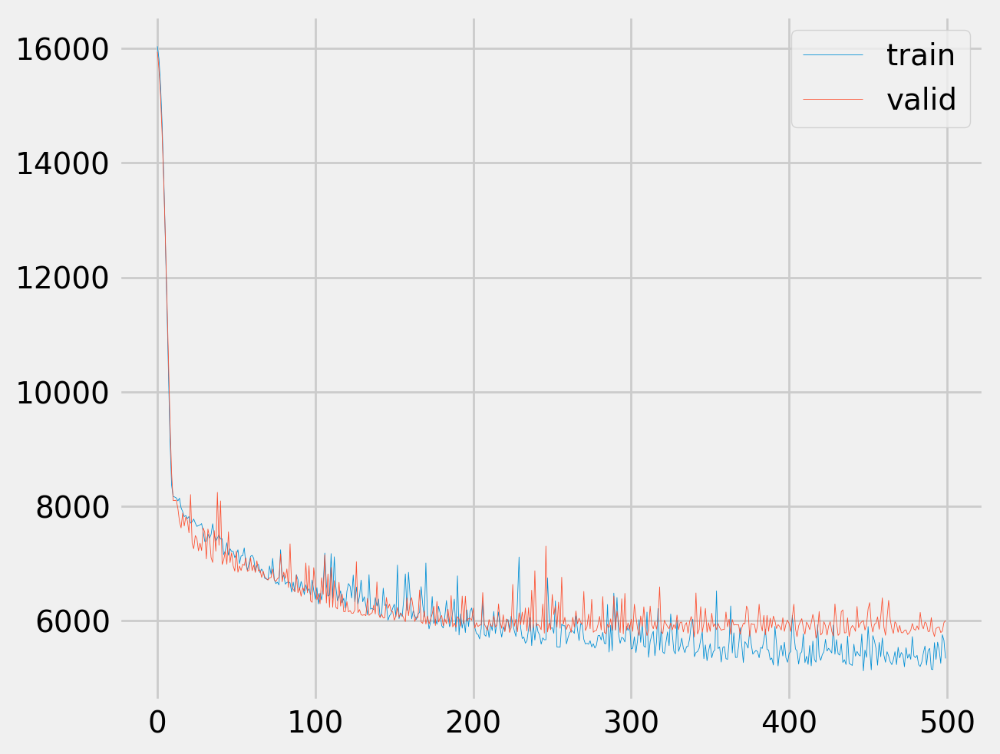

In [ ]:
train_loss = load_pkl(os.path.join(save_dir,'train_loss.pkl'))
valid_loss = load_pkl(os.path.join(save_dir,'valid_loss.pkl'))
valid_score = load_pkl(os.path.join(save_dir,'valid_score.pkl'))

loss_train = np.array(train_loss)
loss_valid = np.array(val_loss)

fig, ax = plt.subplots()

ax.plot(range(len(loss_train)),loss_train,label='train',lw=0.3)
ax.plot(range(len(loss_valid)),loss_valid,label='valid',lw=0.3)
#ax.set_yscale('log')
ax.legend();

In [ ]:
best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))
criterion = train_config[-2]

<ipython-input-73-a000df0fdf5f>:1: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  best_model = torch.load(os.path.join(save_dir,f'best_{file_name}'))


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


6079.8402813029425 	r2 :  0.6872004866600037 	mape :  0.31050563


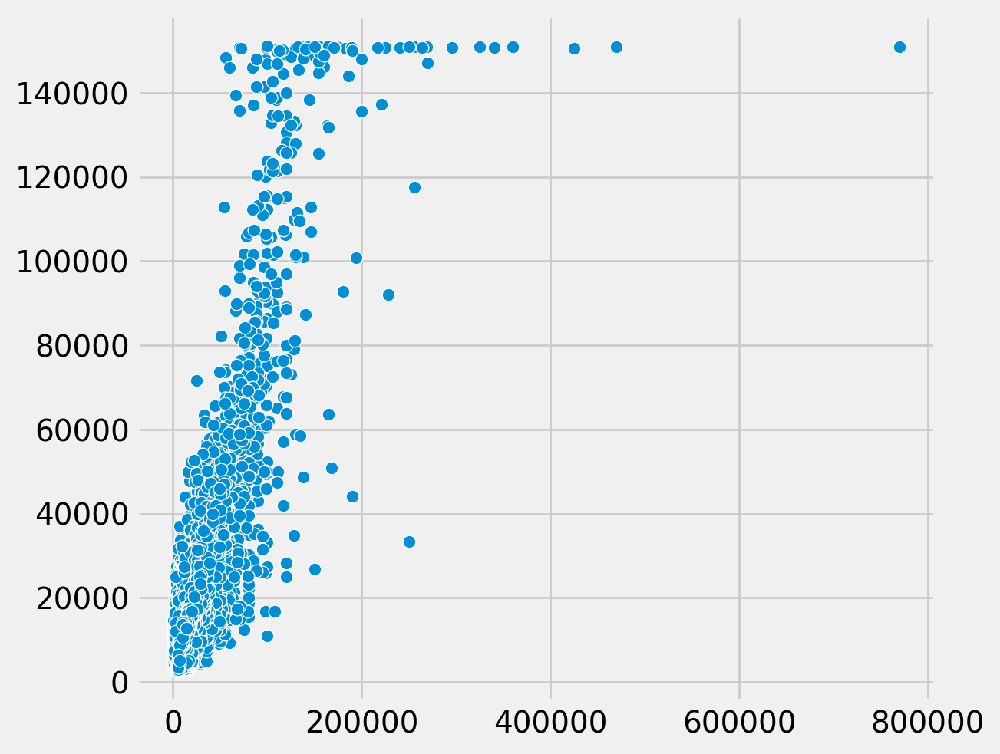

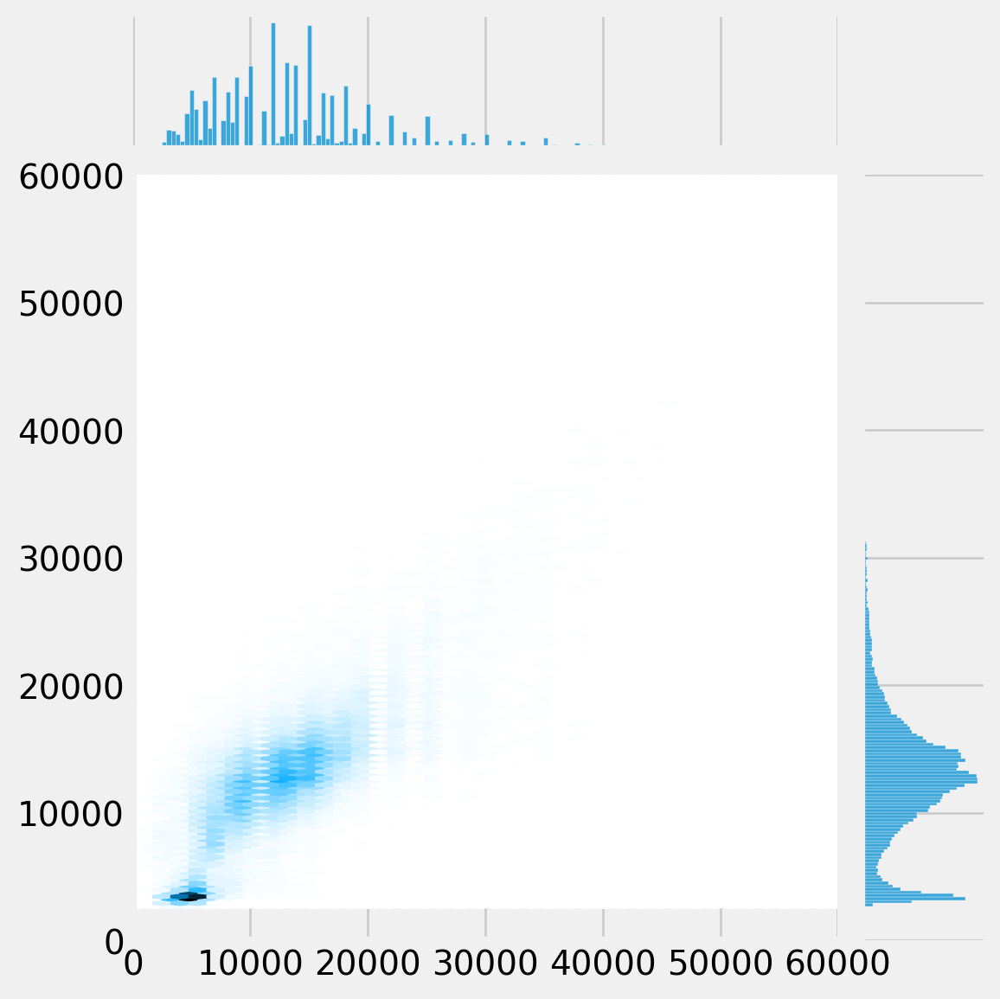

In [ ]:
test_n_plot(best_model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(best_model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8099.6480787747805 	r2 :  0.48702794313430786 	mape :  0.3616164


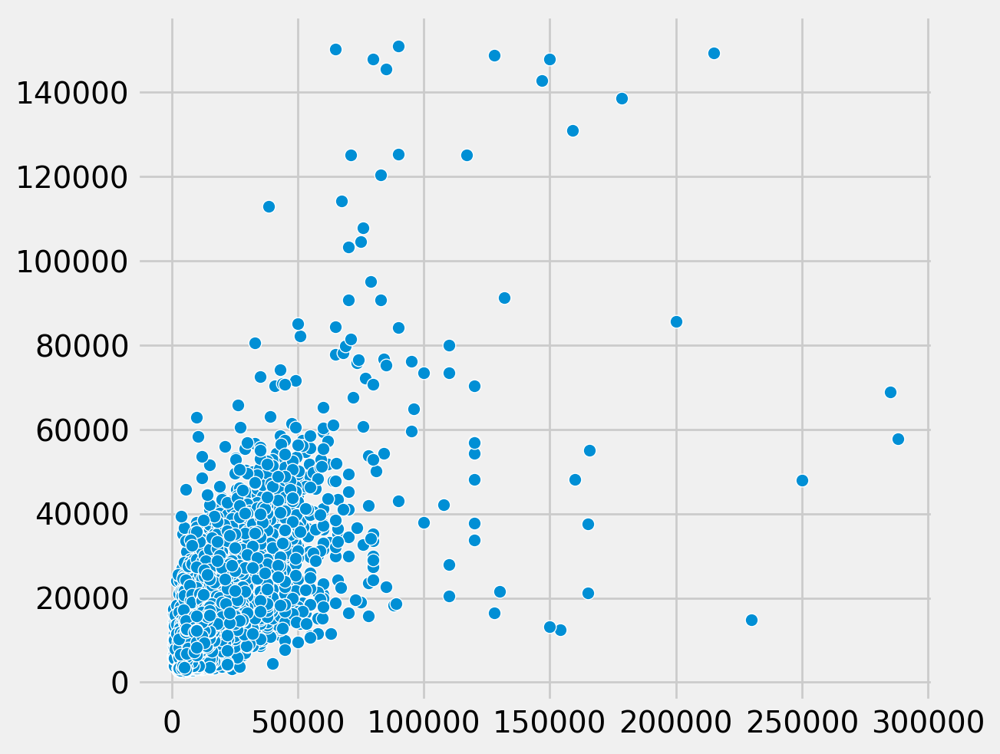

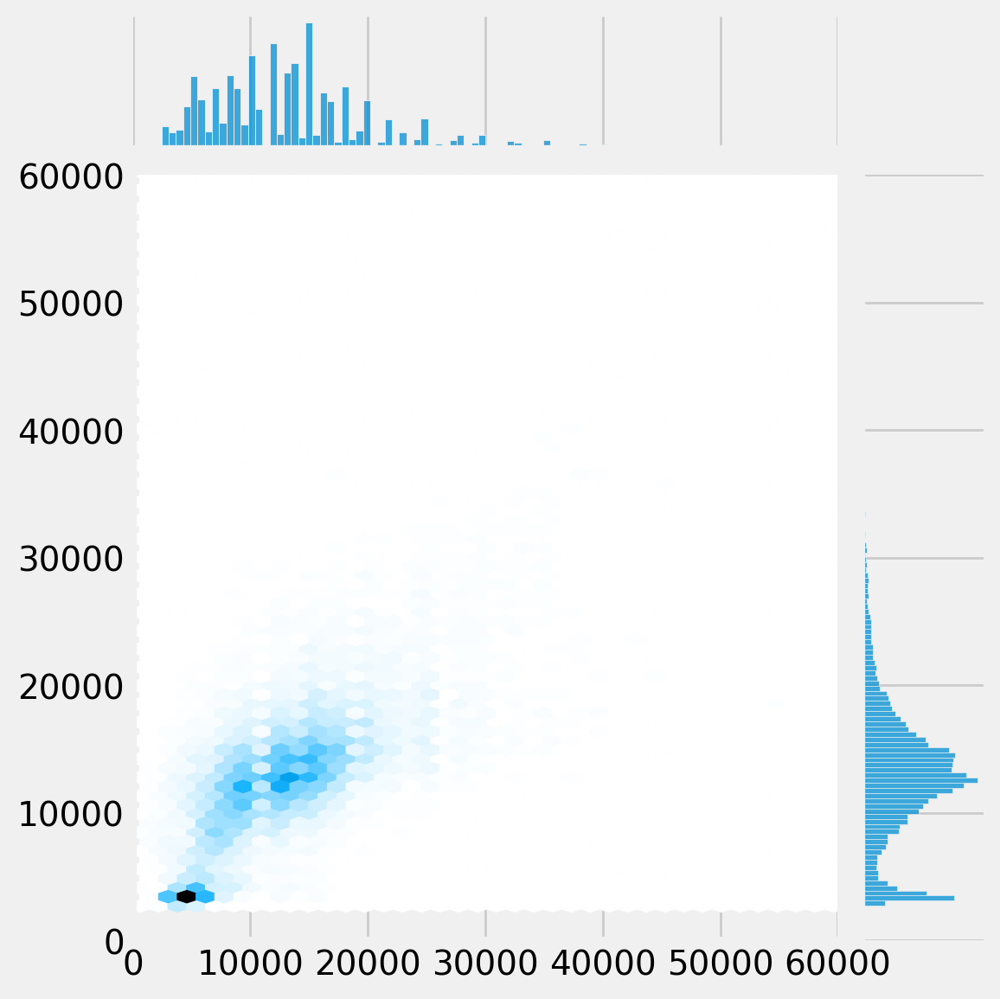

In [ ]:
test_n_plot(best_model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(best_model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180) #gridsize 180

8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8483.909829789565 	r2 :  0.4573727250099182 	mape :  0.3639279


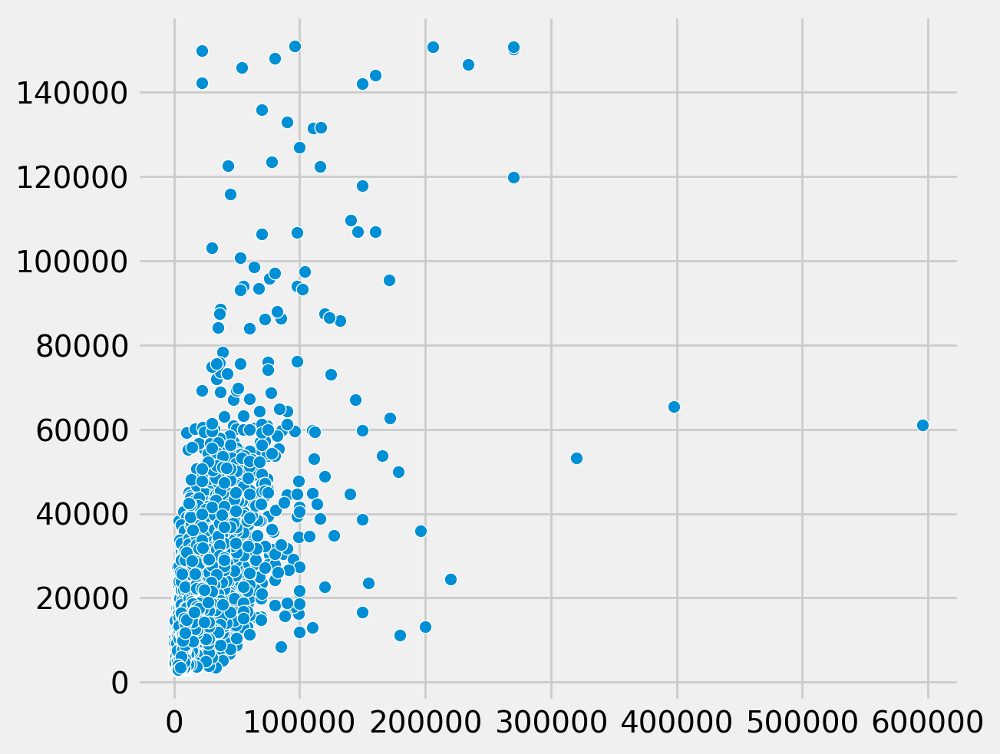

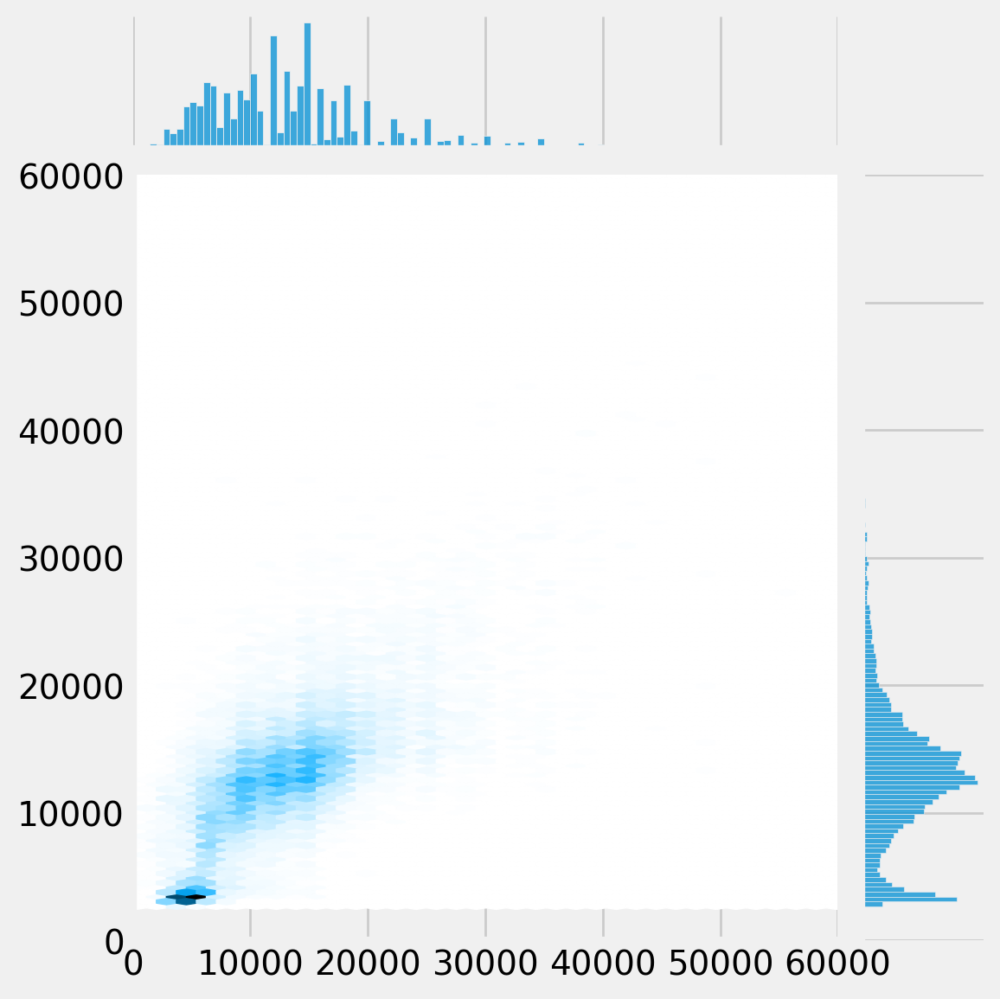

In [ ]:
test_n_plot(best_model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(best_model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


5421.616094572086 	r2 :  0.7526980638504028 	mape :  0.28877568


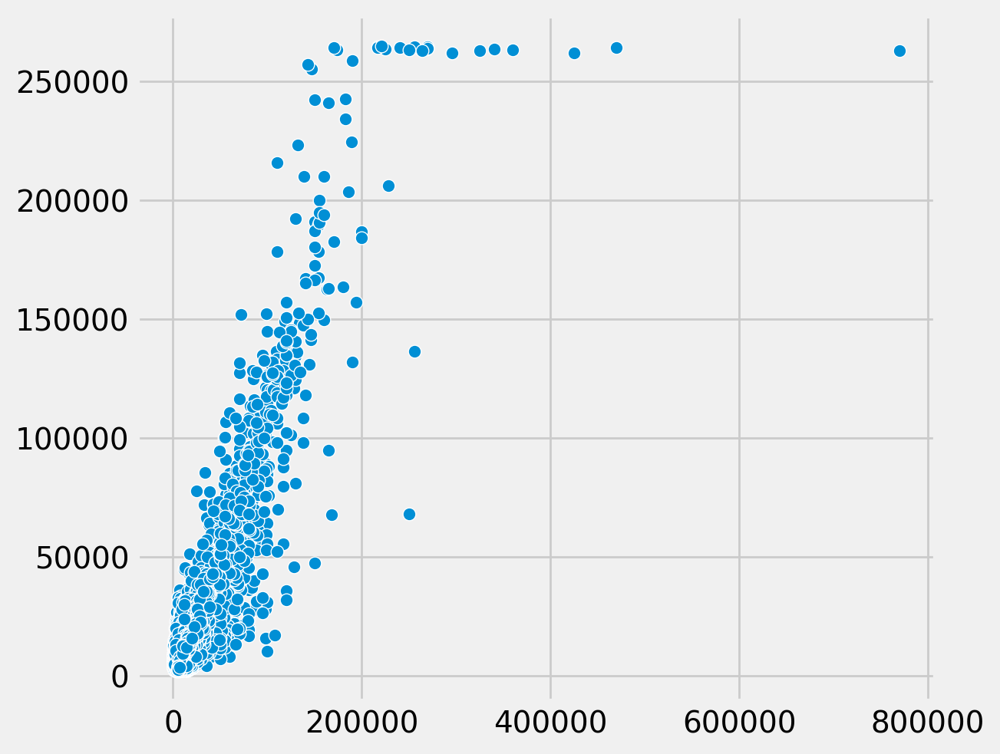

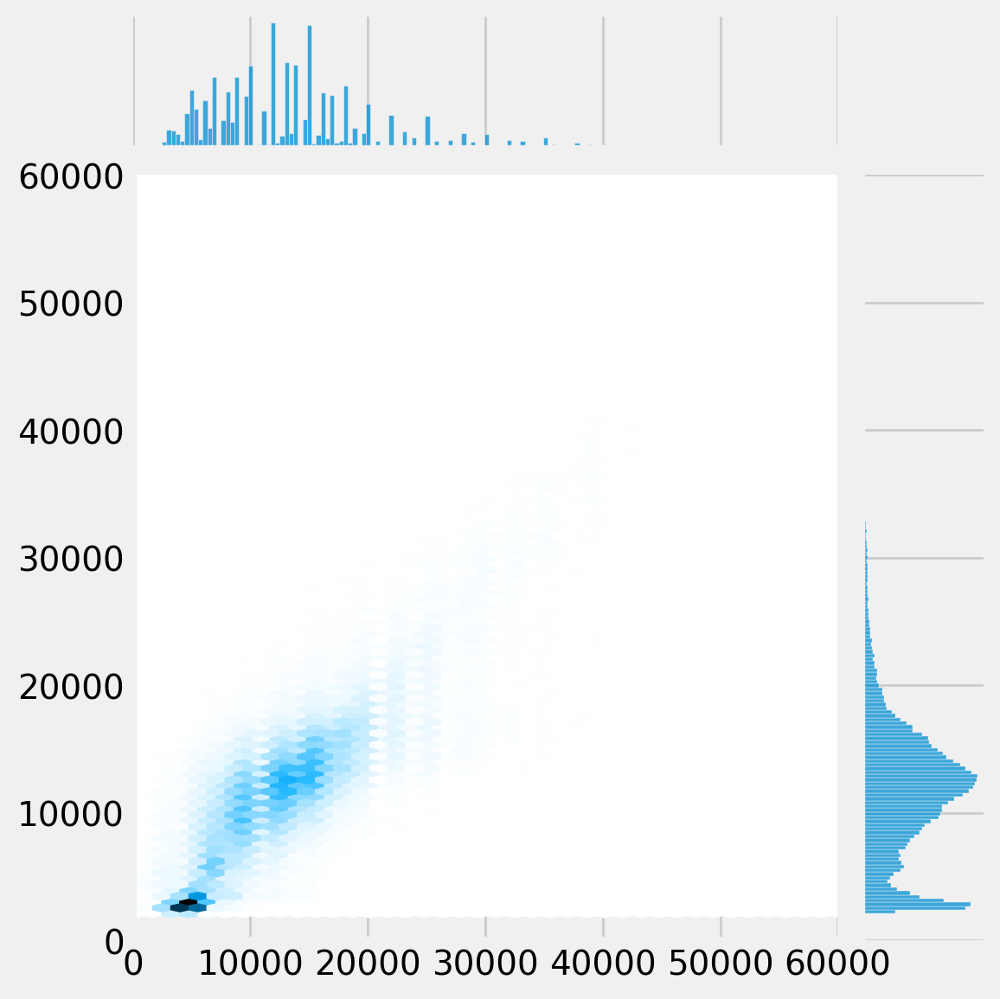

In [ ]:
test_n_plot(model,iter_dict['trn'],criterion,device) #gridsize 500
test_n_plot(model,iter_dict['trn'],criterion,device,scatter=False,gridsize=500) #gridsize 500

8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8262.704762969568 	r2 :  0.4583730101585388 	mape :  0.35924602


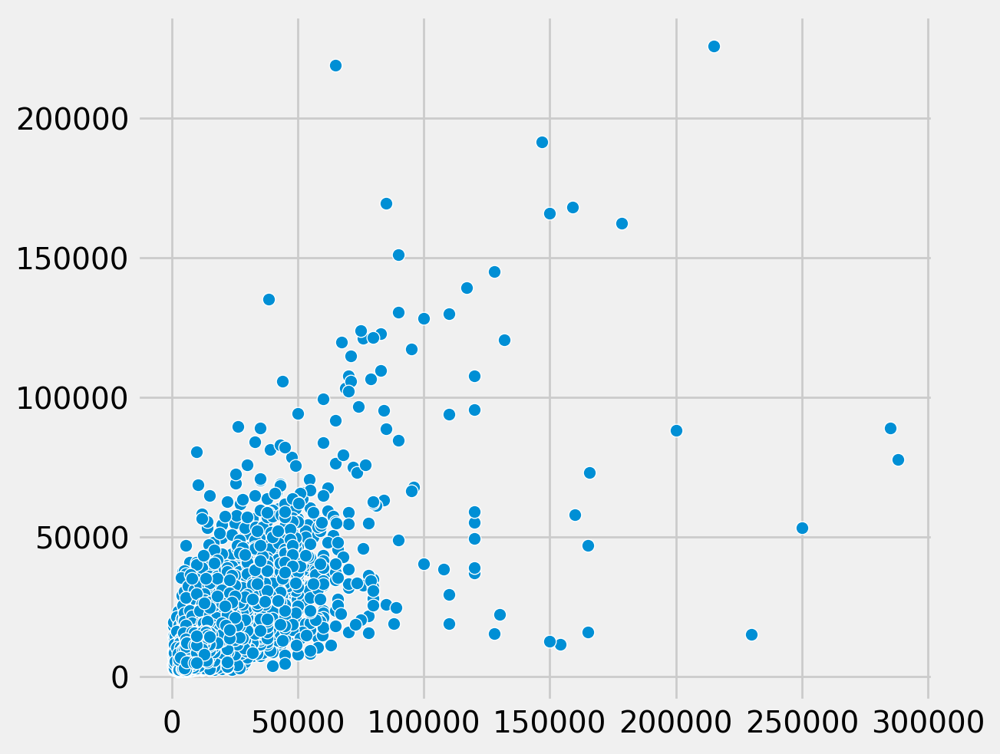

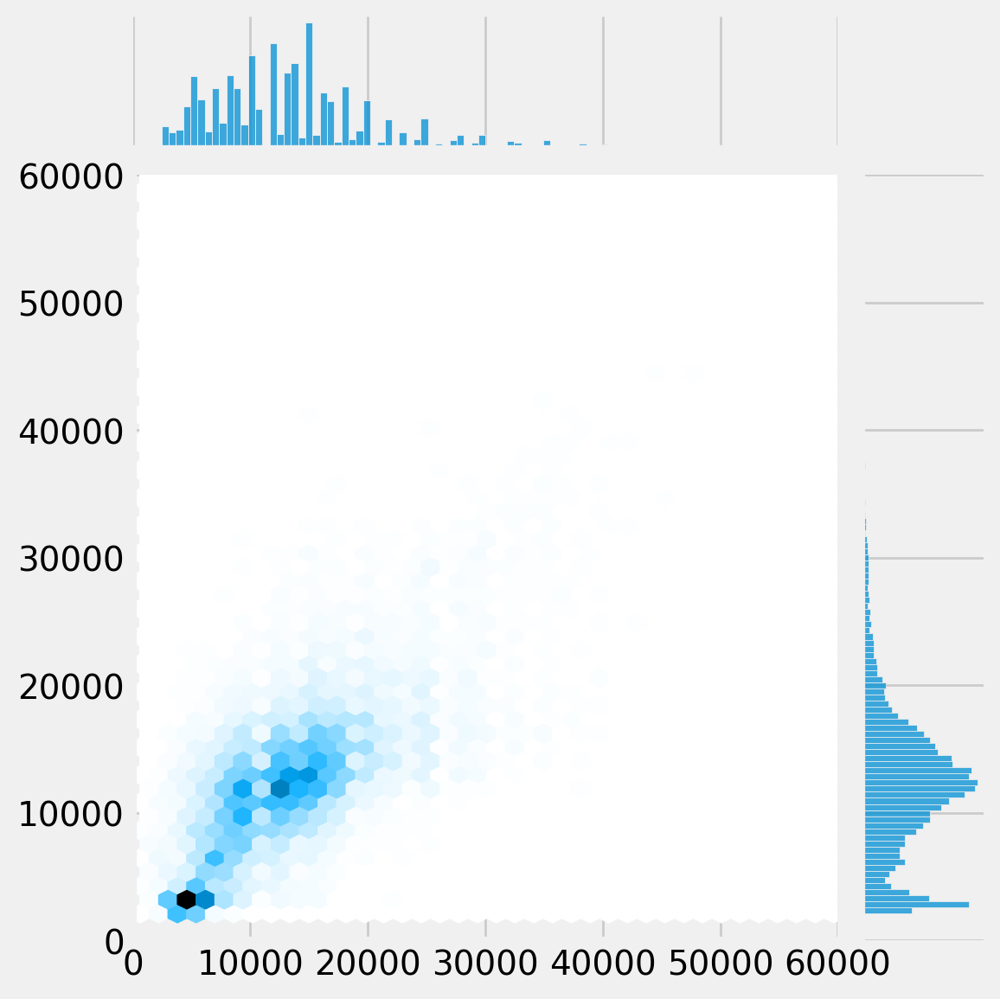

In [ ]:
test_n_plot(model,iter_dict['vld'],criterion,device) #gridsize 180
test_n_plot(model,iter_dict['vld'],criterion,device,scatter=False,gridsize=180)

8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


/usr/local/lib/python3.10/dist-packages/seaborn/axisgrid.py:1766: UserWarning: The figure layout has changed to tight
  f.tight_layout()


8606.021670899976 	r2 :  0.4417092204093933 	mape :  0.359285


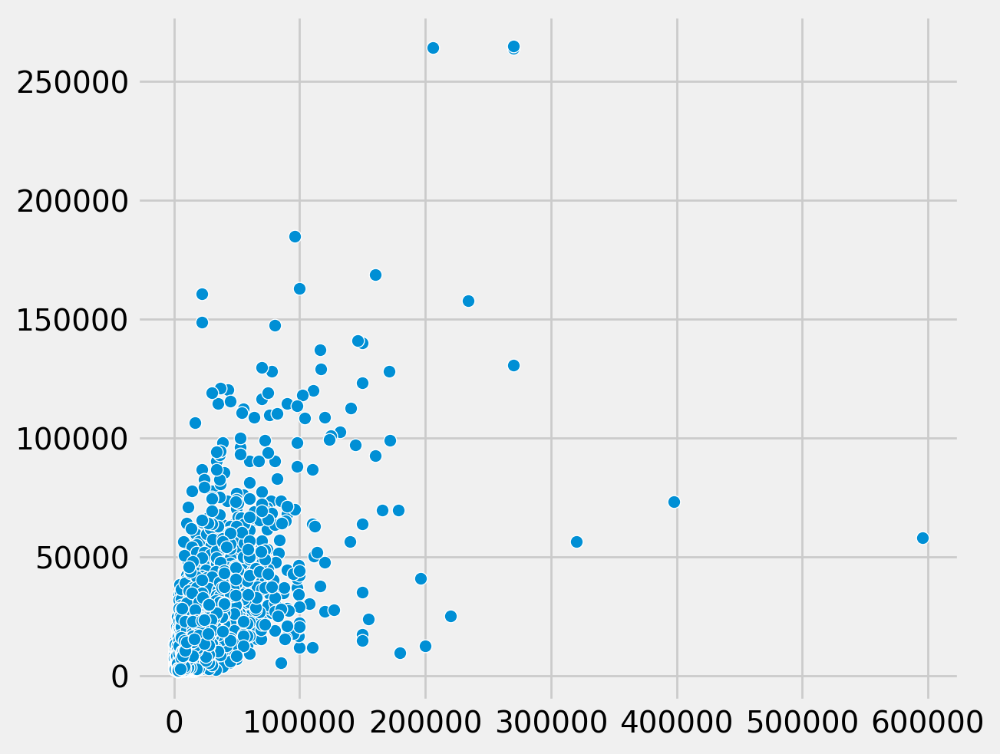

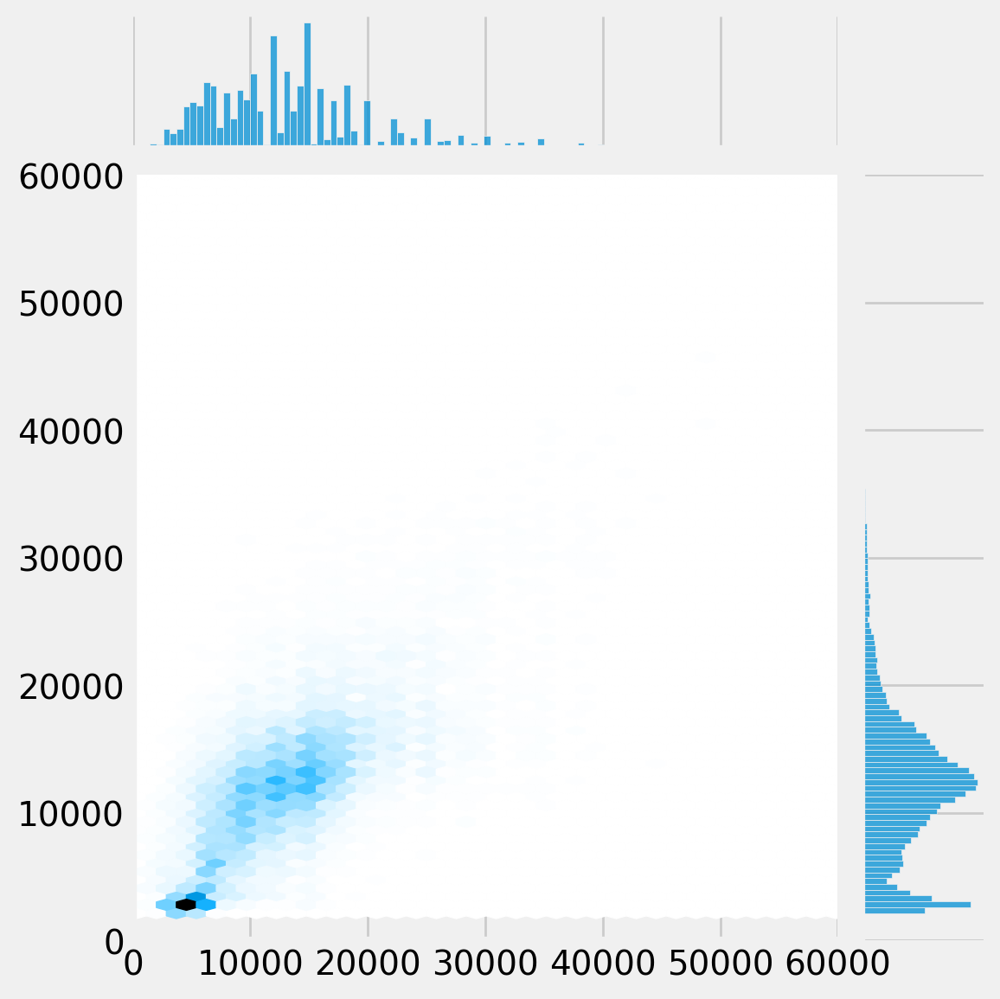

In [ ]:
test_n_plot(model,iter_dict['tst'],criterion,device) #gridsize 350
test_n_plot(model,iter_dict['tst'],criterion,device,scatter=False,gridsize=350) #gridsize 350

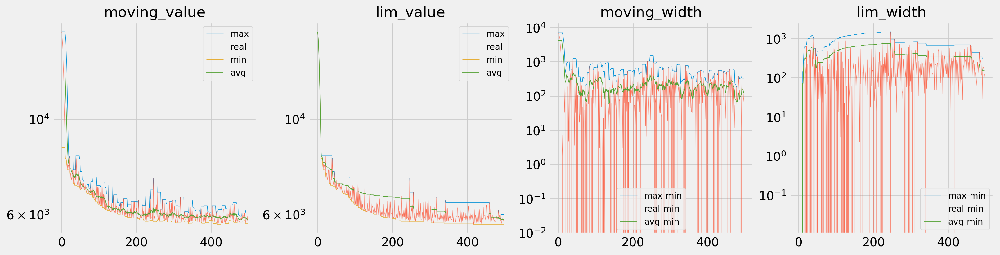

In [ ]:
x = val_loss
plot_area(x,start=0,end=-1);
#plot_area(x,start=750,end=-1,log=False);

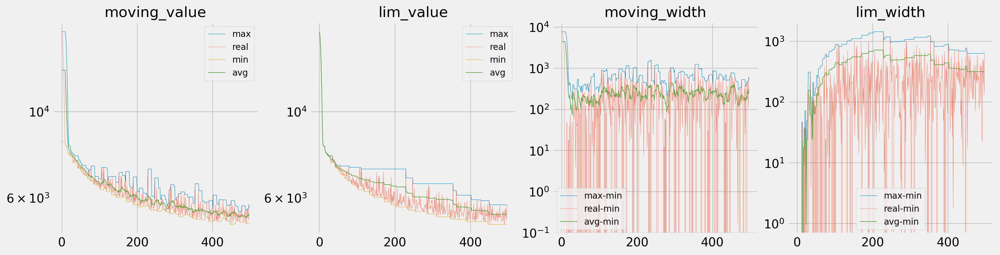

In [ ]:
x = train_loss
plot_area(x,start=0,end=-1);

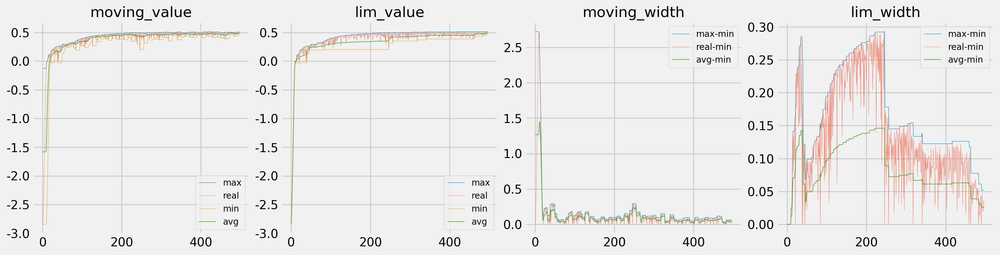

In [ ]:
x = val_score
plot_area(x,False,start=0,end=-1,log=False);